Code for **"Inpainting"** figures $6$, $8$ and 7 (top) from the main paper. 

In [1]:
"""
*Uncomment if running on colab* 
Set Runtime -> Change runtime type -> Under Hardware Accelerator select GPU in Google Colab 
"""
!git clone https://github.com/DmitryUlyanov/deep-image-prior
!mv deep-image-prior/* ./

Cloning into 'deep-image-prior'...
remote: Enumerating objects: 289, done.
remote: Total 289 (delta 0), reused 0 (delta 0), pack-reused 289
Receiving objects: 100% (289/289), 24.28 MiB | 26.34 MiB/s, done.
Resolving deltas: 100% (155/155), done.


# Import libs

In [0]:
from __future__ import print_function
import matplotlib.pyplot as plt
%matplotlib inline

import os
# os.environ['CUDA_VISIBLE_DEVICES'] = '1'

import numpy as np
from models.resnet import ResNet
from models.unet import UNet
from models.skip import skip
import torch
import torch.optim

from utils.inpainting_utils import *

torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark =True
dtype = torch.cuda.FloatTensor

PLOT = True
imsize = -1
dim_div_by = 64

# Choose figure

In [0]:
## Fig 6
# img_path  = 'data/inpainting/vase.png'
# mask_path = 'data/inpainting/vase_mask.png'

## Fig 8
# img_path  = 'data/inpainting/library.png'
# mask_path = 'data/inpainting/library_mask.png'

## Fig 7 (top)
img_path  = 'data/inpainting/kate.png'
mask_path = 'data/inpainting/kate_mask.png'

# Another text inpainting example
# img_path  = 'data/inpainting/peppers.png'
# mask_path = 'data/inpainting/peppers_mask.png'

NET_TYPE = 'skip_depth6' # one of skip_depth4|skip_depth2|UNET|ResNet

# Load mask

In [0]:
img_pil, img_np = get_image(img_path, imsize)
img_mask_pil, img_mask_np = get_image(mask_path, imsize)

### Center crop

In [0]:
img_mask_pil = crop_image(img_mask_pil, dim_div_by)
img_pil      = crop_image(img_pil,      dim_div_by)

img_np      = pil_to_np(img_pil)
img_mask_np = pil_to_np(img_mask_pil)

### Visualize

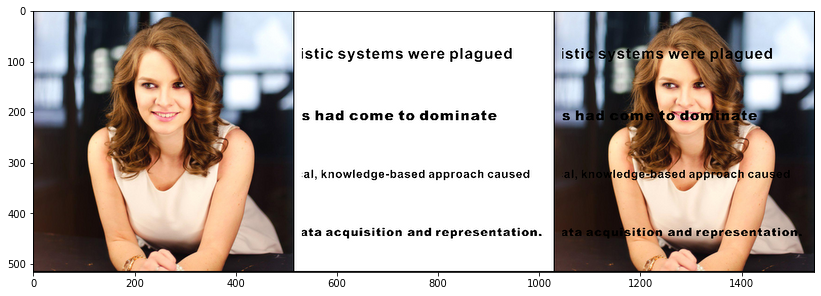

In [6]:
img_mask_var = np_to_torch(img_mask_np).type(dtype)

plot_image_grid([img_np, img_mask_np, img_mask_np*img_np], 3,11);

# Setup

In [0]:
pad = 'reflection' # 'zero'
OPT_OVER = 'net'
OPTIMIZER = 'adam'

In [0]:
if 'vase.png' in img_path:
    INPUT = 'meshgrid'
    input_depth = 2
    LR = 0.01 
    num_iter = 5001
    param_noise = False
    show_every = 50
    figsize = 5
    reg_noise_std = 0.03
    
    net = skip(input_depth, img_np.shape[0], 
               num_channels_down = [128] * 5,
               num_channels_up   = [128] * 5,
               num_channels_skip = [0] * 5,  
               upsample_mode='nearest', filter_skip_size=1, filter_size_up=3, filter_size_down=3,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
    
elif ('kate.png' in img_path) or ('peppers.png' in img_path):
    # Same params and net as in super-resolution and denoising
    INPUT = 'noise'
    input_depth = 32
    LR = 0.01 
    num_iter = 6001
    param_noise = False
    show_every = 50
    figsize = 5
    reg_noise_std = 0.03
    
    net = skip(input_depth, img_np.shape[0], 
               num_channels_down = [128] * 5,
               num_channels_up =   [128] * 5,
               num_channels_skip =    [128] * 5,  
               filter_size_up = 3, filter_size_down = 3, 
               upsample_mode='nearest', filter_skip_size=1,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
    
elif 'library.png' in img_path:
    
    INPUT = 'noise'
    input_depth = 1
    
    num_iter = 3001
    show_every = 50
    figsize = 8
    reg_noise_std = 0.00
    param_noise = True
    
    if 'skip' in NET_TYPE:
        
        depth = int(NET_TYPE[-1])
        net = skip(input_depth, img_np.shape[0], 
               num_channels_down = [16, 32, 64, 128, 128, 128][:depth],
               num_channels_up =   [16, 32, 64, 128, 128, 128][:depth],
               num_channels_skip =    [0, 0, 0, 0, 0, 0][:depth],  
               filter_size_up = 3,filter_size_down = 5,  filter_skip_size=1,
               upsample_mode='nearest', # downsample_mode='avg',
               need1x1_up=False,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
        
        LR = 0.01 
        
    elif NET_TYPE == 'UNET':
        
        net = UNet(num_input_channels=input_depth, num_output_channels=3, 
                   feature_scale=8, more_layers=1, 
                   concat_x=False, upsample_mode='deconv', 
                   pad='zero', norm_layer=torch.nn.InstanceNorm2d, need_sigmoid=True, need_bias=True)
        
        LR = 0.001
        param_noise = False
        
    elif NET_TYPE == 'ResNet':
        
        net = ResNet(input_depth, img_np.shape[0], 8, 32, need_sigmoid=True, act_fun='LeakyReLU')
        
        LR = 0.001
        param_noise = False
        
    else:
        assert False
else:
    assert False

net = net.type(dtype)
net_input = get_noise(input_depth, INPUT, img_np.shape[1:]).type(dtype)

In [9]:
# Compute number of parameters
s  = sum(np.prod(list(p.size())) for p in net.parameters())
print ('Number of params: %d' % s)

# Loss
mse = torch.nn.MSELoss().type(dtype)

img_var = np_to_torch(img_np).type(dtype)
mask_var = np_to_torch(img_mask_np).type(dtype)

Number of params: 3002627


# Main loop

Starting optimization with ADAM
Iteration 00000    Loss 0.124189

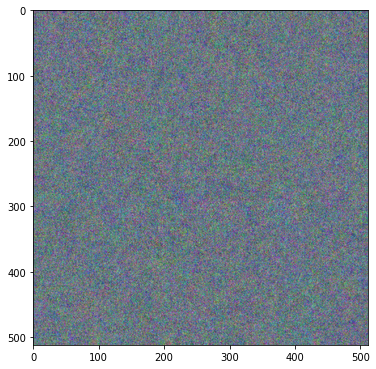

Iteration 00001    Loss 0.116385Iteration 00002    Loss 0.128282Iteration 00003    Loss 0.183347Iteration 00004    Loss 0.118405Iteration 00005    Loss 0.101223Iteration 00006    Loss 0.084988Iteration 00007    Loss 0.070112Iteration 00008    Loss 0.056403Iteration 00009    Loss 0.045342Iteration 00010    Loss 0.038004Iteration 00011    Loss 0.035366Iteration 00012    Loss 0.036254Iteration 00013    Loss 0.033060Iteration 00014    Loss 0.030614Iteration 00015    Loss 0.029180Iteration 00016    Loss 0.030000Iteration 00017    Loss 0.027180Iteration 00018    Loss 0.028131Iteration 00019    Loss 0.028510Iteration 00020    Loss 0.026357Iteration 00021    Loss 0.026106Iteration 00022    Loss 0.024576Iteration 00023    Loss 0.023861Iteration 00024    Loss 0.023124Iteration 00025    Loss 0.022357Iteration 00026    Loss 0.020859Iteration 00027    Loss 0.022225Iteration 00028    Loss 0.020989Iteration 00029    Loss 0.019926Iteration 00030    Loss 0.019491Iteration 00031    Loss 0.019731Iteratio

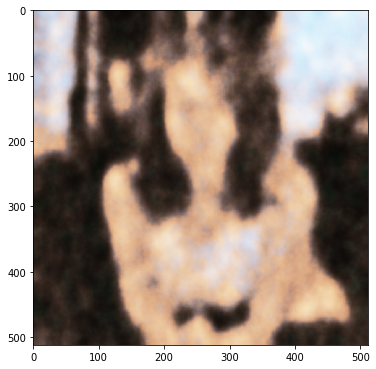

Iteration 00051    Loss 0.013414Iteration 00052    Loss 0.013081Iteration 00053    Loss 0.013532Iteration 00054    Loss 0.013020Iteration 00055    Loss 0.012440Iteration 00056    Loss 0.012737Iteration 00057    Loss 0.012899Iteration 00058    Loss 0.012299Iteration 00059    Loss 0.011949Iteration 00060    Loss 0.011453Iteration 00061    Loss 0.011616Iteration 00062    Loss 0.011000Iteration 00063    Loss 0.011410Iteration 00064    Loss 0.010759Iteration 00065    Loss 0.011262Iteration 00066    Loss 0.010573Iteration 00067    Loss 0.010617Iteration 00068    Loss 0.010112Iteration 00069    Loss 0.010114Iteration 00070    Loss 0.010395Iteration 00071    Loss 0.009770Iteration 00072    Loss 0.009545Iteration 00073    Loss 0.009087Iteration 00074    Loss 0.009609Iteration 00075    Loss 0.009537Iteration 00076    Loss 0.009508Iteration 00077    Loss 0.009187Iteration 00078    Loss 0.008685Iteration 00079    Loss 0.008722Iteration 00080    Loss 0.008372Iteration 00081    Loss 0.008456Iteratio

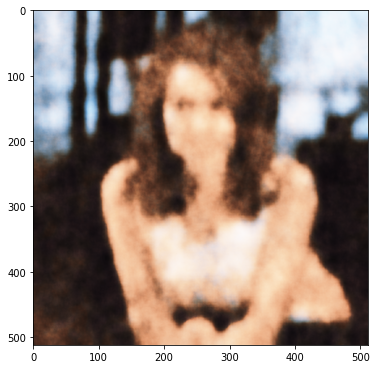

Iteration 00101    Loss 0.006260Iteration 00102    Loss 0.006262Iteration 00103    Loss 0.006770Iteration 00104    Loss 0.006911Iteration 00105    Loss 0.006449Iteration 00106    Loss 0.006336Iteration 00107    Loss 0.006249Iteration 00108    Loss 0.006297Iteration 00109    Loss 0.006426Iteration 00110    Loss 0.006230Iteration 00111    Loss 0.005994Iteration 00112    Loss 0.006119Iteration 00113    Loss 0.006251Iteration 00114    Loss 0.005735Iteration 00115    Loss 0.005969Iteration 00116    Loss 0.005508Iteration 00117    Loss 0.006172Iteration 00118    Loss 0.006065Iteration 00119    Loss 0.006073Iteration 00120    Loss 0.005776Iteration 00121    Loss 0.005853Iteration 00122    Loss 0.005373Iteration 00123    Loss 0.005526Iteration 00124    Loss 0.005418Iteration 00125    Loss 0.005532Iteration 00126    Loss 0.005330Iteration 00127    Loss 0.005927Iteration 00128    Loss 0.005461Iteration 00129    Loss 0.005171Iteration 00130    Loss 0.005416Iteration 00131    Loss 0.005207Iteratio

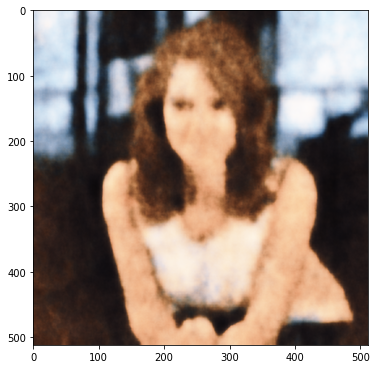

Iteration 00151    Loss 0.004666Iteration 00152    Loss 0.004482Iteration 00153    Loss 0.004544Iteration 00154    Loss 0.004518Iteration 00155    Loss 0.004443Iteration 00156    Loss 0.004683Iteration 00157    Loss 0.004395Iteration 00158    Loss 0.004117Iteration 00159    Loss 0.004482Iteration 00160    Loss 0.004233Iteration 00161    Loss 0.004218Iteration 00162    Loss 0.004161Iteration 00163    Loss 0.004309Iteration 00164    Loss 0.004020Iteration 00165    Loss 0.004064Iteration 00166    Loss 0.004214Iteration 00167    Loss 0.004063Iteration 00168    Loss 0.004146Iteration 00169    Loss 0.004175Iteration 00170    Loss 0.004162Iteration 00171    Loss 0.004161Iteration 00172    Loss 0.004275Iteration 00173    Loss 0.004006Iteration 00174    Loss 0.004118Iteration 00175    Loss 0.003992Iteration 00176    Loss 0.003901Iteration 00177    Loss 0.004320Iteration 00178    Loss 0.004194Iteration 00179    Loss 0.004098Iteration 00180    Loss 0.003835Iteration 00181    Loss 0.004020Iteratio

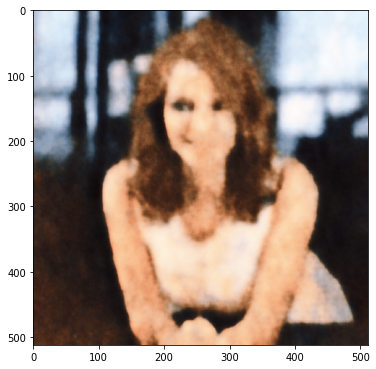

Iteration 00201    Loss 0.003644Iteration 00202    Loss 0.003554Iteration 00203    Loss 0.003361Iteration 00204    Loss 0.003639Iteration 00205    Loss 0.003410Iteration 00206    Loss 0.003424Iteration 00207    Loss 0.003456Iteration 00208    Loss 0.003517Iteration 00209    Loss 0.003474Iteration 00210    Loss 0.003501Iteration 00211    Loss 0.003305Iteration 00212    Loss 0.003394Iteration 00213    Loss 0.003228Iteration 00214    Loss 0.003383Iteration 00215    Loss 0.003213Iteration 00216    Loss 0.003194Iteration 00217    Loss 0.003351Iteration 00218    Loss 0.003394Iteration 00219    Loss 0.003235Iteration 00220    Loss 0.003407Iteration 00221    Loss 0.003161Iteration 00222    Loss 0.003075Iteration 00223    Loss 0.003181Iteration 00224    Loss 0.003071Iteration 00225    Loss 0.003224Iteration 00226    Loss 0.003153Iteration 00227    Loss 0.003059Iteration 00228    Loss 0.003018Iteration 00229    Loss 0.002981Iteration 00230    Loss 0.003029Iteration 00231    Loss 0.003142Iteratio

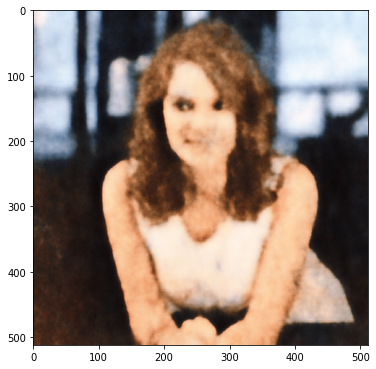

Iteration 00251    Loss 0.002692Iteration 00252    Loss 0.002740Iteration 00253    Loss 0.002753Iteration 00254    Loss 0.002670Iteration 00255    Loss 0.002903Iteration 00256    Loss 0.002752Iteration 00257    Loss 0.002639Iteration 00258    Loss 0.002779Iteration 00259    Loss 0.003126Iteration 00260    Loss 0.002624Iteration 00261    Loss 0.002845Iteration 00262    Loss 0.002658Iteration 00263    Loss 0.002649Iteration 00264    Loss 0.002636Iteration 00265    Loss 0.002908Iteration 00266    Loss 0.002731Iteration 00267    Loss 0.002871Iteration 00268    Loss 0.002787Iteration 00269    Loss 0.002599Iteration 00270    Loss 0.002623Iteration 00271    Loss 0.002563Iteration 00272    Loss 0.002530Iteration 00273    Loss 0.002465Iteration 00274    Loss 0.002585Iteration 00275    Loss 0.002569Iteration 00276    Loss 0.002503Iteration 00277    Loss 0.002492Iteration 00278    Loss 0.002504Iteration 00279    Loss 0.002505Iteration 00280    Loss 0.002443Iteration 00281    Loss 0.002473Iteratio

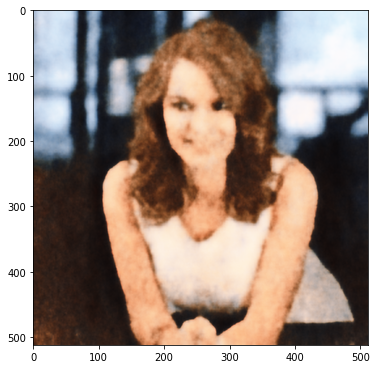

Iteration 00301    Loss 0.002381Iteration 00302    Loss 0.002318Iteration 00303    Loss 0.002236Iteration 00304    Loss 0.002435Iteration 00305    Loss 0.002173Iteration 00306    Loss 0.002254Iteration 00307    Loss 0.002418Iteration 00308    Loss 0.002309Iteration 00309    Loss 0.002262Iteration 00310    Loss 0.002330Iteration 00311    Loss 0.002162Iteration 00312    Loss 0.002242Iteration 00313    Loss 0.002126Iteration 00314    Loss 0.002154Iteration 00315    Loss 0.002458Iteration 00316    Loss 0.002208Iteration 00317    Loss 0.002151Iteration 00318    Loss 0.002112Iteration 00319    Loss 0.002100Iteration 00320    Loss 0.002082Iteration 00321    Loss 0.002146Iteration 00322    Loss 0.002062Iteration 00323    Loss 0.002267Iteration 00324    Loss 0.002063Iteration 00325    Loss 0.002278Iteration 00326    Loss 0.002063Iteration 00327    Loss 0.002095Iteration 00328    Loss 0.002177Iteration 00329    Loss 0.002040Iteration 00330    Loss 0.002055Iteration 00331    Loss 0.001971Iteratio

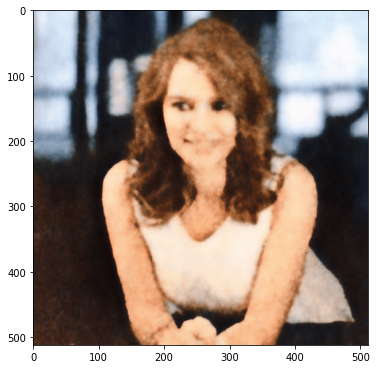

Iteration 00351    Loss 0.001984Iteration 00352    Loss 0.002085Iteration 00353    Loss 0.001909Iteration 00354    Loss 0.001993Iteration 00355    Loss 0.001977Iteration 00356    Loss 0.001969Iteration 00357    Loss 0.002063Iteration 00358    Loss 0.001930Iteration 00359    Loss 0.002217Iteration 00360    Loss 0.001906Iteration 00361    Loss 0.002014Iteration 00362    Loss 0.001922Iteration 00363    Loss 0.001979Iteration 00364    Loss 0.001964Iteration 00365    Loss 0.001806Iteration 00366    Loss 0.002036Iteration 00367    Loss 0.001852Iteration 00368    Loss 0.002008Iteration 00369    Loss 0.001882Iteration 00370    Loss 0.001905Iteration 00371    Loss 0.001904Iteration 00372    Loss 0.001882Iteration 00373    Loss 0.001884Iteration 00374    Loss 0.001785Iteration 00375    Loss 0.001840Iteration 00376    Loss 0.001880Iteration 00377    Loss 0.001856Iteration 00378    Loss 0.001813Iteration 00379    Loss 0.001851Iteration 00380    Loss 0.001803Iteration 00381    Loss 0.001782Iteratio

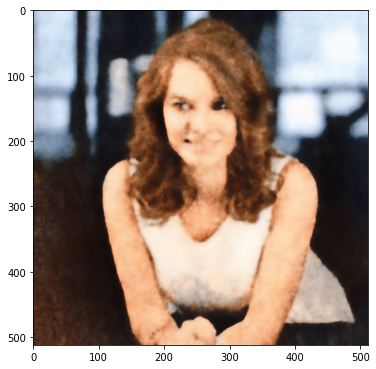

Iteration 00401    Loss 0.001689Iteration 00402    Loss 0.001705Iteration 00403    Loss 0.001706Iteration 00404    Loss 0.001731Iteration 00405    Loss 0.001711Iteration 00406    Loss 0.001590Iteration 00407    Loss 0.001772Iteration 00408    Loss 0.001709Iteration 00409    Loss 0.001644Iteration 00410    Loss 0.001664Iteration 00411    Loss 0.001664Iteration 00412    Loss 0.001655Iteration 00413    Loss 0.001630Iteration 00414    Loss 0.001664Iteration 00415    Loss 0.001644Iteration 00416    Loss 0.001593Iteration 00417    Loss 0.001638Iteration 00418    Loss 0.001657Iteration 00419    Loss 0.001651Iteration 00420    Loss 0.001648Iteration 00421    Loss 0.001586Iteration 00422    Loss 0.001622Iteration 00423    Loss 0.001660Iteration 00424    Loss 0.001631Iteration 00425    Loss 0.001578Iteration 00426    Loss 0.001565Iteration 00427    Loss 0.001560Iteration 00428    Loss 0.001545Iteration 00429    Loss 0.001528Iteration 00430    Loss 0.001592Iteration 00431    Loss 0.001556Iteratio

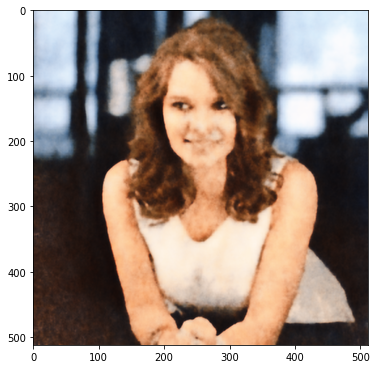

Iteration 00451    Loss 0.001504Iteration 00452    Loss 0.001596Iteration 00453    Loss 0.001528Iteration 00454    Loss 0.001500Iteration 00455    Loss 0.001584Iteration 00456    Loss 0.001476Iteration 00457    Loss 0.001513Iteration 00458    Loss 0.001512Iteration 00459    Loss 0.001449Iteration 00460    Loss 0.001504Iteration 00461    Loss 0.001475Iteration 00462    Loss 0.001464Iteration 00463    Loss 0.001512Iteration 00464    Loss 0.001494Iteration 00465    Loss 0.001465Iteration 00466    Loss 0.001490Iteration 00467    Loss 0.001463Iteration 00468    Loss 0.001429Iteration 00469    Loss 0.001480Iteration 00470    Loss 0.001467Iteration 00471    Loss 0.001386Iteration 00472    Loss 0.001449Iteration 00473    Loss 0.001403Iteration 00474    Loss 0.001433Iteration 00475    Loss 0.001425Iteration 00476    Loss 0.001419Iteration 00477    Loss 0.001446Iteration 00478    Loss 0.001465Iteration 00479    Loss 0.001325Iteration 00480    Loss 0.001418Iteration 00481    Loss 0.001421Iteratio

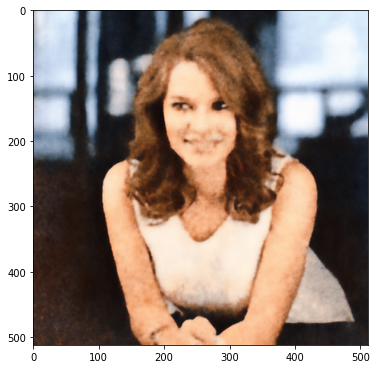

Iteration 00501    Loss 0.001352Iteration 00502    Loss 0.001379Iteration 00503    Loss 0.001323Iteration 00504    Loss 0.001301Iteration 00505    Loss 0.001319Iteration 00506    Loss 0.001312Iteration 00507    Loss 0.001315Iteration 00508    Loss 0.001298Iteration 00509    Loss 0.001332Iteration 00510    Loss 0.001327Iteration 00511    Loss 0.001282Iteration 00512    Loss 0.001357Iteration 00513    Loss 0.001315Iteration 00514    Loss 0.001368Iteration 00515    Loss 0.001304Iteration 00516    Loss 0.001358Iteration 00517    Loss 0.001364Iteration 00518    Loss 0.001309Iteration 00519    Loss 0.001366Iteration 00520    Loss 0.001369Iteration 00521    Loss 0.001324Iteration 00522    Loss 0.001330Iteration 00523    Loss 0.001318Iteration 00524    Loss 0.001284Iteration 00525    Loss 0.001297Iteration 00526    Loss 0.001283Iteration 00527    Loss 0.001324Iteration 00528    Loss 0.001318Iteration 00529    Loss 0.001220Iteration 00530    Loss 0.001265Iteration 00531    Loss 0.001281Iteratio

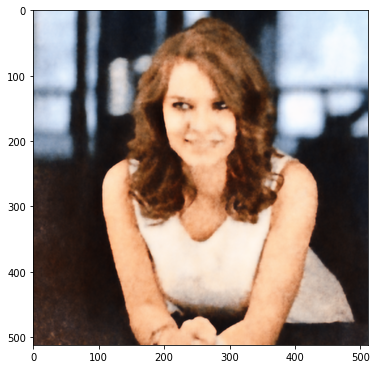

Iteration 00551    Loss 0.001263Iteration 00552    Loss 0.001349Iteration 00553    Loss 0.001204Iteration 00554    Loss 0.001297Iteration 00555    Loss 0.001238Iteration 00556    Loss 0.001321Iteration 00557    Loss 0.001219Iteration 00558    Loss 0.001282Iteration 00559    Loss 0.001207Iteration 00560    Loss 0.001267Iteration 00561    Loss 0.001160Iteration 00562    Loss 0.001222Iteration 00563    Loss 0.001206Iteration 00564    Loss 0.001178Iteration 00565    Loss 0.001174Iteration 00566    Loss 0.001221Iteration 00567    Loss 0.001253Iteration 00568    Loss 0.001149Iteration 00569    Loss 0.001144Iteration 00570    Loss 0.001139Iteration 00571    Loss 0.001235Iteration 00572    Loss 0.001174Iteration 00573    Loss 0.001137Iteration 00574    Loss 0.001182Iteration 00575    Loss 0.001194Iteration 00576    Loss 0.001149Iteration 00577    Loss 0.001207Iteration 00578    Loss 0.001139Iteration 00579    Loss 0.001209Iteration 00580    Loss 0.001134Iteration 00581    Loss 0.001172Iteratio

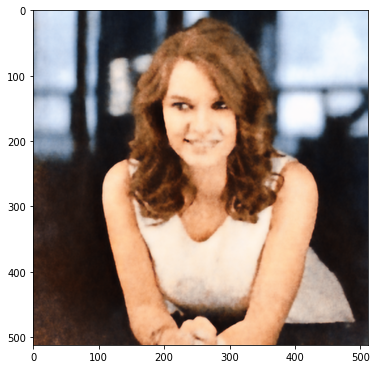

Iteration 00601    Loss 0.001155Iteration 00602    Loss 0.001091Iteration 00603    Loss 0.001092Iteration 00604    Loss 0.001121Iteration 00605    Loss 0.001069Iteration 00606    Loss 0.001081Iteration 00607    Loss 0.001131Iteration 00608    Loss 0.001133Iteration 00609    Loss 0.001139Iteration 00610    Loss 0.001138Iteration 00611    Loss 0.001174Iteration 00612    Loss 0.001095Iteration 00613    Loss 0.001137Iteration 00614    Loss 0.001070Iteration 00615    Loss 0.001109Iteration 00616    Loss 0.001111Iteration 00617    Loss 0.001142Iteration 00618    Loss 0.001069Iteration 00619    Loss 0.001190Iteration 00620    Loss 0.001060Iteration 00621    Loss 0.001188Iteration 00622    Loss 0.001137Iteration 00623    Loss 0.001221Iteration 00624    Loss 0.001158Iteration 00625    Loss 0.001127Iteration 00626    Loss 0.001054Iteration 00627    Loss 0.001126Iteration 00628    Loss 0.001078Iteration 00629    Loss 0.001111Iteration 00630    Loss 0.001038Iteration 00631    Loss 0.001069Iteratio

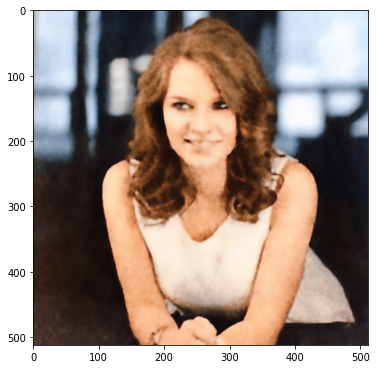

Iteration 00651    Loss 0.001034Iteration 00652    Loss 0.001016Iteration 00653    Loss 0.001064Iteration 00654    Loss 0.000986Iteration 00655    Loss 0.001037Iteration 00656    Loss 0.001001Iteration 00657    Loss 0.001004Iteration 00658    Loss 0.000976Iteration 00659    Loss 0.001022Iteration 00660    Loss 0.000987Iteration 00661    Loss 0.001010Iteration 00662    Loss 0.000993Iteration 00663    Loss 0.000999Iteration 00664    Loss 0.001012Iteration 00665    Loss 0.000987Iteration 00666    Loss 0.001035Iteration 00667    Loss 0.000985Iteration 00668    Loss 0.000974Iteration 00669    Loss 0.001007Iteration 00670    Loss 0.001007Iteration 00671    Loss 0.000999Iteration 00672    Loss 0.000964Iteration 00673    Loss 0.000970Iteration 00674    Loss 0.000986Iteration 00675    Loss 0.000981Iteration 00676    Loss 0.001018Iteration 00677    Loss 0.000964Iteration 00678    Loss 0.000981Iteration 00679    Loss 0.000980Iteration 00680    Loss 0.000989Iteration 00681    Loss 0.001015Iteratio

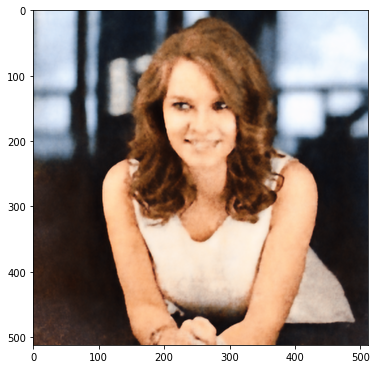

Iteration 00701    Loss 0.000936Iteration 00702    Loss 0.000966Iteration 00703    Loss 0.000960Iteration 00704    Loss 0.000999Iteration 00705    Loss 0.000961Iteration 00706    Loss 0.000939Iteration 00707    Loss 0.000977Iteration 00708    Loss 0.000923Iteration 00709    Loss 0.000931Iteration 00710    Loss 0.000920Iteration 00711    Loss 0.000966Iteration 00712    Loss 0.000961Iteration 00713    Loss 0.000936Iteration 00714    Loss 0.000982Iteration 00715    Loss 0.000942Iteration 00716    Loss 0.000949Iteration 00717    Loss 0.000952Iteration 00718    Loss 0.000893Iteration 00719    Loss 0.000922Iteration 00720    Loss 0.000936Iteration 00721    Loss 0.000935Iteration 00722    Loss 0.000910Iteration 00723    Loss 0.000889Iteration 00724    Loss 0.000951Iteration 00725    Loss 0.000919Iteration 00726    Loss 0.000901Iteration 00727    Loss 0.000896Iteration 00728    Loss 0.000934Iteration 00729    Loss 0.000883Iteration 00730    Loss 0.000911Iteration 00731    Loss 0.000950Iteratio

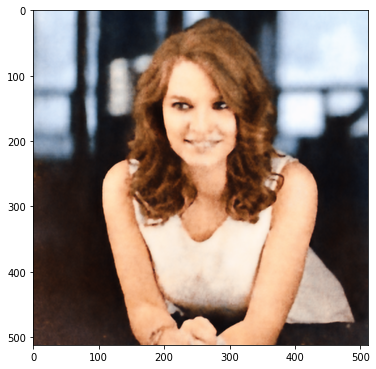

Iteration 00751    Loss 0.000901Iteration 00752    Loss 0.000971Iteration 00753    Loss 0.000908Iteration 00754    Loss 0.000942Iteration 00755    Loss 0.000935Iteration 00756    Loss 0.000905Iteration 00757    Loss 0.000914Iteration 00758    Loss 0.000901Iteration 00759    Loss 0.000896Iteration 00760    Loss 0.000876Iteration 00761    Loss 0.000921Iteration 00762    Loss 0.000914Iteration 00763    Loss 0.000885Iteration 00764    Loss 0.000877Iteration 00765    Loss 0.000856Iteration 00766    Loss 0.000871Iteration 00767    Loss 0.000889Iteration 00768    Loss 0.000850Iteration 00769    Loss 0.000871Iteration 00770    Loss 0.000880Iteration 00771    Loss 0.000871Iteration 00772    Loss 0.000843Iteration 00773    Loss 0.000898Iteration 00774    Loss 0.000846Iteration 00775    Loss 0.000901Iteration 00776    Loss 0.000870Iteration 00777    Loss 0.000854Iteration 00778    Loss 0.000858Iteration 00779    Loss 0.000864Iteration 00780    Loss 0.000870Iteration 00781    Loss 0.000838Iteratio

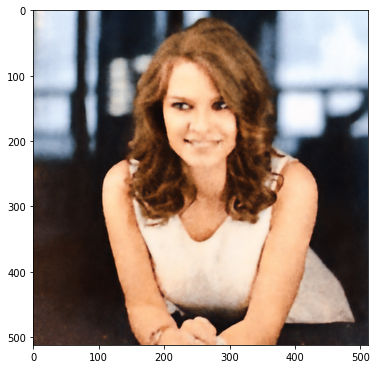

Iteration 00801    Loss 0.000951Iteration 00802    Loss 0.000820Iteration 00803    Loss 0.000901Iteration 00804    Loss 0.000866Iteration 00805    Loss 0.000843Iteration 00806    Loss 0.000894Iteration 00807    Loss 0.000843Iteration 00808    Loss 0.000910Iteration 00809    Loss 0.000828Iteration 00810    Loss 0.000885Iteration 00811    Loss 0.000848Iteration 00812    Loss 0.000899Iteration 00813    Loss 0.000864Iteration 00814    Loss 0.000855Iteration 00815    Loss 0.000957Iteration 00816    Loss 0.000834Iteration 00817    Loss 0.000844Iteration 00818    Loss 0.000822Iteration 00819    Loss 0.000845Iteration 00820    Loss 0.000817Iteration 00821    Loss 0.000783Iteration 00822    Loss 0.000846Iteration 00823    Loss 0.000787Iteration 00824    Loss 0.000810Iteration 00825    Loss 0.000821Iteration 00826    Loss 0.000820Iteration 00827    Loss 0.000788Iteration 00828    Loss 0.000863Iteration 00829    Loss 0.000823Iteration 00830    Loss 0.000828Iteration 00831    Loss 0.000801Iteratio

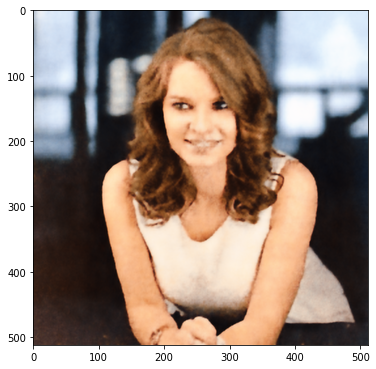

Iteration 00851    Loss 0.000779Iteration 00852    Loss 0.000800Iteration 00853    Loss 0.000781Iteration 00854    Loss 0.000781Iteration 00855    Loss 0.000780Iteration 00856    Loss 0.000786Iteration 00857    Loss 0.000751Iteration 00858    Loss 0.000764Iteration 00859    Loss 0.000765Iteration 00860    Loss 0.000756Iteration 00861    Loss 0.000755Iteration 00862    Loss 0.000781Iteration 00863    Loss 0.000757Iteration 00864    Loss 0.000778Iteration 00865    Loss 0.000741Iteration 00866    Loss 0.000773Iteration 00867    Loss 0.000766Iteration 00868    Loss 0.000768Iteration 00869    Loss 0.000781Iteration 00870    Loss 0.000734Iteration 00871    Loss 0.000761Iteration 00872    Loss 0.000765Iteration 00873    Loss 0.000739Iteration 00874    Loss 0.000761Iteration 00875    Loss 0.000743Iteration 00876    Loss 0.000757Iteration 00877    Loss 0.000796Iteration 00878    Loss 0.000765Iteration 00879    Loss 0.000760Iteration 00880    Loss 0.000756Iteration 00881    Loss 0.000734Iteratio

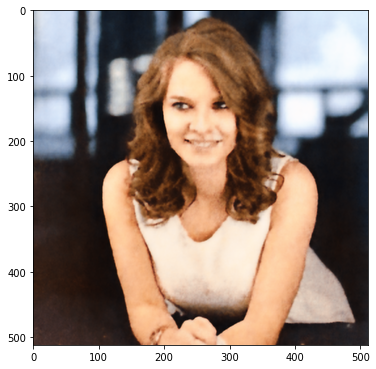

Iteration 00901    Loss 0.000752Iteration 00902    Loss 0.000756Iteration 00903    Loss 0.000725Iteration 00904    Loss 0.000727Iteration 00905    Loss 0.000711Iteration 00906    Loss 0.000722Iteration 00907    Loss 0.000749Iteration 00908    Loss 0.000716Iteration 00909    Loss 0.000746Iteration 00910    Loss 0.000730Iteration 00911    Loss 0.000723Iteration 00912    Loss 0.000701Iteration 00913    Loss 0.000734Iteration 00914    Loss 0.000722Iteration 00915    Loss 0.000724Iteration 00916    Loss 0.000715Iteration 00917    Loss 0.000705Iteration 00918    Loss 0.000706Iteration 00919    Loss 0.000728Iteration 00920    Loss 0.000729Iteration 00921    Loss 0.000728Iteration 00922    Loss 0.000755Iteration 00923    Loss 0.000758Iteration 00924    Loss 0.000724Iteration 00925    Loss 0.000810Iteration 00926    Loss 0.000705Iteration 00927    Loss 0.000772Iteration 00928    Loss 0.000828Iteration 00929    Loss 0.000716Iteration 00930    Loss 0.000814Iteration 00931    Loss 0.000733Iteratio

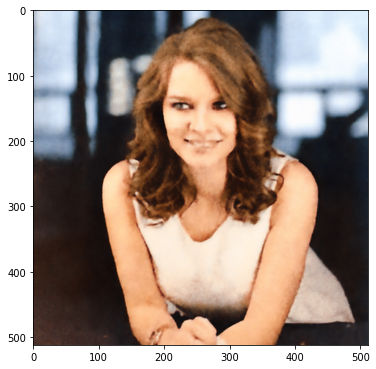

Iteration 00951    Loss 0.000716Iteration 00952    Loss 0.000711Iteration 00953    Loss 0.000746Iteration 00954    Loss 0.000690Iteration 00955    Loss 0.000692Iteration 00956    Loss 0.000711Iteration 00957    Loss 0.000695Iteration 00958    Loss 0.000758Iteration 00959    Loss 0.000687Iteration 00960    Loss 0.000750Iteration 00961    Loss 0.000706Iteration 00962    Loss 0.000730Iteration 00963    Loss 0.000791Iteration 00964    Loss 0.000706Iteration 00965    Loss 0.000688Iteration 00966    Loss 0.000699Iteration 00967    Loss 0.000672Iteration 00968    Loss 0.000722Iteration 00969    Loss 0.000721Iteration 00970    Loss 0.000675Iteration 00971    Loss 0.000686Iteration 00972    Loss 0.000689Iteration 00973    Loss 0.000719Iteration 00974    Loss 0.000687Iteration 00975    Loss 0.000716Iteration 00976    Loss 0.000760Iteration 00977    Loss 0.000675Iteration 00978    Loss 0.000724Iteration 00979    Loss 0.000704Iteration 00980    Loss 0.000670Iteration 00981    Loss 0.000706Iteratio

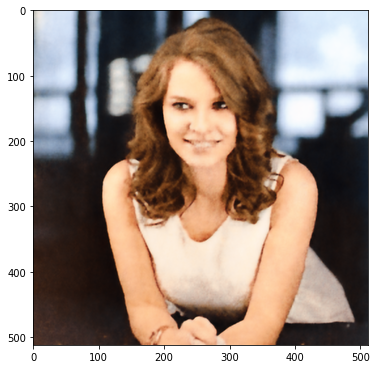

Iteration 01001    Loss 0.000650Iteration 01002    Loss 0.000668Iteration 01003    Loss 0.000676Iteration 01004    Loss 0.000649Iteration 01005    Loss 0.000683Iteration 01006    Loss 0.000668Iteration 01007    Loss 0.000677Iteration 01008    Loss 0.000679Iteration 01009    Loss 0.000669Iteration 01010    Loss 0.000665Iteration 01011    Loss 0.000659Iteration 01012    Loss 0.000654Iteration 01013    Loss 0.000655Iteration 01014    Loss 0.000661Iteration 01015    Loss 0.000645Iteration 01016    Loss 0.000673Iteration 01017    Loss 0.000643Iteration 01018    Loss 0.000652Iteration 01019    Loss 0.000667Iteration 01020    Loss 0.000650Iteration 01021    Loss 0.000662Iteration 01022    Loss 0.000641Iteration 01023    Loss 0.000651Iteration 01024    Loss 0.000639Iteration 01025    Loss 0.000634Iteration 01026    Loss 0.000650Iteration 01027    Loss 0.000629Iteration 01028    Loss 0.000636Iteration 01029    Loss 0.000637Iteration 01030    Loss 0.000627Iteration 01031    Loss 0.000634Iteratio

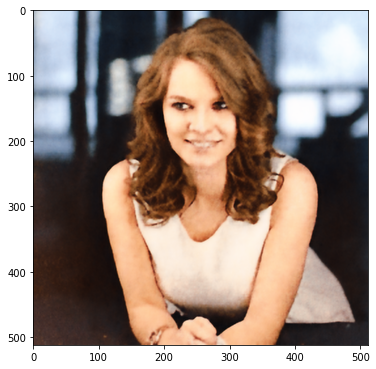

Iteration 01051    Loss 0.000679Iteration 01052    Loss 0.000662Iteration 01053    Loss 0.000650Iteration 01054    Loss 0.000651Iteration 01055    Loss 0.000682Iteration 01056    Loss 0.000614Iteration 01057    Loss 0.000638Iteration 01058    Loss 0.000632Iteration 01059    Loss 0.000632Iteration 01060    Loss 0.000652Iteration 01061    Loss 0.000597Iteration 01062    Loss 0.000633Iteration 01063    Loss 0.000614Iteration 01064    Loss 0.000638Iteration 01065    Loss 0.000639Iteration 01066    Loss 0.000625Iteration 01067    Loss 0.000629Iteration 01068    Loss 0.000616Iteration 01069    Loss 0.000607Iteration 01070    Loss 0.000598Iteration 01071    Loss 0.000628Iteration 01072    Loss 0.000618Iteration 01073    Loss 0.000614Iteration 01074    Loss 0.000619Iteration 01075    Loss 0.000633Iteration 01076    Loss 0.000601Iteration 01077    Loss 0.000622Iteration 01078    Loss 0.000609Iteration 01079    Loss 0.000627Iteration 01080    Loss 0.000615Iteration 01081    Loss 0.000605Iteratio

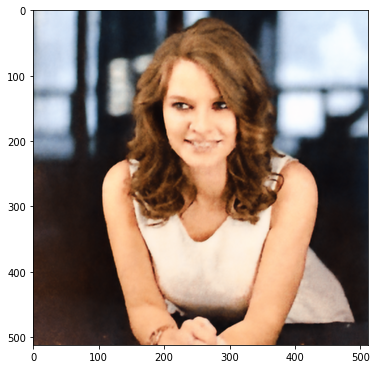

Iteration 01101    Loss 0.000598Iteration 01102    Loss 0.000596Iteration 01103    Loss 0.000590Iteration 01104    Loss 0.000596Iteration 01105    Loss 0.000607Iteration 01106    Loss 0.000581Iteration 01107    Loss 0.000621Iteration 01108    Loss 0.000611Iteration 01109    Loss 0.000609Iteration 01110    Loss 0.000616Iteration 01111    Loss 0.000598Iteration 01112    Loss 0.000572Iteration 01113    Loss 0.000596Iteration 01114    Loss 0.000591Iteration 01115    Loss 0.000575Iteration 01116    Loss 0.000576Iteration 01117    Loss 0.000592Iteration 01118    Loss 0.000577Iteration 01119    Loss 0.000591Iteration 01120    Loss 0.000600Iteration 01121    Loss 0.000556Iteration 01122    Loss 0.000603Iteration 01123    Loss 0.000607Iteration 01124    Loss 0.000565Iteration 01125    Loss 0.000605Iteration 01126    Loss 0.000649Iteration 01127    Loss 0.000599Iteration 01128    Loss 0.000575Iteration 01129    Loss 0.000587Iteration 01130    Loss 0.000592Iteration 01131    Loss 0.000587Iteratio

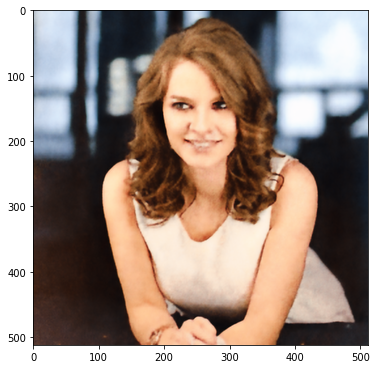

Iteration 01151    Loss 0.000589Iteration 01152    Loss 0.000562Iteration 01153    Loss 0.000573Iteration 01154    Loss 0.000569Iteration 01155    Loss 0.000572Iteration 01156    Loss 0.000554Iteration 01157    Loss 0.000575Iteration 01158    Loss 0.000569Iteration 01159    Loss 0.000558Iteration 01160    Loss 0.000558Iteration 01161    Loss 0.000584Iteration 01162    Loss 0.000559Iteration 01163    Loss 0.000563Iteration 01164    Loss 0.000560Iteration 01165    Loss 0.000556Iteration 01166    Loss 0.000577Iteration 01167    Loss 0.000552Iteration 01168    Loss 0.000561Iteration 01169    Loss 0.000560Iteration 01170    Loss 0.000558Iteration 01171    Loss 0.000567Iteration 01172    Loss 0.000578Iteration 01173    Loss 0.000560Iteration 01174    Loss 0.000585Iteration 01175    Loss 0.000583Iteration 01176    Loss 0.000560Iteration 01177    Loss 0.000623Iteration 01178    Loss 0.000636Iteration 01179    Loss 0.000569Iteration 01180    Loss 0.000573Iteration 01181    Loss 0.000594Iteratio

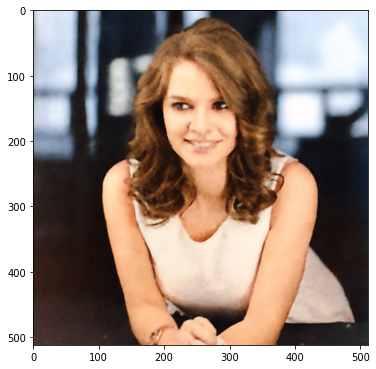

Iteration 01201    Loss 0.000541Iteration 01202    Loss 0.000556Iteration 01203    Loss 0.000564Iteration 01204    Loss 0.000567Iteration 01205    Loss 0.000560Iteration 01206    Loss 0.000560Iteration 01207    Loss 0.000533Iteration 01208    Loss 0.000568Iteration 01209    Loss 0.000538Iteration 01210    Loss 0.000540Iteration 01211    Loss 0.000558Iteration 01212    Loss 0.000593Iteration 01213    Loss 0.000562Iteration 01214    Loss 0.000562Iteration 01215    Loss 0.000577Iteration 01216    Loss 0.000555Iteration 01217    Loss 0.000539Iteration 01218    Loss 0.000562Iteration 01219    Loss 0.000535Iteration 01220    Loss 0.000542Iteration 01221    Loss 0.000548Iteration 01222    Loss 0.000529Iteration 01223    Loss 0.000547Iteration 01224    Loss 0.000533Iteration 01225    Loss 0.000539Iteration 01226    Loss 0.000536Iteration 01227    Loss 0.000539Iteration 01228    Loss 0.000527Iteration 01229    Loss 0.000543Iteration 01230    Loss 0.000553Iteration 01231    Loss 0.000541Iteratio

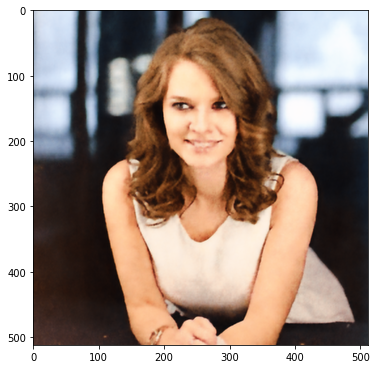

Iteration 01251    Loss 0.000526Iteration 01252    Loss 0.000533Iteration 01253    Loss 0.000517Iteration 01254    Loss 0.000521Iteration 01255    Loss 0.000521Iteration 01256    Loss 0.000522Iteration 01257    Loss 0.000526Iteration 01258    Loss 0.000539Iteration 01259    Loss 0.000514Iteration 01260    Loss 0.000552Iteration 01261    Loss 0.000547Iteration 01262    Loss 0.000521Iteration 01263    Loss 0.000541Iteration 01264    Loss 0.000535Iteration 01265    Loss 0.000511Iteration 01266    Loss 0.000528Iteration 01267    Loss 0.000532Iteration 01268    Loss 0.000525Iteration 01269    Loss 0.000559Iteration 01270    Loss 0.000541Iteration 01271    Loss 0.000526Iteration 01272    Loss 0.000528Iteration 01273    Loss 0.000567Iteration 01274    Loss 0.000538Iteration 01275    Loss 0.000519Iteration 01276    Loss 0.000544Iteration 01277    Loss 0.000531Iteration 01278    Loss 0.000530Iteration 01279    Loss 0.000552Iteration 01280    Loss 0.000548Iteration 01281    Loss 0.000517Iteratio

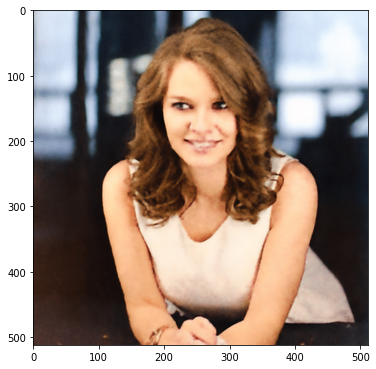

Iteration 01301    Loss 0.000548Iteration 01302    Loss 0.000504Iteration 01303    Loss 0.000524Iteration 01304    Loss 0.000522Iteration 01305    Loss 0.000516Iteration 01306    Loss 0.000531Iteration 01307    Loss 0.000507Iteration 01308    Loss 0.000511Iteration 01309    Loss 0.000530Iteration 01310    Loss 0.000502Iteration 01311    Loss 0.000511Iteration 01312    Loss 0.000514Iteration 01313    Loss 0.000507Iteration 01314    Loss 0.000515Iteration 01315    Loss 0.000529Iteration 01316    Loss 0.000503Iteration 01317    Loss 0.000556Iteration 01318    Loss 0.000542Iteration 01319    Loss 0.000494Iteration 01320    Loss 0.000562Iteration 01321    Loss 0.000564Iteration 01322    Loss 0.000501Iteration 01323    Loss 0.000545Iteration 01324    Loss 0.000550Iteration 01325    Loss 0.000514Iteration 01326    Loss 0.000532Iteration 01327    Loss 0.000506Iteration 01328    Loss 0.000528Iteration 01329    Loss 0.000585Iteration 01330    Loss 0.000531Iteration 01331    Loss 0.000516Iteratio

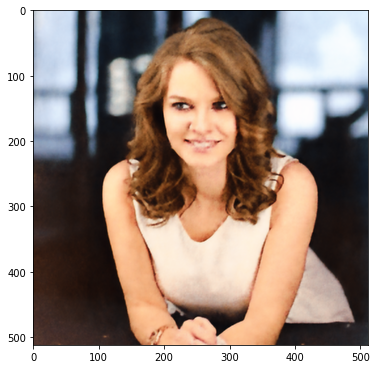

Iteration 01351    Loss 0.000504Iteration 01352    Loss 0.000538Iteration 01353    Loss 0.000580Iteration 01354    Loss 0.000529Iteration 01355    Loss 0.000492Iteration 01356    Loss 0.000536Iteration 01357    Loss 0.000487Iteration 01358    Loss 0.000517Iteration 01359    Loss 0.000513Iteration 01360    Loss 0.000504Iteration 01361    Loss 0.000539Iteration 01362    Loss 0.000484Iteration 01363    Loss 0.000515Iteration 01364    Loss 0.000532Iteration 01365    Loss 0.000475Iteration 01366    Loss 0.000509Iteration 01367    Loss 0.000491Iteration 01368    Loss 0.000491Iteration 01369    Loss 0.000496Iteration 01370    Loss 0.000496Iteration 01371    Loss 0.000515Iteration 01372    Loss 0.000510Iteration 01373    Loss 0.000542Iteration 01374    Loss 0.000492Iteration 01375    Loss 0.000553Iteration 01376    Loss 0.000546Iteration 01377    Loss 0.000511Iteration 01378    Loss 0.000585Iteration 01379    Loss 0.000509Iteration 01380    Loss 0.000507Iteration 01381    Loss 0.000551Iteratio

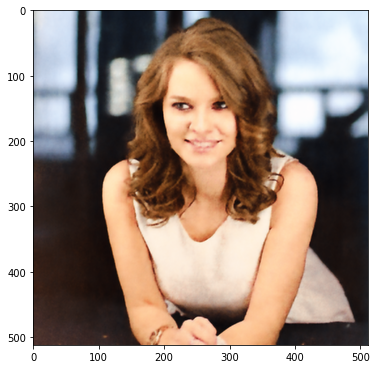

Iteration 01401    Loss 0.000521Iteration 01402    Loss 0.000494Iteration 01403    Loss 0.000493Iteration 01404    Loss 0.000483Iteration 01405    Loss 0.000471Iteration 01406    Loss 0.000479Iteration 01407    Loss 0.000471Iteration 01408    Loss 0.000482Iteration 01409    Loss 0.000490Iteration 01410    Loss 0.000475Iteration 01411    Loss 0.000501Iteration 01412    Loss 0.000500Iteration 01413    Loss 0.000467Iteration 01414    Loss 0.000494Iteration 01415    Loss 0.000489Iteration 01416    Loss 0.000474Iteration 01417    Loss 0.000512Iteration 01418    Loss 0.000469Iteration 01419    Loss 0.000495Iteration 01420    Loss 0.000479Iteration 01421    Loss 0.000465Iteration 01422    Loss 0.000488Iteration 01423    Loss 0.000465Iteration 01424    Loss 0.000487Iteration 01425    Loss 0.000486Iteration 01426    Loss 0.000466Iteration 01427    Loss 0.000473Iteration 01428    Loss 0.000462Iteration 01429    Loss 0.000476Iteration 01430    Loss 0.000458Iteration 01431    Loss 0.000454Iteratio

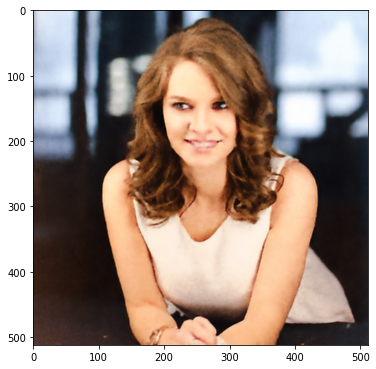

Iteration 01451    Loss 0.000464Iteration 01452    Loss 0.000463Iteration 01453    Loss 0.000460Iteration 01454    Loss 0.000449Iteration 01455    Loss 0.000450Iteration 01456    Loss 0.000454Iteration 01457    Loss 0.000458Iteration 01458    Loss 0.000463Iteration 01459    Loss 0.000444Iteration 01460    Loss 0.000467Iteration 01461    Loss 0.000450Iteration 01462    Loss 0.000452Iteration 01463    Loss 0.000458Iteration 01464    Loss 0.000460Iteration 01465    Loss 0.000465Iteration 01466    Loss 0.000460Iteration 01467    Loss 0.000465Iteration 01468    Loss 0.000460Iteration 01469    Loss 0.000449Iteration 01470    Loss 0.000460Iteration 01471    Loss 0.000455Iteration 01472    Loss 0.000445Iteration 01473    Loss 0.000453Iteration 01474    Loss 0.000463Iteration 01475    Loss 0.000466Iteration 01476    Loss 0.000449Iteration 01477    Loss 0.000470Iteration 01478    Loss 0.000479Iteration 01479    Loss 0.000448Iteration 01480    Loss 0.000478Iteration 01481    Loss 0.000481Iteratio

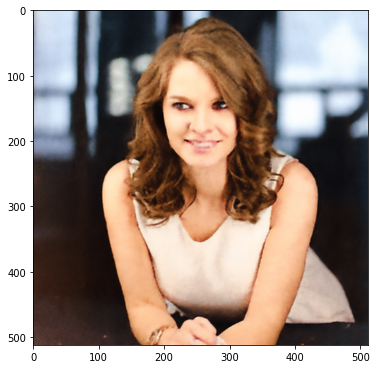

Iteration 01501    Loss 0.000453Iteration 01502    Loss 0.000441Iteration 01503    Loss 0.000439Iteration 01504    Loss 0.000478Iteration 01505    Loss 0.000437Iteration 01506    Loss 0.000448Iteration 01507    Loss 0.000465Iteration 01508    Loss 0.000444Iteration 01509    Loss 0.000438Iteration 01510    Loss 0.000460Iteration 01511    Loss 0.000448Iteration 01512    Loss 0.000455Iteration 01513    Loss 0.000446Iteration 01514    Loss 0.000435Iteration 01515    Loss 0.000444Iteration 01516    Loss 0.000449Iteration 01517    Loss 0.000438Iteration 01518    Loss 0.000429Iteration 01519    Loss 0.000447Iteration 01520    Loss 0.000425Iteration 01521    Loss 0.000448Iteration 01522    Loss 0.000456Iteration 01523    Loss 0.000431Iteration 01524    Loss 0.000442Iteration 01525    Loss 0.000447Iteration 01526    Loss 0.000441Iteration 01527    Loss 0.000427Iteration 01528    Loss 0.000434Iteration 01529    Loss 0.000447Iteration 01530    Loss 0.000428Iteration 01531    Loss 0.000433Iteratio

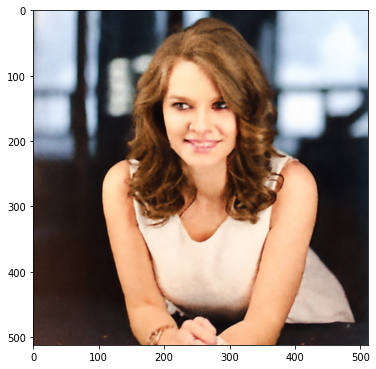

Iteration 01551    Loss 0.000425Iteration 01552    Loss 0.000420Iteration 01553    Loss 0.000423Iteration 01554    Loss 0.000432Iteration 01555    Loss 0.000430Iteration 01556    Loss 0.000408Iteration 01557    Loss 0.000420Iteration 01558    Loss 0.000416Iteration 01559    Loss 0.000438Iteration 01560    Loss 0.000433Iteration 01561    Loss 0.000405Iteration 01562    Loss 0.000412Iteration 01563    Loss 0.000424Iteration 01564    Loss 0.000424Iteration 01565    Loss 0.000422Iteration 01566    Loss 0.000438Iteration 01567    Loss 0.000490Iteration 01568    Loss 0.000493Iteration 01569    Loss 0.000427Iteration 01570    Loss 0.000447Iteration 01571    Loss 0.000465Iteration 01572    Loss 0.000427Iteration 01573    Loss 0.000435Iteration 01574    Loss 0.000484Iteration 01575    Loss 0.000436Iteration 01576    Loss 0.000439Iteration 01577    Loss 0.000458Iteration 01578    Loss 0.000422Iteration 01579    Loss 0.000449Iteration 01580    Loss 0.000437Iteration 01581    Loss 0.000420Iteratio

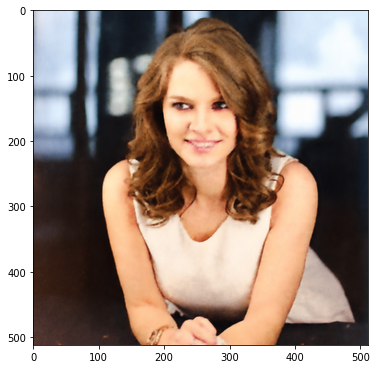

Iteration 01601    Loss 0.000411Iteration 01602    Loss 0.000418Iteration 01603    Loss 0.000407Iteration 01604    Loss 0.000411Iteration 01605    Loss 0.000433Iteration 01606    Loss 0.000434Iteration 01607    Loss 0.000397Iteration 01608    Loss 0.000419Iteration 01609    Loss 0.000422Iteration 01610    Loss 0.000398Iteration 01611    Loss 0.000421Iteration 01612    Loss 0.000451Iteration 01613    Loss 0.000428Iteration 01614    Loss 0.000410Iteration 01615    Loss 0.000430Iteration 01616    Loss 0.000441Iteration 01617    Loss 0.000411Iteration 01618    Loss 0.000408Iteration 01619    Loss 0.000445Iteration 01620    Loss 0.000408Iteration 01621    Loss 0.000419Iteration 01622    Loss 0.000429Iteration 01623    Loss 0.000428Iteration 01624    Loss 0.000429Iteration 01625    Loss 0.000420Iteration 01626    Loss 0.000425Iteration 01627    Loss 0.000401Iteration 01628    Loss 0.000431Iteration 01629    Loss 0.000485Iteration 01630    Loss 0.000430Iteration 01631    Loss 0.000415Iteratio

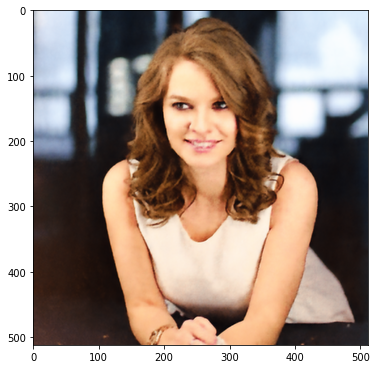

Iteration 01651    Loss 0.000402Iteration 01652    Loss 0.000388Iteration 01653    Loss 0.000402Iteration 01654    Loss 0.000406Iteration 01655    Loss 0.000384Iteration 01656    Loss 0.000414Iteration 01657    Loss 0.000416Iteration 01658    Loss 0.000396Iteration 01659    Loss 0.000411Iteration 01660    Loss 0.000431Iteration 01661    Loss 0.000397Iteration 01662    Loss 0.000389Iteration 01663    Loss 0.000420Iteration 01664    Loss 0.000396Iteration 01665    Loss 0.000393Iteration 01666    Loss 0.000408Iteration 01667    Loss 0.000398Iteration 01668    Loss 0.000395Iteration 01669    Loss 0.000400Iteration 01670    Loss 0.000403Iteration 01671    Loss 0.000389Iteration 01672    Loss 0.000390Iteration 01673    Loss 0.000406Iteration 01674    Loss 0.000384Iteration 01675    Loss 0.000397Iteration 01676    Loss 0.000388Iteration 01677    Loss 0.000402Iteration 01678    Loss 0.000395Iteration 01679    Loss 0.000390Iteration 01680    Loss 0.000397Iteration 01681    Loss 0.000392Iteratio

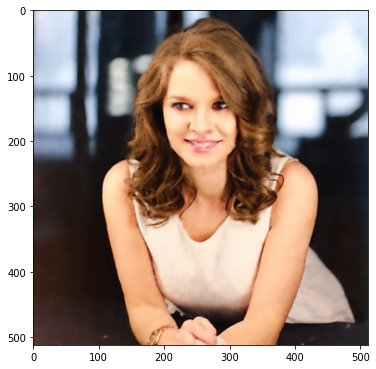

Iteration 01701    Loss 0.000400Iteration 01702    Loss 0.000405Iteration 01703    Loss 0.000386Iteration 01704    Loss 0.000380Iteration 01705    Loss 0.000382Iteration 01706    Loss 0.000391Iteration 01707    Loss 0.000382Iteration 01708    Loss 0.000384Iteration 01709    Loss 0.000391Iteration 01710    Loss 0.000389Iteration 01711    Loss 0.000372Iteration 01712    Loss 0.000385Iteration 01713    Loss 0.000379Iteration 01714    Loss 0.000377Iteration 01715    Loss 0.000396Iteration 01716    Loss 0.000399Iteration 01717    Loss 0.000407Iteration 01718    Loss 0.000388Iteration 01719    Loss 0.000387Iteration 01720    Loss 0.000371Iteration 01721    Loss 0.000385Iteration 01722    Loss 0.000390Iteration 01723    Loss 0.000410Iteration 01724    Loss 0.000390Iteration 01725    Loss 0.000376Iteration 01726    Loss 0.000399Iteration 01727    Loss 0.000415Iteration 01728    Loss 0.000389Iteration 01729    Loss 0.000415Iteration 01730    Loss 0.000442Iteration 01731    Loss 0.000405Iteratio

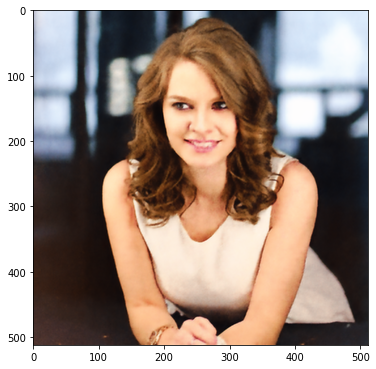

Iteration 01751    Loss 0.000415Iteration 01752    Loss 0.000394Iteration 01753    Loss 0.000395Iteration 01754    Loss 0.000380Iteration 01755    Loss 0.000370Iteration 01756    Loss 0.000395Iteration 01757    Loss 0.000398Iteration 01758    Loss 0.000368Iteration 01759    Loss 0.000374Iteration 01760    Loss 0.000393Iteration 01761    Loss 0.000362Iteration 01762    Loss 0.000391Iteration 01763    Loss 0.000417Iteration 01764    Loss 0.000382Iteration 01765    Loss 0.000364Iteration 01766    Loss 0.000407Iteration 01767    Loss 0.000403Iteration 01768    Loss 0.000381Iteration 01769    Loss 0.000382Iteration 01770    Loss 0.000373Iteration 01771    Loss 0.000380Iteration 01772    Loss 0.000399Iteration 01773    Loss 0.000378Iteration 01774    Loss 0.000375Iteration 01775    Loss 0.000378Iteration 01776    Loss 0.000370Iteration 01777    Loss 0.000375Iteration 01778    Loss 0.000383Iteration 01779    Loss 0.000380Iteration 01780    Loss 0.000378Iteration 01781    Loss 0.000370Iteratio

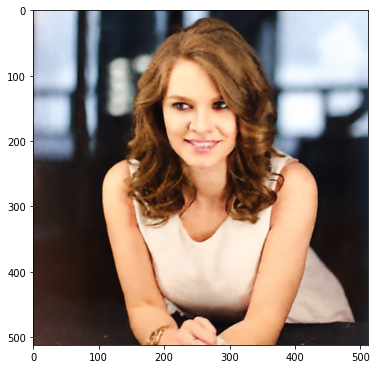

Iteration 01801    Loss 0.000372Iteration 01802    Loss 0.000382Iteration 01803    Loss 0.000376Iteration 01804    Loss 0.000366Iteration 01805    Loss 0.000353Iteration 01806    Loss 0.000365Iteration 01807    Loss 0.000372Iteration 01808    Loss 0.000372Iteration 01809    Loss 0.000357Iteration 01810    Loss 0.000360Iteration 01811    Loss 0.000372Iteration 01812    Loss 0.000384Iteration 01813    Loss 0.000377Iteration 01814    Loss 0.000357Iteration 01815    Loss 0.000369Iteration 01816    Loss 0.000366Iteration 01817    Loss 0.000360Iteration 01818    Loss 0.000359Iteration 01819    Loss 0.000374Iteration 01820    Loss 0.000369Iteration 01821    Loss 0.000368Iteration 01822    Loss 0.000387Iteration 01823    Loss 0.000386Iteration 01824    Loss 0.000366Iteration 01825    Loss 0.000375Iteration 01826    Loss 0.000359Iteration 01827    Loss 0.000361Iteration 01828    Loss 0.000377Iteration 01829    Loss 0.000388Iteration 01830    Loss 0.000382Iteration 01831    Loss 0.000366Iteratio

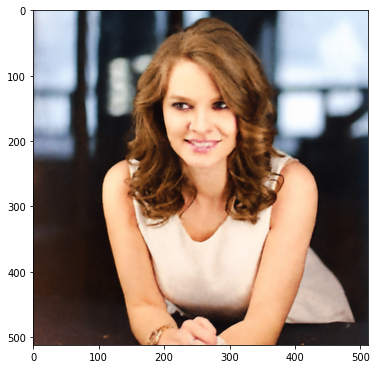

Iteration 01851    Loss 0.000409Iteration 01852    Loss 0.000374Iteration 01853    Loss 0.000362Iteration 01854    Loss 0.000408Iteration 01855    Loss 0.000392Iteration 01856    Loss 0.000363Iteration 01857    Loss 0.000365Iteration 01858    Loss 0.000394Iteration 01859    Loss 0.000374Iteration 01860    Loss 0.000367Iteration 01861    Loss 0.000411Iteration 01862    Loss 0.000430Iteration 01863    Loss 0.000379Iteration 01864    Loss 0.000356Iteration 01865    Loss 0.000396Iteration 01866    Loss 0.000403Iteration 01867    Loss 0.000355Iteration 01868    Loss 0.000373Iteration 01869    Loss 0.000376Iteration 01870    Loss 0.000342Iteration 01871    Loss 0.000372Iteration 01872    Loss 0.000394Iteration 01873    Loss 0.000365Iteration 01874    Loss 0.000364Iteration 01875    Loss 0.000397Iteration 01876    Loss 0.000361Iteration 01877    Loss 0.000347Iteration 01878    Loss 0.000370Iteration 01879    Loss 0.000349Iteration 01880    Loss 0.000372Iteration 01881    Loss 0.000382Iteratio

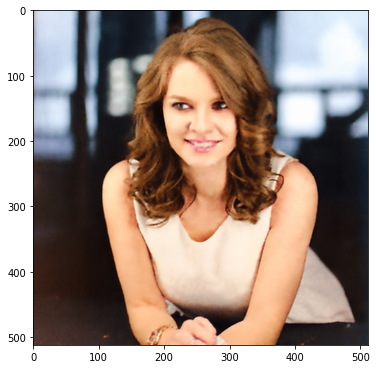

Iteration 01901    Loss 0.000373Iteration 01902    Loss 0.000393Iteration 01903    Loss 0.000368Iteration 01904    Loss 0.000345Iteration 01905    Loss 0.000353Iteration 01906    Loss 0.000379Iteration 01907    Loss 0.000381Iteration 01908    Loss 0.000343Iteration 01909    Loss 0.000358Iteration 01910    Loss 0.000383Iteration 01911    Loss 0.000379Iteration 01912    Loss 0.000371Iteration 01913    Loss 0.000377Iteration 01914    Loss 0.000388Iteration 01915    Loss 0.000375Iteration 01916    Loss 0.000394Iteration 01917    Loss 0.000405Iteration 01918    Loss 0.000375Iteration 01919    Loss 0.000353Iteration 01920    Loss 0.000393Iteration 01921    Loss 0.000359Iteration 01922    Loss 0.000346Iteration 01923    Loss 0.000371Iteration 01924    Loss 0.000372Iteration 01925    Loss 0.000342Iteration 01926    Loss 0.000352Iteration 01927    Loss 0.000368Iteration 01928    Loss 0.000347Iteration 01929    Loss 0.000338Iteration 01930    Loss 0.000378Iteration 01931    Loss 0.000376Iteratio

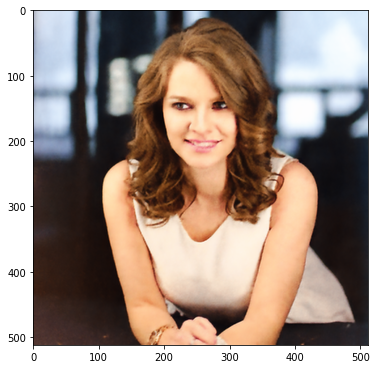

Iteration 01951    Loss 0.000341Iteration 01952    Loss 0.000355Iteration 01953    Loss 0.000380Iteration 01954    Loss 0.000355Iteration 01955    Loss 0.000346Iteration 01956    Loss 0.000386Iteration 01957    Loss 0.000350Iteration 01958    Loss 0.000340Iteration 01959    Loss 0.000369Iteration 01960    Loss 0.000391Iteration 01961    Loss 0.000362Iteration 01962    Loss 0.000359Iteration 01963    Loss 0.000363Iteration 01964    Loss 0.000353Iteration 01965    Loss 0.000335Iteration 01966    Loss 0.000342Iteration 01967    Loss 0.000347Iteration 01968    Loss 0.000327Iteration 01969    Loss 0.000355Iteration 01970    Loss 0.000362Iteration 01971    Loss 0.000341Iteration 01972    Loss 0.000335Iteration 01973    Loss 0.000342Iteration 01974    Loss 0.000345Iteration 01975    Loss 0.000326Iteration 01976    Loss 0.000349Iteration 01977    Loss 0.000344Iteration 01978    Loss 0.000338Iteration 01979    Loss 0.000336Iteration 01980    Loss 0.000346Iteration 01981    Loss 0.000335Iteratio

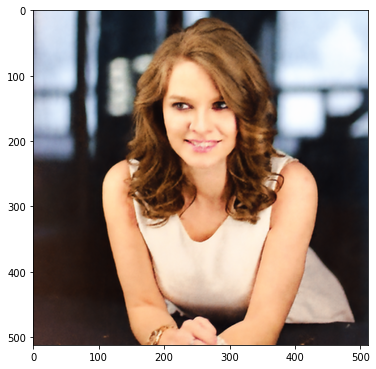

Iteration 02001    Loss 0.000337Iteration 02002    Loss 0.000336Iteration 02003    Loss 0.000324Iteration 02004    Loss 0.000338Iteration 02005    Loss 0.000335Iteration 02006    Loss 0.000326Iteration 02007    Loss 0.000323Iteration 02008    Loss 0.000330Iteration 02009    Loss 0.000325Iteration 02010    Loss 0.000330Iteration 02011    Loss 0.000336Iteration 02012    Loss 0.000329Iteration 02013    Loss 0.000330Iteration 02014    Loss 0.000345Iteration 02015    Loss 0.000333Iteration 02016    Loss 0.000325Iteration 02017    Loss 0.000358Iteration 02018    Loss 0.000366Iteration 02019    Loss 0.000337Iteration 02020    Loss 0.000338Iteration 02021    Loss 0.000355Iteration 02022    Loss 0.000333Iteration 02023    Loss 0.000329Iteration 02024    Loss 0.000331Iteration 02025    Loss 0.000336Iteration 02026    Loss 0.000326Iteration 02027    Loss 0.000344Iteration 02028    Loss 0.000364Iteration 02029    Loss 0.000350Iteration 02030    Loss 0.000334Iteration 02031    Loss 0.000351Iteratio

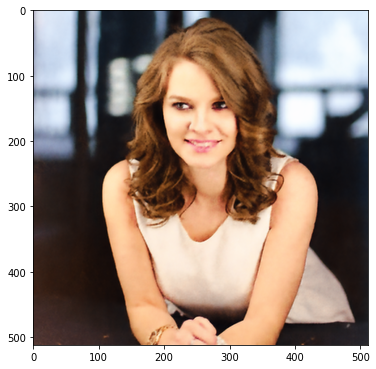

Iteration 02051    Loss 0.000323Iteration 02052    Loss 0.000327Iteration 02053    Loss 0.000330Iteration 02054    Loss 0.000327Iteration 02055    Loss 0.000333Iteration 02056    Loss 0.000356Iteration 02057    Loss 0.000389Iteration 02058    Loss 0.000360Iteration 02059    Loss 0.000316Iteration 02060    Loss 0.000367Iteration 02061    Loss 0.000367Iteration 02062    Loss 0.000343Iteration 02063    Loss 0.000321Iteration 02064    Loss 0.000360Iteration 02065    Loss 0.000381Iteration 02066    Loss 0.000335Iteration 02067    Loss 0.000323Iteration 02068    Loss 0.000354Iteration 02069    Loss 0.000349Iteration 02070    Loss 0.000329Iteration 02071    Loss 0.000333Iteration 02072    Loss 0.000337Iteration 02073    Loss 0.000325Iteration 02074    Loss 0.000326Iteration 02075    Loss 0.000341Iteration 02076    Loss 0.000338Iteration 02077    Loss 0.000317Iteration 02078    Loss 0.000309Iteration 02079    Loss 0.000321Iteration 02080    Loss 0.000312Iteration 02081    Loss 0.000317Iteratio

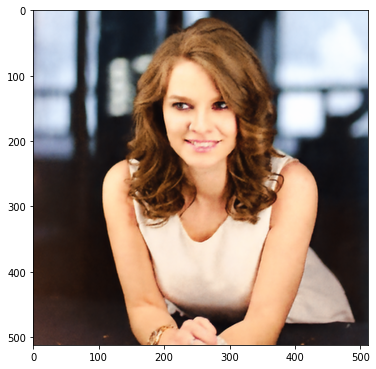

Iteration 02101    Loss 0.000324Iteration 02102    Loss 0.000310Iteration 02103    Loss 0.000330Iteration 02104    Loss 0.000324Iteration 02105    Loss 0.000323Iteration 02106    Loss 0.000308Iteration 02107    Loss 0.000327Iteration 02108    Loss 0.000329Iteration 02109    Loss 0.000316Iteration 02110    Loss 0.000315Iteration 02111    Loss 0.000321Iteration 02112    Loss 0.000322Iteration 02113    Loss 0.000325Iteration 02114    Loss 0.000341Iteration 02115    Loss 0.000342Iteration 02116    Loss 0.000324Iteration 02117    Loss 0.000326Iteration 02118    Loss 0.000349Iteration 02119    Loss 0.000350Iteration 02120    Loss 0.000318Iteration 02121    Loss 0.000316Iteration 02122    Loss 0.000321Iteration 02123    Loss 0.000313Iteration 02124    Loss 0.000318Iteration 02125    Loss 0.000339Iteration 02126    Loss 0.000321Iteration 02127    Loss 0.000304Iteration 02128    Loss 0.000316Iteration 02129    Loss 0.000329Iteration 02130    Loss 0.000334Iteration 02131    Loss 0.000332Iteratio

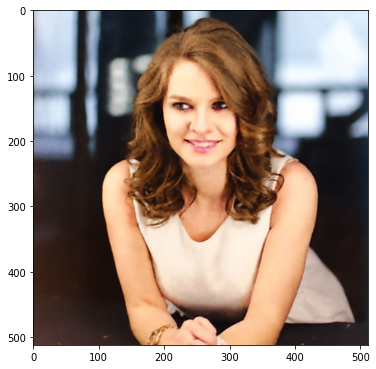

Iteration 02151    Loss 0.000342Iteration 02152    Loss 0.000313Iteration 02153    Loss 0.000343Iteration 02154    Loss 0.000323Iteration 02155    Loss 0.000303Iteration 02156    Loss 0.000331Iteration 02157    Loss 0.000309Iteration 02158    Loss 0.000304Iteration 02159    Loss 0.000315Iteration 02160    Loss 0.000309Iteration 02161    Loss 0.000309Iteration 02162    Loss 0.000307Iteration 02163    Loss 0.000304Iteration 02164    Loss 0.000300Iteration 02165    Loss 0.000307Iteration 02166    Loss 0.000319Iteration 02167    Loss 0.000320Iteration 02168    Loss 0.000312Iteration 02169    Loss 0.000301Iteration 02170    Loss 0.000312Iteration 02171    Loss 0.000309Iteration 02172    Loss 0.000299Iteration 02173    Loss 0.000303Iteration 02174    Loss 0.000316Iteration 02175    Loss 0.000305Iteration 02176    Loss 0.000304Iteration 02177    Loss 0.000319Iteration 02178    Loss 0.000317Iteration 02179    Loss 0.000317Iteration 02180    Loss 0.000315Iteration 02181    Loss 0.000308Iteratio

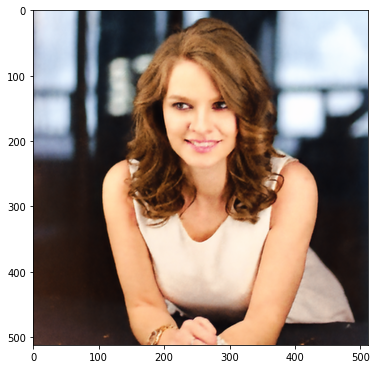

Iteration 02201    Loss 0.000308Iteration 02202    Loss 0.000302Iteration 02203    Loss 0.000303Iteration 02204    Loss 0.000324Iteration 02205    Loss 0.000314Iteration 02206    Loss 0.000292Iteration 02207    Loss 0.000315Iteration 02208    Loss 0.000328Iteration 02209    Loss 0.000319Iteration 02210    Loss 0.000313Iteration 02211    Loss 0.000300Iteration 02212    Loss 0.000311Iteration 02213    Loss 0.000311Iteration 02214    Loss 0.000327Iteration 02215    Loss 0.000300Iteration 02216    Loss 0.000288Iteration 02217    Loss 0.000316Iteration 02218    Loss 0.000326Iteration 02219    Loss 0.000313Iteration 02220    Loss 0.000309Iteration 02221    Loss 0.000296Iteration 02222    Loss 0.000299Iteration 02223    Loss 0.000296Iteration 02224    Loss 0.000311Iteration 02225    Loss 0.000306Iteration 02226    Loss 0.000297Iteration 02227    Loss 0.000295Iteration 02228    Loss 0.000296Iteration 02229    Loss 0.000301Iteration 02230    Loss 0.000285Iteration 02231    Loss 0.000294Iteratio

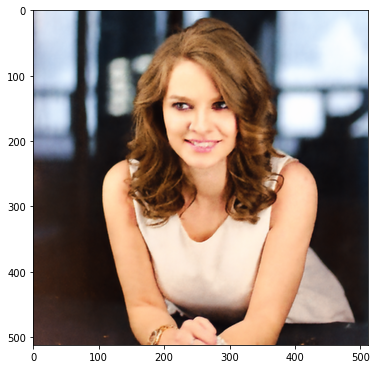

Iteration 02251    Loss 0.000290Iteration 02252    Loss 0.000290Iteration 02253    Loss 0.000296Iteration 02254    Loss 0.000299Iteration 02255    Loss 0.000300Iteration 02256    Loss 0.000301Iteration 02257    Loss 0.000310Iteration 02258    Loss 0.000296Iteration 02259    Loss 0.000314Iteration 02260    Loss 0.000324Iteration 02261    Loss 0.000297Iteration 02262    Loss 0.000295Iteration 02263    Loss 0.000296Iteration 02264    Loss 0.000304Iteration 02265    Loss 0.000286Iteration 02266    Loss 0.000290Iteration 02267    Loss 0.000304Iteration 02268    Loss 0.000300Iteration 02269    Loss 0.000283Iteration 02270    Loss 0.000282Iteration 02271    Loss 0.000313Iteration 02272    Loss 0.000305Iteration 02273    Loss 0.000287Iteration 02274    Loss 0.000290Iteration 02275    Loss 0.000297Iteration 02276    Loss 0.000289Iteration 02277    Loss 0.000286Iteration 02278    Loss 0.000297Iteration 02279    Loss 0.000302Iteration 02280    Loss 0.000311Iteration 02281    Loss 0.000295Iteratio

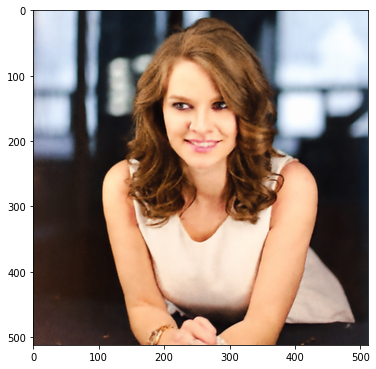

Iteration 02301    Loss 0.000338Iteration 02302    Loss 0.000360Iteration 02303    Loss 0.000314Iteration 02304    Loss 0.000309Iteration 02305    Loss 0.000341Iteration 02306    Loss 0.000377Iteration 02307    Loss 0.000430Iteration 02308    Loss 0.000382Iteration 02309    Loss 0.000329Iteration 02310    Loss 0.000333Iteration 02311    Loss 0.000346Iteration 02312    Loss 0.000308Iteration 02313    Loss 0.000330Iteration 02314    Loss 0.000358Iteration 02315    Loss 0.000323Iteration 02316    Loss 0.000302Iteration 02317    Loss 0.000350Iteration 02318    Loss 0.000294Iteration 02319    Loss 0.000302Iteration 02320    Loss 0.000326Iteration 02321    Loss 0.000298Iteration 02322    Loss 0.000309Iteration 02323    Loss 0.000313Iteration 02324    Loss 0.000293Iteration 02325    Loss 0.000298Iteration 02326    Loss 0.000313Iteration 02327    Loss 0.000285Iteration 02328    Loss 0.000296Iteration 02329    Loss 0.000296Iteration 02330    Loss 0.000288Iteration 02331    Loss 0.000307Iteratio

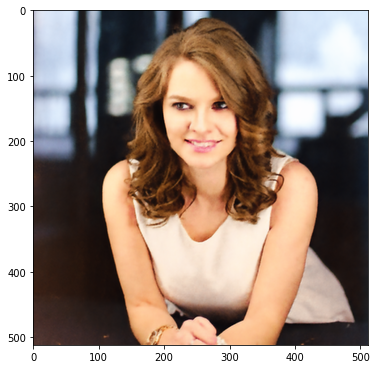

Iteration 02351    Loss 0.000276Iteration 02352    Loss 0.000280Iteration 02353    Loss 0.000297Iteration 02354    Loss 0.000296Iteration 02355    Loss 0.000294Iteration 02356    Loss 0.000280Iteration 02357    Loss 0.000282Iteration 02358    Loss 0.000299Iteration 02359    Loss 0.000288Iteration 02360    Loss 0.000280Iteration 02361    Loss 0.000287Iteration 02362    Loss 0.000303Iteration 02363    Loss 0.000307Iteration 02364    Loss 0.000298Iteration 02365    Loss 0.000281Iteration 02366    Loss 0.000282Iteration 02367    Loss 0.000275Iteration 02368    Loss 0.000284Iteration 02369    Loss 0.000277Iteration 02370    Loss 0.000272Iteration 02371    Loss 0.000275Iteration 02372    Loss 0.000286Iteration 02373    Loss 0.000285Iteration 02374    Loss 0.000278Iteration 02375    Loss 0.000278Iteration 02376    Loss 0.000273Iteration 02377    Loss 0.000281Iteration 02378    Loss 0.000280Iteration 02379    Loss 0.000266Iteration 02380    Loss 0.000283Iteration 02381    Loss 0.000273Iteratio

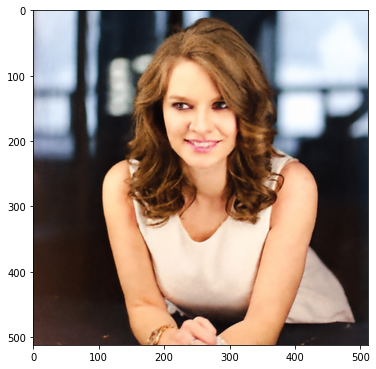

Iteration 02401    Loss 0.000284Iteration 02402    Loss 0.000286Iteration 02403    Loss 0.000269Iteration 02404    Loss 0.000276Iteration 02405    Loss 0.000301Iteration 02406    Loss 0.000301Iteration 02407    Loss 0.000277Iteration 02408    Loss 0.000272Iteration 02409    Loss 0.000278Iteration 02410    Loss 0.000280Iteration 02411    Loss 0.000273Iteration 02412    Loss 0.000289Iteration 02413    Loss 0.000284Iteration 02414    Loss 0.000277Iteration 02415    Loss 0.000283Iteration 02416    Loss 0.000297Iteration 02417    Loss 0.000290Iteration 02418    Loss 0.000281Iteration 02419    Loss 0.000275Iteration 02420    Loss 0.000284Iteration 02421    Loss 0.000288Iteration 02422    Loss 0.000276Iteration 02423    Loss 0.000275Iteration 02424    Loss 0.000276Iteration 02425    Loss 0.000285Iteration 02426    Loss 0.000283Iteration 02427    Loss 0.000279Iteration 02428    Loss 0.000271Iteration 02429    Loss 0.000294Iteration 02430    Loss 0.000293Iteration 02431    Loss 0.000280Iteratio

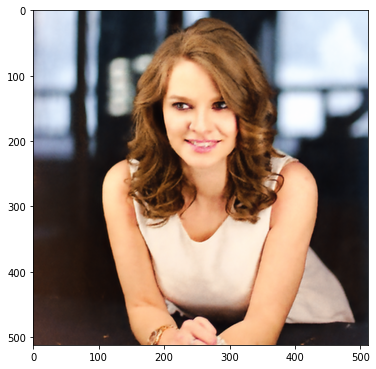

Iteration 02451    Loss 0.000306Iteration 02452    Loss 0.000292Iteration 02453    Loss 0.000274Iteration 02454    Loss 0.000276Iteration 02455    Loss 0.000304Iteration 02456    Loss 0.000318Iteration 02457    Loss 0.000288Iteration 02458    Loss 0.000281Iteration 02459    Loss 0.000293Iteration 02460    Loss 0.000293Iteration 02461    Loss 0.000275Iteration 02462    Loss 0.000274Iteration 02463    Loss 0.000282Iteration 02464    Loss 0.000281Iteration 02465    Loss 0.000268Iteration 02466    Loss 0.000274Iteration 02467    Loss 0.000273Iteration 02468    Loss 0.000273Iteration 02469    Loss 0.000267Iteration 02470    Loss 0.000275Iteration 02471    Loss 0.000265Iteration 02472    Loss 0.000271Iteration 02473    Loss 0.000264Iteration 02474    Loss 0.000266Iteration 02475    Loss 0.000268Iteration 02476    Loss 0.000269Iteration 02477    Loss 0.000275Iteration 02478    Loss 0.000274Iteration 02479    Loss 0.000262Iteration 02480    Loss 0.000273Iteration 02481    Loss 0.000271Iteratio

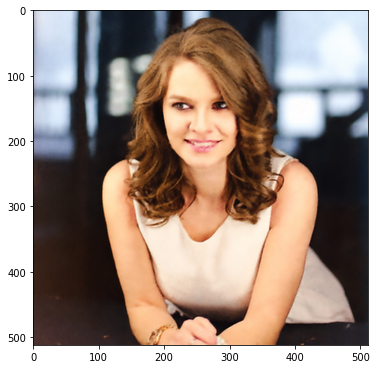

Iteration 02501    Loss 0.000258Iteration 02502    Loss 0.000257Iteration 02503    Loss 0.000263Iteration 02504    Loss 0.000256Iteration 02505    Loss 0.000269Iteration 02506    Loss 0.000264Iteration 02507    Loss 0.000261Iteration 02508    Loss 0.000259Iteration 02509    Loss 0.000257Iteration 02510    Loss 0.000258Iteration 02511    Loss 0.000266Iteration 02512    Loss 0.000265Iteration 02513    Loss 0.000274Iteration 02514    Loss 0.000276Iteration 02515    Loss 0.000278Iteration 02516    Loss 0.000268Iteration 02517    Loss 0.000264Iteration 02518    Loss 0.000263Iteration 02519    Loss 0.000280Iteration 02520    Loss 0.000287Iteration 02521    Loss 0.000279Iteration 02522    Loss 0.000274Iteration 02523    Loss 0.000279Iteration 02524    Loss 0.000297Iteration 02525    Loss 0.000327Iteration 02526    Loss 0.000331Iteration 02527    Loss 0.000300Iteration 02528    Loss 0.000268Iteration 02529    Loss 0.000259Iteration 02530    Loss 0.000266Iteration 02531    Loss 0.000267Iteratio

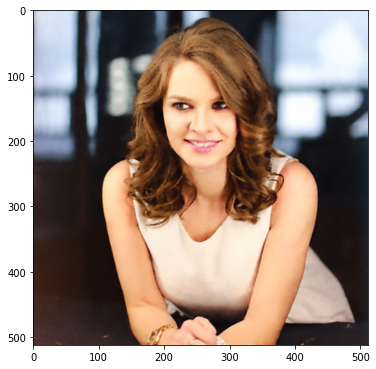

Iteration 02551    Loss 0.000268Iteration 02552    Loss 0.000263Iteration 02553    Loss 0.000266Iteration 02554    Loss 0.000257Iteration 02555    Loss 0.000274Iteration 02556    Loss 0.000288Iteration 02557    Loss 0.000281Iteration 02558    Loss 0.000273Iteration 02559    Loss 0.000260Iteration 02560    Loss 0.000268Iteration 02561    Loss 0.000292Iteration 02562    Loss 0.000296Iteration 02563    Loss 0.000283Iteration 02564    Loss 0.000274Iteration 02565    Loss 0.000270Iteration 02566    Loss 0.000279Iteration 02567    Loss 0.000270Iteration 02568    Loss 0.000273Iteration 02569    Loss 0.000274Iteration 02570    Loss 0.000271Iteration 02571    Loss 0.000261Iteration 02572    Loss 0.000255Iteration 02573    Loss 0.000255Iteration 02574    Loss 0.000262Iteration 02575    Loss 0.000266Iteration 02576    Loss 0.000264Iteration 02577    Loss 0.000259Iteration 02578    Loss 0.000269Iteration 02579    Loss 0.000258Iteration 02580    Loss 0.000263Iteration 02581    Loss 0.000267Iteratio

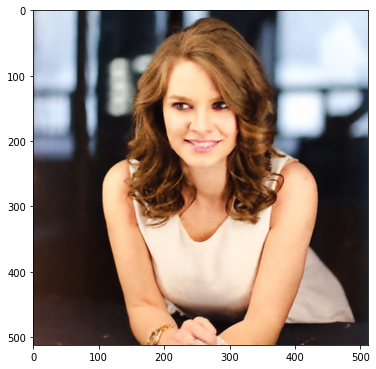

Iteration 02601    Loss 0.000270Iteration 02602    Loss 0.000254Iteration 02603    Loss 0.000262Iteration 02604    Loss 0.000276Iteration 02605    Loss 0.000278Iteration 02606    Loss 0.000251Iteration 02607    Loss 0.000256Iteration 02608    Loss 0.000267Iteration 02609    Loss 0.000265Iteration 02610    Loss 0.000266Iteration 02611    Loss 0.000268Iteration 02612    Loss 0.000271Iteration 02613    Loss 0.000288Iteration 02614    Loss 0.000271Iteration 02615    Loss 0.000264Iteration 02616    Loss 0.000258Iteration 02617    Loss 0.000257Iteration 02618    Loss 0.000262Iteration 02619    Loss 0.000276Iteration 02620    Loss 0.000276Iteration 02621    Loss 0.000255Iteration 02622    Loss 0.000258Iteration 02623    Loss 0.000280Iteration 02624    Loss 0.000280Iteration 02625    Loss 0.000265Iteration 02626    Loss 0.000277Iteration 02627    Loss 0.000278Iteration 02628    Loss 0.000274Iteration 02629    Loss 0.000281Iteration 02630    Loss 0.000289Iteration 02631    Loss 0.000274Iteratio

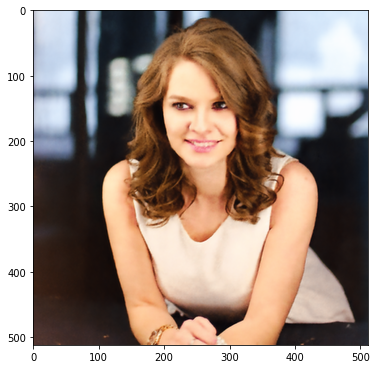

Iteration 02651    Loss 0.000277Iteration 02652    Loss 0.000263Iteration 02653    Loss 0.000256Iteration 02654    Loss 0.000271Iteration 02655    Loss 0.000270Iteration 02656    Loss 0.000261Iteration 02657    Loss 0.000255Iteration 02658    Loss 0.000259Iteration 02659    Loss 0.000267Iteration 02660    Loss 0.000255Iteration 02661    Loss 0.000251Iteration 02662    Loss 0.000280Iteration 02663    Loss 0.000264Iteration 02664    Loss 0.000250Iteration 02665    Loss 0.000259Iteration 02666    Loss 0.000282Iteration 02667    Loss 0.000264Iteration 02668    Loss 0.000251Iteration 02669    Loss 0.000269Iteration 02670    Loss 0.000282Iteration 02671    Loss 0.000256Iteration 02672    Loss 0.000247Iteration 02673    Loss 0.000286Iteration 02674    Loss 0.000285Iteration 02675    Loss 0.000251Iteration 02676    Loss 0.000244Iteration 02677    Loss 0.000251Iteration 02678    Loss 0.000253Iteration 02679    Loss 0.000241Iteration 02680    Loss 0.000243Iteration 02681    Loss 0.000241Iteratio

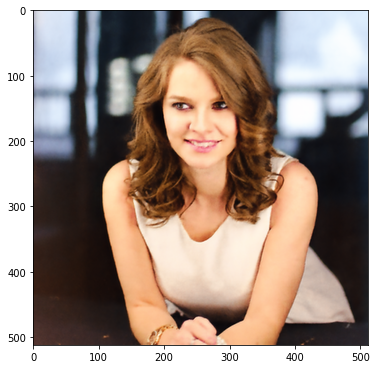

Iteration 02701    Loss 0.000248Iteration 02702    Loss 0.000256Iteration 02703    Loss 0.000241Iteration 02704    Loss 0.000270Iteration 02705    Loss 0.000273Iteration 02706    Loss 0.000260Iteration 02707    Loss 0.000239Iteration 02708    Loss 0.000260Iteration 02709    Loss 0.000275Iteration 02710    Loss 0.000264Iteration 02711    Loss 0.000249Iteration 02712    Loss 0.000262Iteration 02713    Loss 0.000270Iteration 02714    Loss 0.000254Iteration 02715    Loss 0.000246Iteration 02716    Loss 0.000253Iteration 02717    Loss 0.000255Iteration 02718    Loss 0.000244Iteration 02719    Loss 0.000241Iteration 02720    Loss 0.000245Iteration 02721    Loss 0.000253Iteration 02722    Loss 0.000259Iteration 02723    Loss 0.000250Iteration 02724    Loss 0.000252Iteration 02725    Loss 0.000252Iteration 02726    Loss 0.000242Iteration 02727    Loss 0.000248Iteration 02728    Loss 0.000267Iteration 02729    Loss 0.000269Iteration 02730    Loss 0.000244Iteration 02731    Loss 0.000251Iteratio

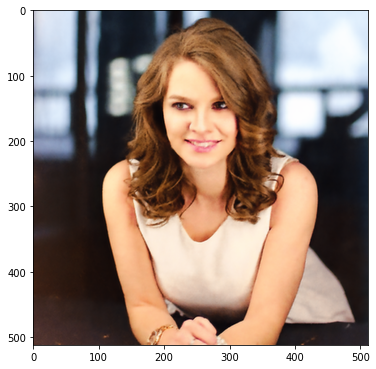

Iteration 02751    Loss 0.000257Iteration 02752    Loss 0.000243Iteration 02753    Loss 0.000249Iteration 02754    Loss 0.000247Iteration 02755    Loss 0.000250Iteration 02756    Loss 0.000248Iteration 02757    Loss 0.000255Iteration 02758    Loss 0.000271Iteration 02759    Loss 0.000256Iteration 02760    Loss 0.000244Iteration 02761    Loss 0.000237Iteration 02762    Loss 0.000251Iteration 02763    Loss 0.000252Iteration 02764    Loss 0.000244Iteration 02765    Loss 0.000235Iteration 02766    Loss 0.000243Iteration 02767    Loss 0.000253Iteration 02768    Loss 0.000247Iteration 02769    Loss 0.000241Iteration 02770    Loss 0.000239Iteration 02771    Loss 0.000256Iteration 02772    Loss 0.000251Iteration 02773    Loss 0.000242Iteration 02774    Loss 0.000243Iteration 02775    Loss 0.000238Iteration 02776    Loss 0.000242Iteration 02777    Loss 0.000240Iteration 02778    Loss 0.000243Iteration 02779    Loss 0.000243Iteration 02780    Loss 0.000247Iteration 02781    Loss 0.000242Iteratio

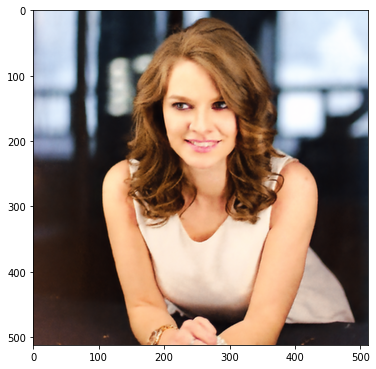

Iteration 02801    Loss 0.000255Iteration 02802    Loss 0.000235Iteration 02803    Loss 0.000248Iteration 02804    Loss 0.000270Iteration 02805    Loss 0.000278Iteration 02806    Loss 0.000250Iteration 02807    Loss 0.000232Iteration 02808    Loss 0.000241Iteration 02809    Loss 0.000253Iteration 02810    Loss 0.000249Iteration 02811    Loss 0.000241Iteration 02812    Loss 0.000237Iteration 02813    Loss 0.000234Iteration 02814    Loss 0.000245Iteration 02815    Loss 0.000250Iteration 02816    Loss 0.000241Iteration 02817    Loss 0.000233Iteration 02818    Loss 0.000235Iteration 02819    Loss 0.000238Iteration 02820    Loss 0.000249Iteration 02821    Loss 0.000253Iteration 02822    Loss 0.000234Iteration 02823    Loss 0.000238Iteration 02824    Loss 0.000254Iteration 02825    Loss 0.000273Iteration 02826    Loss 0.000254Iteration 02827    Loss 0.000236Iteration 02828    Loss 0.000232Iteration 02829    Loss 0.000246Iteration 02830    Loss 0.000243Iteration 02831    Loss 0.000239Iteratio

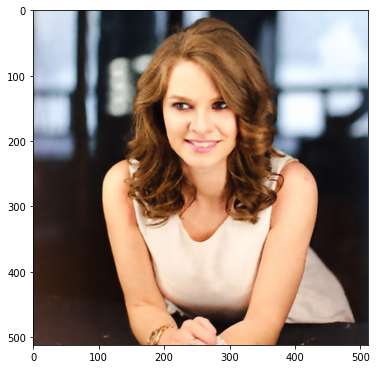

Iteration 02851    Loss 0.000268Iteration 02852    Loss 0.000294Iteration 02853    Loss 0.000279Iteration 02854    Loss 0.000250Iteration 02855    Loss 0.000258Iteration 02856    Loss 0.000265Iteration 02857    Loss 0.000258Iteration 02858    Loss 0.000241Iteration 02859    Loss 0.000254Iteration 02860    Loss 0.000264Iteration 02861    Loss 0.000248Iteration 02862    Loss 0.000249Iteration 02863    Loss 0.000255Iteration 02864    Loss 0.000249Iteration 02865    Loss 0.000233Iteration 02866    Loss 0.000245Iteration 02867    Loss 0.000257Iteration 02868    Loss 0.000232Iteration 02869    Loss 0.000237Iteration 02870    Loss 0.000263Iteration 02871    Loss 0.000257Iteration 02872    Loss 0.000245Iteration 02873    Loss 0.000236Iteration 02874    Loss 0.000239Iteration 02875    Loss 0.000242Iteration 02876    Loss 0.000259Iteration 02877    Loss 0.000241Iteration 02878    Loss 0.000232Iteration 02879    Loss 0.000242Iteration 02880    Loss 0.000260Iteration 02881    Loss 0.000258Iteratio

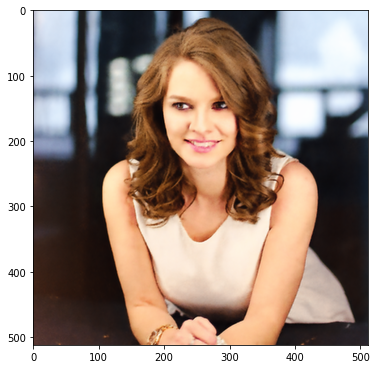

Iteration 02901    Loss 0.000235Iteration 02902    Loss 0.000231Iteration 02903    Loss 0.000228Iteration 02904    Loss 0.000224Iteration 02905    Loss 0.000222Iteration 02906    Loss 0.000221Iteration 02907    Loss 0.000228Iteration 02908    Loss 0.000221Iteration 02909    Loss 0.000222Iteration 02910    Loss 0.000220Iteration 02911    Loss 0.000222Iteration 02912    Loss 0.000231Iteration 02913    Loss 0.000226Iteration 02914    Loss 0.000224Iteration 02915    Loss 0.000226Iteration 02916    Loss 0.000229Iteration 02917    Loss 0.000222Iteration 02918    Loss 0.000229Iteration 02919    Loss 0.000233Iteration 02920    Loss 0.000241Iteration 02921    Loss 0.000232Iteration 02922    Loss 0.000227Iteration 02923    Loss 0.000237Iteration 02924    Loss 0.000247Iteration 02925    Loss 0.000256Iteration 02926    Loss 0.000238Iteration 02927    Loss 0.000228Iteration 02928    Loss 0.000247Iteration 02929    Loss 0.000271Iteration 02930    Loss 0.000255Iteration 02931    Loss 0.000228Iteratio

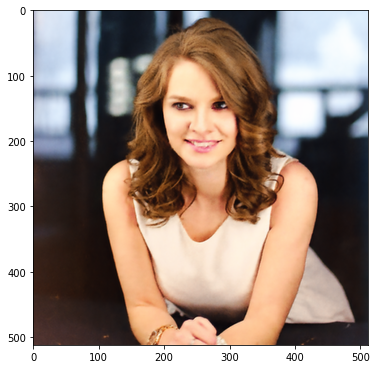

Iteration 02951    Loss 0.000220Iteration 02952    Loss 0.000229Iteration 02953    Loss 0.000228Iteration 02954    Loss 0.000223Iteration 02955    Loss 0.000222Iteration 02956    Loss 0.000224Iteration 02957    Loss 0.000232Iteration 02958    Loss 0.000227Iteration 02959    Loss 0.000222Iteration 02960    Loss 0.000224Iteration 02961    Loss 0.000227Iteration 02962    Loss 0.000225Iteration 02963    Loss 0.000223Iteration 02964    Loss 0.000224Iteration 02965    Loss 0.000222Iteration 02966    Loss 0.000223Iteration 02967    Loss 0.000224Iteration 02968    Loss 0.000227Iteration 02969    Loss 0.000222Iteration 02970    Loss 0.000226Iteration 02971    Loss 0.000228Iteration 02972    Loss 0.000230Iteration 02973    Loss 0.000221Iteration 02974    Loss 0.000220Iteration 02975    Loss 0.000218Iteration 02976    Loss 0.000219Iteration 02977    Loss 0.000218Iteration 02978    Loss 0.000220Iteration 02979    Loss 0.000222Iteration 02980    Loss 0.000228Iteration 02981    Loss 0.000227Iteratio

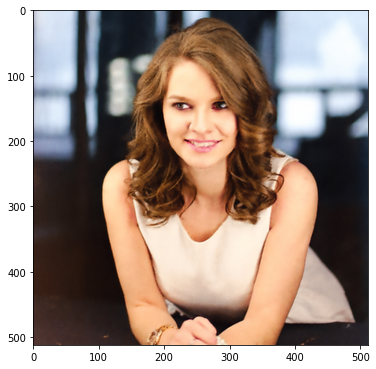

Iteration 03001    Loss 0.000229Iteration 03002    Loss 0.000222Iteration 03003    Loss 0.000221Iteration 03004    Loss 0.000215Iteration 03005    Loss 0.000216Iteration 03006    Loss 0.000213Iteration 03007    Loss 0.000219Iteration 03008    Loss 0.000235Iteration 03009    Loss 0.000251Iteration 03010    Loss 0.000257Iteration 03011    Loss 0.000245Iteration 03012    Loss 0.000253Iteration 03013    Loss 0.000259Iteration 03014    Loss 0.000253Iteration 03015    Loss 0.000265Iteration 03016    Loss 0.000255Iteration 03017    Loss 0.000246Iteration 03018    Loss 0.000236Iteration 03019    Loss 0.000230Iteration 03020    Loss 0.000226Iteration 03021    Loss 0.000221Iteration 03022    Loss 0.000232Iteration 03023    Loss 0.000226Iteration 03024    Loss 0.000222Iteration 03025    Loss 0.000219Iteration 03026    Loss 0.000220Iteration 03027    Loss 0.000226Iteration 03028    Loss 0.000224Iteration 03029    Loss 0.000218Iteration 03030    Loss 0.000218Iteration 03031    Loss 0.000223Iteratio

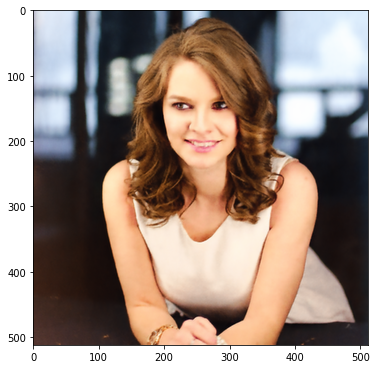

Iteration 03051    Loss 0.000220Iteration 03052    Loss 0.000230Iteration 03053    Loss 0.000246Iteration 03054    Loss 0.000241Iteration 03055    Loss 0.000222Iteration 03056    Loss 0.000228Iteration 03057    Loss 0.000237Iteration 03058    Loss 0.000258Iteration 03059    Loss 0.000252Iteration 03060    Loss 0.000227Iteration 03061    Loss 0.000218Iteration 03062    Loss 0.000252Iteration 03063    Loss 0.000251Iteration 03064    Loss 0.000245Iteration 03065    Loss 0.000224Iteration 03066    Loss 0.000217Iteration 03067    Loss 0.000227Iteration 03068    Loss 0.000246Iteration 03069    Loss 0.000229Iteration 03070    Loss 0.000217Iteration 03071    Loss 0.000225Iteration 03072    Loss 0.000235Iteration 03073    Loss 0.000234Iteration 03074    Loss 0.000230Iteration 03075    Loss 0.000238Iteration 03076    Loss 0.000262Iteration 03077    Loss 0.000259Iteration 03078    Loss 0.000235Iteration 03079    Loss 0.000215Iteration 03080    Loss 0.000220Iteration 03081    Loss 0.000234Iteratio

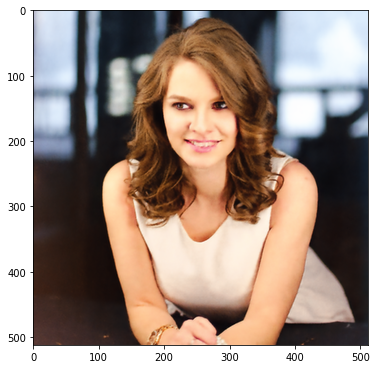

Iteration 03101    Loss 0.000215Iteration 03102    Loss 0.000210Iteration 03103    Loss 0.000214Iteration 03104    Loss 0.000219Iteration 03105    Loss 0.000215Iteration 03106    Loss 0.000212Iteration 03107    Loss 0.000216Iteration 03108    Loss 0.000221Iteration 03109    Loss 0.000218Iteration 03110    Loss 0.000208Iteration 03111    Loss 0.000208Iteration 03112    Loss 0.000209Iteration 03113    Loss 0.000222Iteration 03114    Loss 0.000226Iteration 03115    Loss 0.000214Iteration 03116    Loss 0.000212Iteration 03117    Loss 0.000212Iteration 03118    Loss 0.000216Iteration 03119    Loss 0.000219Iteration 03120    Loss 0.000212Iteration 03121    Loss 0.000216Iteration 03122    Loss 0.000213Iteration 03123    Loss 0.000225Iteration 03124    Loss 0.000220Iteration 03125    Loss 0.000217Iteration 03126    Loss 0.000212Iteration 03127    Loss 0.000217Iteration 03128    Loss 0.000239Iteration 03129    Loss 0.000276Iteration 03130    Loss 0.000277Iteration 03131    Loss 0.000249Iteratio

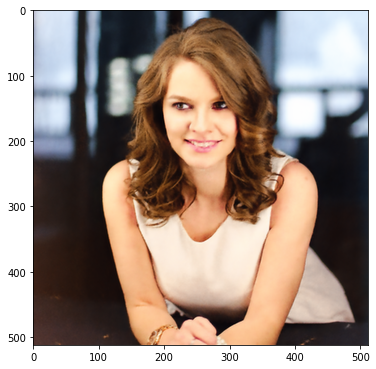

Iteration 03151    Loss 0.000227Iteration 03152    Loss 0.000224Iteration 03153    Loss 0.000225Iteration 03154    Loss 0.000219Iteration 03155    Loss 0.000211Iteration 03156    Loss 0.000214Iteration 03157    Loss 0.000218Iteration 03158    Loss 0.000216Iteration 03159    Loss 0.000228Iteration 03160    Loss 0.000215Iteration 03161    Loss 0.000215Iteration 03162    Loss 0.000220Iteration 03163    Loss 0.000223Iteration 03164    Loss 0.000220Iteration 03165    Loss 0.000228Iteration 03166    Loss 0.000222Iteration 03167    Loss 0.000232Iteration 03168    Loss 0.000249Iteration 03169    Loss 0.000249Iteration 03170    Loss 0.000236Iteration 03171    Loss 0.000221Iteration 03172    Loss 0.000220Iteration 03173    Loss 0.000231Iteration 03174    Loss 0.000232Iteration 03175    Loss 0.000217Iteration 03176    Loss 0.000219Iteration 03177    Loss 0.000211Iteration 03178    Loss 0.000202Iteration 03179    Loss 0.000216Iteration 03180    Loss 0.000221Iteration 03181    Loss 0.000216Iteratio

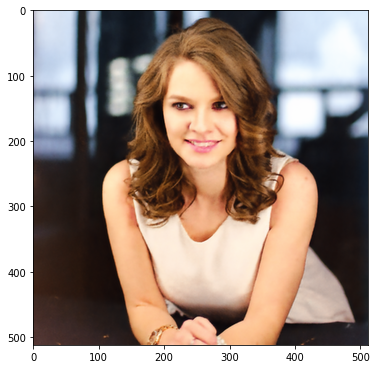

Iteration 03201    Loss 0.000213Iteration 03202    Loss 0.000213Iteration 03203    Loss 0.000213Iteration 03204    Loss 0.000211Iteration 03205    Loss 0.000212Iteration 03206    Loss 0.000203Iteration 03207    Loss 0.000214Iteration 03208    Loss 0.000214Iteration 03209    Loss 0.000222Iteration 03210    Loss 0.000222Iteration 03211    Loss 0.000227Iteration 03212    Loss 0.000219Iteration 03213    Loss 0.000221Iteration 03214    Loss 0.000207Iteration 03215    Loss 0.000215Iteration 03216    Loss 0.000219Iteration 03217    Loss 0.000236Iteration 03218    Loss 0.000248Iteration 03219    Loss 0.000231Iteration 03220    Loss 0.000216Iteration 03221    Loss 0.000221Iteration 03222    Loss 0.000235Iteration 03223    Loss 0.000245Iteration 03224    Loss 0.000221Iteration 03225    Loss 0.000207Iteration 03226    Loss 0.000213Iteration 03227    Loss 0.000208Iteration 03228    Loss 0.000206Iteration 03229    Loss 0.000200Iteration 03230    Loss 0.000204Iteration 03231    Loss 0.000214Iteratio

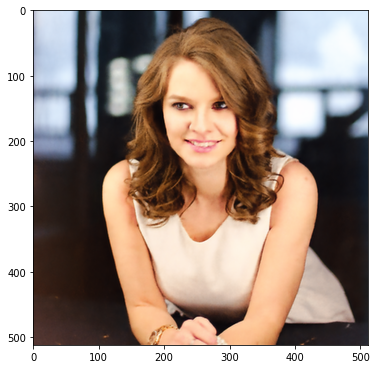

Iteration 03251    Loss 0.000220Iteration 03252    Loss 0.000199Iteration 03253    Loss 0.000203Iteration 03254    Loss 0.000221Iteration 03255    Loss 0.000218Iteration 03256    Loss 0.000212Iteration 03257    Loss 0.000203Iteration 03258    Loss 0.000204Iteration 03259    Loss 0.000205Iteration 03260    Loss 0.000217Iteration 03261    Loss 0.000216Iteration 03262    Loss 0.000203Iteration 03263    Loss 0.000208Iteration 03264    Loss 0.000208Iteration 03265    Loss 0.000210Iteration 03266    Loss 0.000209Iteration 03267    Loss 0.000206Iteration 03268    Loss 0.000210Iteration 03269    Loss 0.000214Iteration 03270    Loss 0.000217Iteration 03271    Loss 0.000210Iteration 03272    Loss 0.000197Iteration 03273    Loss 0.000203Iteration 03274    Loss 0.000211Iteration 03275    Loss 0.000224Iteration 03276    Loss 0.000217Iteration 03277    Loss 0.000213Iteration 03278    Loss 0.000202Iteration 03279    Loss 0.000195Iteration 03280    Loss 0.000201Iteration 03281    Loss 0.000207Iteratio

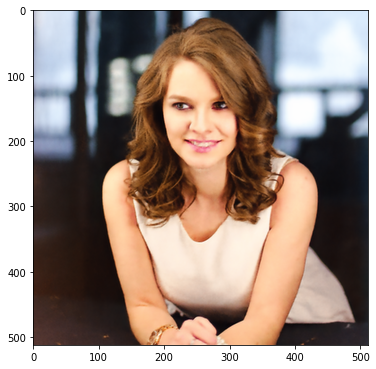

Iteration 03301    Loss 0.000211Iteration 03302    Loss 0.000217Iteration 03303    Loss 0.000216Iteration 03304    Loss 0.000202Iteration 03305    Loss 0.000195Iteration 03306    Loss 0.000215Iteration 03307    Loss 0.000228Iteration 03308    Loss 0.000218Iteration 03309    Loss 0.000203Iteration 03310    Loss 0.000201Iteration 03311    Loss 0.000201Iteration 03312    Loss 0.000212Iteration 03313    Loss 0.000214Iteration 03314    Loss 0.000208Iteration 03315    Loss 0.000201Iteration 03316    Loss 0.000195Iteration 03317    Loss 0.000211Iteration 03318    Loss 0.000227Iteration 03319    Loss 0.000224Iteration 03320    Loss 0.000216Iteration 03321    Loss 0.000206Iteration 03322    Loss 0.000204Iteration 03323    Loss 0.000221Iteration 03324    Loss 0.000237Iteration 03325    Loss 0.000233Iteration 03326    Loss 0.000232Iteration 03327    Loss 0.000234Iteration 03328    Loss 0.000228Iteration 03329    Loss 0.000216Iteration 03330    Loss 0.000225Iteration 03331    Loss 0.000240Iteratio

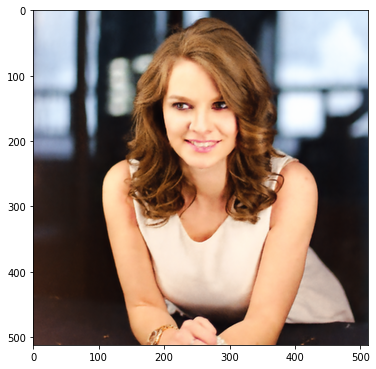

Iteration 03351    Loss 0.000212Iteration 03352    Loss 0.000199Iteration 03353    Loss 0.000212Iteration 03354    Loss 0.000212Iteration 03355    Loss 0.000210Iteration 03356    Loss 0.000197Iteration 03357    Loss 0.000197Iteration 03358    Loss 0.000210Iteration 03359    Loss 0.000206Iteration 03360    Loss 0.000200Iteration 03361    Loss 0.000190Iteration 03362    Loss 0.000193Iteration 03363    Loss 0.000195Iteration 03364    Loss 0.000191Iteration 03365    Loss 0.000194Iteration 03366    Loss 0.000194Iteration 03367    Loss 0.000193Iteration 03368    Loss 0.000198Iteration 03369    Loss 0.000196Iteration 03370    Loss 0.000199Iteration 03371    Loss 0.000192Iteration 03372    Loss 0.000195Iteration 03373    Loss 0.000191Iteration 03374    Loss 0.000191Iteration 03375    Loss 0.000196Iteration 03376    Loss 0.000193Iteration 03377    Loss 0.000192Iteration 03378    Loss 0.000194Iteration 03379    Loss 0.000193Iteration 03380    Loss 0.000194Iteration 03381    Loss 0.000192Iteratio

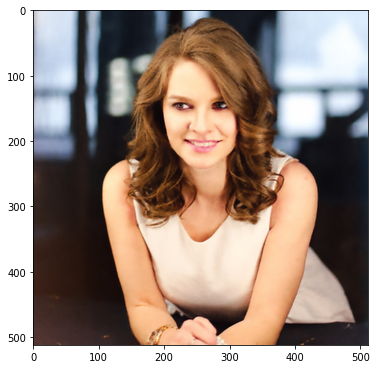

Iteration 03401    Loss 0.000190Iteration 03402    Loss 0.000185Iteration 03403    Loss 0.000192Iteration 03404    Loss 0.000195Iteration 03405    Loss 0.000199Iteration 03406    Loss 0.000195Iteration 03407    Loss 0.000195Iteration 03408    Loss 0.000190Iteration 03409    Loss 0.000185Iteration 03410    Loss 0.000198Iteration 03411    Loss 0.000219Iteration 03412    Loss 0.000230Iteration 03413    Loss 0.000220Iteration 03414    Loss 0.000195Iteration 03415    Loss 0.000204Iteration 03416    Loss 0.000219Iteration 03417    Loss 0.000217Iteration 03418    Loss 0.000204Iteration 03419    Loss 0.000200Iteration 03420    Loss 0.000223Iteration 03421    Loss 0.000254Iteration 03422    Loss 0.000263Iteration 03423    Loss 0.000227Iteration 03424    Loss 0.000199Iteration 03425    Loss 0.000210Iteration 03426    Loss 0.000260Iteration 03427    Loss 0.000245Iteration 03428    Loss 0.000212Iteration 03429    Loss 0.000206Iteration 03430    Loss 0.000240Iteration 03431    Loss 0.000263Iteratio

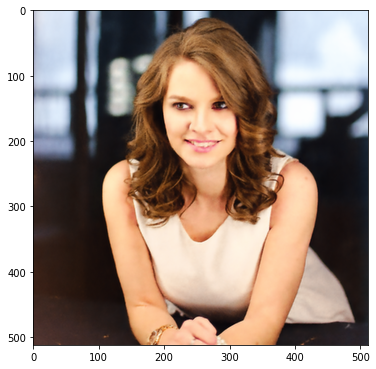

Iteration 03451    Loss 0.000197Iteration 03452    Loss 0.000195Iteration 03453    Loss 0.000200Iteration 03454    Loss 0.000205Iteration 03455    Loss 0.000206Iteration 03456    Loss 0.000199Iteration 03457    Loss 0.000191Iteration 03458    Loss 0.000195Iteration 03459    Loss 0.000201Iteration 03460    Loss 0.000195Iteration 03461    Loss 0.000194Iteration 03462    Loss 0.000189Iteration 03463    Loss 0.000184Iteration 03464    Loss 0.000190Iteration 03465    Loss 0.000192Iteration 03466    Loss 0.000190Iteration 03467    Loss 0.000193Iteration 03468    Loss 0.000196Iteration 03469    Loss 0.000194Iteration 03470    Loss 0.000185Iteration 03471    Loss 0.000187Iteration 03472    Loss 0.000187Iteration 03473    Loss 0.000190Iteration 03474    Loss 0.000191Iteration 03475    Loss 0.000203Iteration 03476    Loss 0.000218Iteration 03477    Loss 0.000212Iteration 03478    Loss 0.000190Iteration 03479    Loss 0.000179Iteration 03480    Loss 0.000199Iteration 03481    Loss 0.000217Iteratio

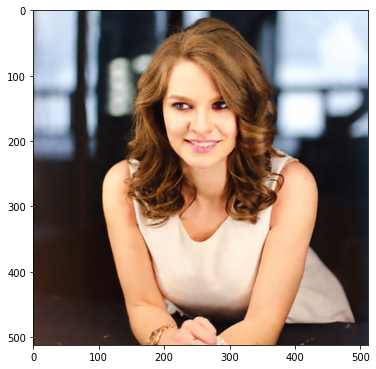

Iteration 03501    Loss 0.000187Iteration 03502    Loss 0.000200Iteration 03503    Loss 0.000206Iteration 03504    Loss 0.000196Iteration 03505    Loss 0.000186Iteration 03506    Loss 0.000200Iteration 03507    Loss 0.000204Iteration 03508    Loss 0.000204Iteration 03509    Loss 0.000203Iteration 03510    Loss 0.000209Iteration 03511    Loss 0.000213Iteration 03512    Loss 0.000198Iteration 03513    Loss 0.000188Iteration 03514    Loss 0.000189Iteration 03515    Loss 0.000192Iteration 03516    Loss 0.000187Iteration 03517    Loss 0.000183Iteration 03518    Loss 0.000195Iteration 03519    Loss 0.000192Iteration 03520    Loss 0.000190Iteration 03521    Loss 0.000190Iteration 03522    Loss 0.000186Iteration 03523    Loss 0.000191Iteration 03524    Loss 0.000189Iteration 03525    Loss 0.000190Iteration 03526    Loss 0.000185Iteration 03527    Loss 0.000184Iteration 03528    Loss 0.000188Iteration 03529    Loss 0.000188Iteration 03530    Loss 0.000189Iteration 03531    Loss 0.000191Iteratio

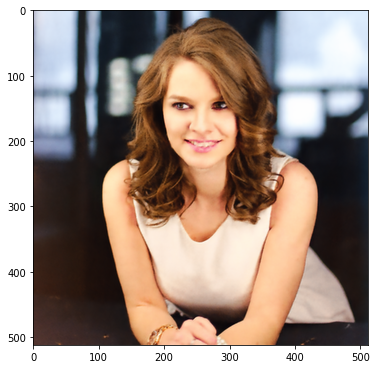

Iteration 03551    Loss 0.000199Iteration 03552    Loss 0.000196Iteration 03553    Loss 0.000193Iteration 03554    Loss 0.000187Iteration 03555    Loss 0.000181Iteration 03556    Loss 0.000184Iteration 03557    Loss 0.000190Iteration 03558    Loss 0.000190Iteration 03559    Loss 0.000182Iteration 03560    Loss 0.000184Iteration 03561    Loss 0.000178Iteration 03562    Loss 0.000181Iteration 03563    Loss 0.000183Iteration 03564    Loss 0.000188Iteration 03565    Loss 0.000201Iteration 03566    Loss 0.000207Iteration 03567    Loss 0.000192Iteration 03568    Loss 0.000194Iteration 03569    Loss 0.000196Iteration 03570    Loss 0.000207Iteration 03571    Loss 0.000221Iteration 03572    Loss 0.000200Iteration 03573    Loss 0.000183Iteration 03574    Loss 0.000213Iteration 03575    Loss 0.000219Iteration 03576    Loss 0.000224Iteration 03577    Loss 0.000196Iteration 03578    Loss 0.000187Iteration 03579    Loss 0.000209Iteration 03580    Loss 0.000221Iteration 03581    Loss 0.000214Iteratio

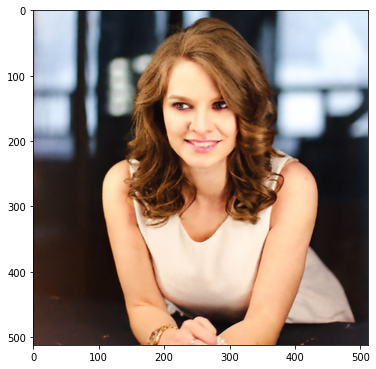

Iteration 03601    Loss 0.000217Iteration 03602    Loss 0.000216Iteration 03603    Loss 0.000214Iteration 03604    Loss 0.000209Iteration 03605    Loss 0.000190Iteration 03606    Loss 0.000187Iteration 03607    Loss 0.000194Iteration 03608    Loss 0.000192Iteration 03609    Loss 0.000181Iteration 03610    Loss 0.000182Iteration 03611    Loss 0.000190Iteration 03612    Loss 0.000193Iteration 03613    Loss 0.000186Iteration 03614    Loss 0.000184Iteration 03615    Loss 0.000177Iteration 03616    Loss 0.000186Iteration 03617    Loss 0.000188Iteration 03618    Loss 0.000183Iteration 03619    Loss 0.000175Iteration 03620    Loss 0.000186Iteration 03621    Loss 0.000186Iteration 03622    Loss 0.000188Iteration 03623    Loss 0.000185Iteration 03624    Loss 0.000195Iteration 03625    Loss 0.000196Iteration 03626    Loss 0.000204Iteration 03627    Loss 0.000198Iteration 03628    Loss 0.000185Iteration 03629    Loss 0.000175Iteration 03630    Loss 0.000192Iteration 03631    Loss 0.000210Iteratio

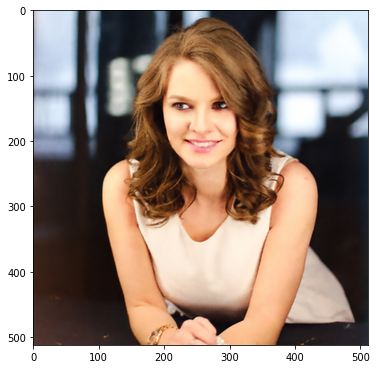

Iteration 03651    Loss 0.000178Iteration 03652    Loss 0.000193Iteration 03653    Loss 0.000183Iteration 03654    Loss 0.000175Iteration 03655    Loss 0.000178Iteration 03656    Loss 0.000180Iteration 03657    Loss 0.000183Iteration 03658    Loss 0.000177Iteration 03659    Loss 0.000182Iteration 03660    Loss 0.000179Iteration 03661    Loss 0.000180Iteration 03662    Loss 0.000174Iteration 03663    Loss 0.000176Iteration 03664    Loss 0.000172Iteration 03665    Loss 0.000179Iteration 03666    Loss 0.000179Iteration 03667    Loss 0.000176Iteration 03668    Loss 0.000174Iteration 03669    Loss 0.000176Iteration 03670    Loss 0.000176Iteration 03671    Loss 0.000175Iteration 03672    Loss 0.000173Iteration 03673    Loss 0.000171Iteration 03674    Loss 0.000174Iteration 03675    Loss 0.000178Iteration 03676    Loss 0.000172Iteration 03677    Loss 0.000176Iteration 03678    Loss 0.000184Iteration 03679    Loss 0.000192Iteration 03680    Loss 0.000200Iteration 03681    Loss 0.000217Iteratio

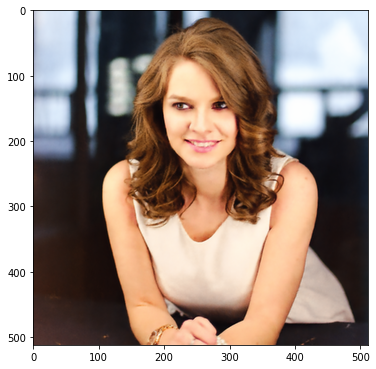

Iteration 03701    Loss 0.000176Iteration 03702    Loss 0.000175Iteration 03703    Loss 0.000179Iteration 03704    Loss 0.000179Iteration 03705    Loss 0.000174Iteration 03706    Loss 0.000179Iteration 03707    Loss 0.000176Iteration 03708    Loss 0.000172Iteration 03709    Loss 0.000174Iteration 03710    Loss 0.000190Iteration 03711    Loss 0.000204Iteration 03712    Loss 0.000213Iteration 03713    Loss 0.000205Iteration 03714    Loss 0.000190Iteration 03715    Loss 0.000174Iteration 03716    Loss 0.000174Iteration 03717    Loss 0.000182Iteration 03718    Loss 0.000180Iteration 03719    Loss 0.000176Iteration 03720    Loss 0.000181Iteration 03721    Loss 0.000183Iteration 03722    Loss 0.000173Iteration 03723    Loss 0.000178Iteration 03724    Loss 0.000182Iteration 03725    Loss 0.000186Iteration 03726    Loss 0.000178Iteration 03727    Loss 0.000171Iteration 03728    Loss 0.000175Iteration 03729    Loss 0.000173Iteration 03730    Loss 0.000173Iteration 03731    Loss 0.000187Iteratio

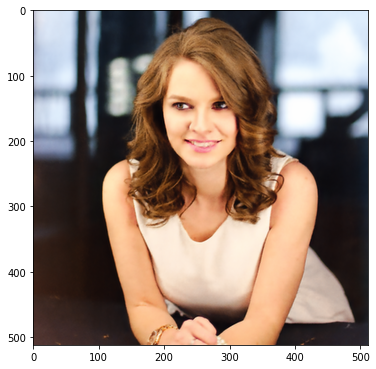

Iteration 03751    Loss 0.000175Iteration 03752    Loss 0.000173Iteration 03753    Loss 0.000178Iteration 03754    Loss 0.000176Iteration 03755    Loss 0.000179Iteration 03756    Loss 0.000176Iteration 03757    Loss 0.000172Iteration 03758    Loss 0.000181Iteration 03759    Loss 0.000184Iteration 03760    Loss 0.000176Iteration 03761    Loss 0.000171Iteration 03762    Loss 0.000172Iteration 03763    Loss 0.000174Iteration 03764    Loss 0.000176Iteration 03765    Loss 0.000173Iteration 03766    Loss 0.000172Iteration 03767    Loss 0.000169Iteration 03768    Loss 0.000168Iteration 03769    Loss 0.000176Iteration 03770    Loss 0.000180Iteration 03771    Loss 0.000180Iteration 03772    Loss 0.000179Iteration 03773    Loss 0.000191Iteration 03774    Loss 0.000200Iteration 03775    Loss 0.000208Iteration 03776    Loss 0.000190Iteration 03777    Loss 0.000178Iteration 03778    Loss 0.000171Iteration 03779    Loss 0.000195Iteration 03780    Loss 0.000231Iteration 03781    Loss 0.000240Iteratio

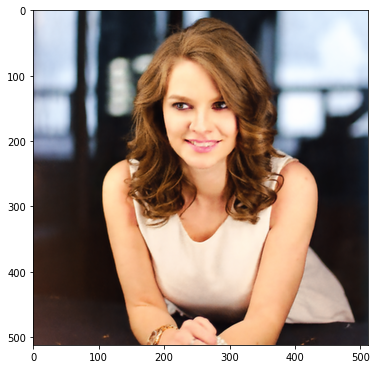

Iteration 03801    Loss 0.000168Iteration 03802    Loss 0.000174Iteration 03803    Loss 0.000184Iteration 03804    Loss 0.000184Iteration 03805    Loss 0.000180Iteration 03806    Loss 0.000177Iteration 03807    Loss 0.000171Iteration 03808    Loss 0.000182Iteration 03809    Loss 0.000191Iteration 03810    Loss 0.000192Iteration 03811    Loss 0.000196Iteration 03812    Loss 0.000185Iteration 03813    Loss 0.000171Iteration 03814    Loss 0.000178Iteration 03815    Loss 0.000181Iteration 03816    Loss 0.000197Iteration 03817    Loss 0.000191Iteration 03818    Loss 0.000189Iteration 03819    Loss 0.000181Iteration 03820    Loss 0.000172Iteration 03821    Loss 0.000177Iteration 03822    Loss 0.000190Iteration 03823    Loss 0.000187Iteration 03824    Loss 0.000186Iteration 03825    Loss 0.000175Iteration 03826    Loss 0.000171Iteration 03827    Loss 0.000174Iteration 03828    Loss 0.000172Iteration 03829    Loss 0.000187Iteration 03830    Loss 0.000184Iteration 03831    Loss 0.000178Iteratio

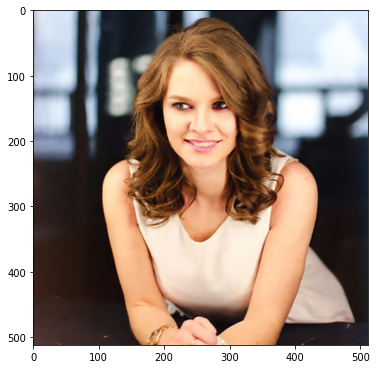

Iteration 03851    Loss 0.000175Iteration 03852    Loss 0.000187Iteration 03853    Loss 0.000187Iteration 03854    Loss 0.000180Iteration 03855    Loss 0.000173Iteration 03856    Loss 0.000165Iteration 03857    Loss 0.000165Iteration 03858    Loss 0.000171Iteration 03859    Loss 0.000167Iteration 03860    Loss 0.000165Iteration 03861    Loss 0.000168Iteration 03862    Loss 0.000172Iteration 03863    Loss 0.000173Iteration 03864    Loss 0.000173Iteration 03865    Loss 0.000170Iteration 03866    Loss 0.000169Iteration 03867    Loss 0.000163Iteration 03868    Loss 0.000174Iteration 03869    Loss 0.000173Iteration 03870    Loss 0.000174Iteration 03871    Loss 0.000171Iteration 03872    Loss 0.000168Iteration 03873    Loss 0.000166Iteration 03874    Loss 0.000162Iteration 03875    Loss 0.000167Iteration 03876    Loss 0.000169Iteration 03877    Loss 0.000171Iteration 03878    Loss 0.000174Iteration 03879    Loss 0.000182Iteration 03880    Loss 0.000180Iteration 03881    Loss 0.000170Iteratio

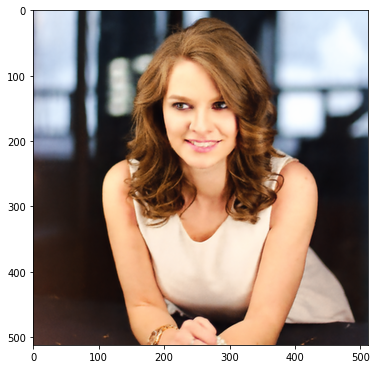

Iteration 03901    Loss 0.000190Iteration 03902    Loss 0.000186Iteration 03903    Loss 0.000184Iteration 03904    Loss 0.000171Iteration 03905    Loss 0.000165Iteration 03906    Loss 0.000163Iteration 03907    Loss 0.000163Iteration 03908    Loss 0.000163Iteration 03909    Loss 0.000166Iteration 03910    Loss 0.000168Iteration 03911    Loss 0.000174Iteration 03912    Loss 0.000173Iteration 03913    Loss 0.000167Iteration 03914    Loss 0.000168Iteration 03915    Loss 0.000173Iteration 03916    Loss 0.000183Iteration 03917    Loss 0.000188Iteration 03918    Loss 0.000190Iteration 03919    Loss 0.000178Iteration 03920    Loss 0.000167Iteration 03921    Loss 0.000164Iteration 03922    Loss 0.000178Iteration 03923    Loss 0.000190Iteration 03924    Loss 0.000198Iteration 03925    Loss 0.000195Iteration 03926    Loss 0.000188Iteration 03927    Loss 0.000175Iteration 03928    Loss 0.000173Iteration 03929    Loss 0.000181Iteration 03930    Loss 0.000208Iteration 03931    Loss 0.000220Iteratio

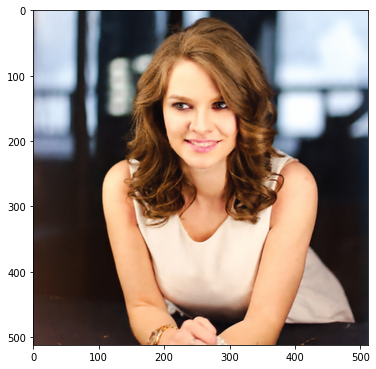

Iteration 03951    Loss 0.000177Iteration 03952    Loss 0.000176Iteration 03953    Loss 0.000164Iteration 03954    Loss 0.000165Iteration 03955    Loss 0.000166Iteration 03956    Loss 0.000170Iteration 03957    Loss 0.000164Iteration 03958    Loss 0.000164Iteration 03959    Loss 0.000163Iteration 03960    Loss 0.000171Iteration 03961    Loss 0.000177Iteration 03962    Loss 0.000181Iteration 03963    Loss 0.000169Iteration 03964    Loss 0.000161Iteration 03965    Loss 0.000160Iteration 03966    Loss 0.000164Iteration 03967    Loss 0.000162Iteration 03968    Loss 0.000160Iteration 03969    Loss 0.000164Iteration 03970    Loss 0.000170Iteration 03971    Loss 0.000176Iteration 03972    Loss 0.000176Iteration 03973    Loss 0.000177Iteration 03974    Loss 0.000172Iteration 03975    Loss 0.000168Iteration 03976    Loss 0.000169Iteration 03977    Loss 0.000174Iteration 03978    Loss 0.000171Iteration 03979    Loss 0.000163Iteration 03980    Loss 0.000162Iteration 03981    Loss 0.000176Iteratio

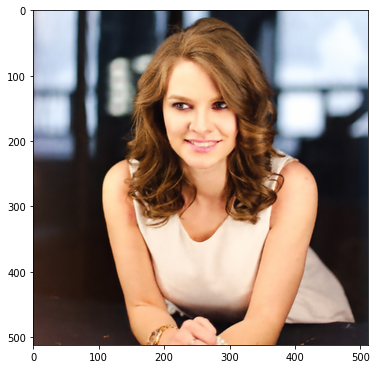

Iteration 04001    Loss 0.000163Iteration 04002    Loss 0.000158Iteration 04003    Loss 0.000164Iteration 04004    Loss 0.000166Iteration 04005    Loss 0.000159Iteration 04006    Loss 0.000161Iteration 04007    Loss 0.000164Iteration 04008    Loss 0.000161Iteration 04009    Loss 0.000165Iteration 04010    Loss 0.000160Iteration 04011    Loss 0.000162Iteration 04012    Loss 0.000165Iteration 04013    Loss 0.000171Iteration 04014    Loss 0.000174Iteration 04015    Loss 0.000167Iteration 04016    Loss 0.000176Iteration 04017    Loss 0.000173Iteration 04018    Loss 0.000173Iteration 04019    Loss 0.000166Iteration 04020    Loss 0.000160Iteration 04021    Loss 0.000164Iteration 04022    Loss 0.000158Iteration 04023    Loss 0.000168Iteration 04024    Loss 0.000167Iteration 04025    Loss 0.000165Iteration 04026    Loss 0.000165Iteration 04027    Loss 0.000160Iteration 04028    Loss 0.000159Iteration 04029    Loss 0.000170Iteration 04030    Loss 0.000171Iteration 04031    Loss 0.000175Iteratio

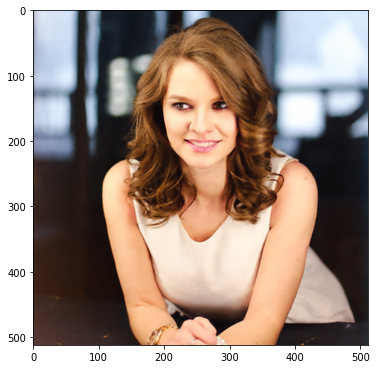

Iteration 04051    Loss 0.000190Iteration 04052    Loss 0.000164Iteration 04053    Loss 0.000170Iteration 04054    Loss 0.000181Iteration 04055    Loss 0.000197Iteration 04056    Loss 0.000184Iteration 04057    Loss 0.000163Iteration 04058    Loss 0.000170Iteration 04059    Loss 0.000179Iteration 04060    Loss 0.000185Iteration 04061    Loss 0.000181Iteration 04062    Loss 0.000162Iteration 04063    Loss 0.000170Iteration 04064    Loss 0.000188Iteration 04065    Loss 0.000177Iteration 04066    Loss 0.000176Iteration 04067    Loss 0.000173Iteration 04068    Loss 0.000177Iteration 04069    Loss 0.000171Iteration 04070    Loss 0.000158Iteration 04071    Loss 0.000165Iteration 04072    Loss 0.000178Iteration 04073    Loss 0.000185Iteration 04074    Loss 0.000177Iteration 04075    Loss 0.000173Iteration 04076    Loss 0.000174Iteration 04077    Loss 0.000182Iteration 04078    Loss 0.000180Iteration 04079    Loss 0.000163Iteration 04080    Loss 0.000170Iteration 04081    Loss 0.000189Iteratio

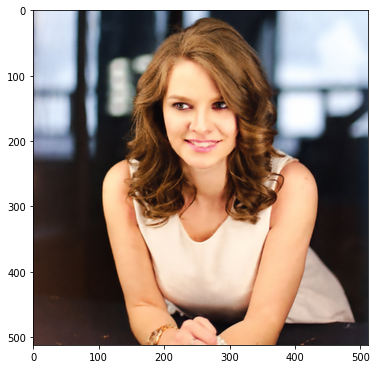

Iteration 04101    Loss 0.000178Iteration 04102    Loss 0.000189Iteration 04103    Loss 0.000194Iteration 04104    Loss 0.000181Iteration 04105    Loss 0.000174Iteration 04106    Loss 0.000182Iteration 04107    Loss 0.000176Iteration 04108    Loss 0.000162Iteration 04109    Loss 0.000167Iteration 04110    Loss 0.000181Iteration 04111    Loss 0.000185Iteration 04112    Loss 0.000179Iteration 04113    Loss 0.000176Iteration 04114    Loss 0.000168Iteration 04115    Loss 0.000162Iteration 04116    Loss 0.000154Iteration 04117    Loss 0.000165Iteration 04118    Loss 0.000165Iteration 04119    Loss 0.000163Iteration 04120    Loss 0.000159Iteration 04121    Loss 0.000160Iteration 04122    Loss 0.000159Iteration 04123    Loss 0.000168Iteration 04124    Loss 0.000165Iteration 04125    Loss 0.000156Iteration 04126    Loss 0.000157Iteration 04127    Loss 0.000162Iteration 04128    Loss 0.000162Iteration 04129    Loss 0.000149Iteration 04130    Loss 0.000157Iteration 04131    Loss 0.000168Iteratio

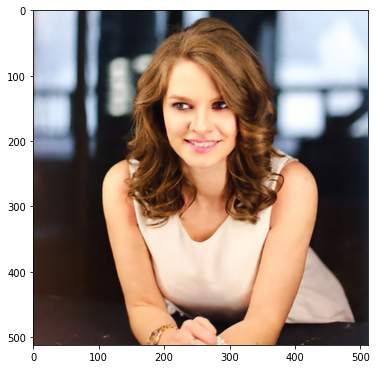

Iteration 04151    Loss 0.000160Iteration 04152    Loss 0.000157Iteration 04153    Loss 0.000155Iteration 04154    Loss 0.000153Iteration 04155    Loss 0.000152Iteration 04156    Loss 0.000155Iteration 04157    Loss 0.000155Iteration 04158    Loss 0.000157Iteration 04159    Loss 0.000160Iteration 04160    Loss 0.000166Iteration 04161    Loss 0.000161Iteration 04162    Loss 0.000152Iteration 04163    Loss 0.000153Iteration 04164    Loss 0.000158Iteration 04165    Loss 0.000156Iteration 04166    Loss 0.000157Iteration 04167    Loss 0.000156Iteration 04168    Loss 0.000158Iteration 04169    Loss 0.000156Iteration 04170    Loss 0.000154Iteration 04171    Loss 0.000154Iteration 04172    Loss 0.000152Iteration 04173    Loss 0.000154Iteration 04174    Loss 0.000161Iteration 04175    Loss 0.000165Iteration 04176    Loss 0.000158Iteration 04177    Loss 0.000148Iteration 04178    Loss 0.000151Iteration 04179    Loss 0.000169Iteration 04180    Loss 0.000179Iteration 04181    Loss 0.000163Iteratio

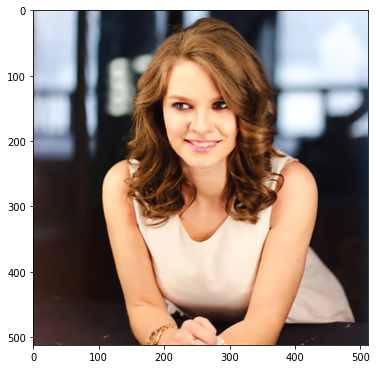

Iteration 04201    Loss 0.000153Iteration 04202    Loss 0.000157Iteration 04203    Loss 0.000164Iteration 04204    Loss 0.000176Iteration 04205    Loss 0.000188Iteration 04206    Loss 0.000200Iteration 04207    Loss 0.000207Iteration 04208    Loss 0.000217Iteration 04209    Loss 0.000198Iteration 04210    Loss 0.000177Iteration 04211    Loss 0.000160Iteration 04212    Loss 0.000161Iteration 04213    Loss 0.000162Iteration 04214    Loss 0.000161Iteration 04215    Loss 0.000163Iteration 04216    Loss 0.000169Iteration 04217    Loss 0.000160Iteration 04218    Loss 0.000152Iteration 04219    Loss 0.000167Iteration 04220    Loss 0.000177Iteration 04221    Loss 0.000169Iteration 04222    Loss 0.000151Iteration 04223    Loss 0.000157Iteration 04224    Loss 0.000161Iteration 04225    Loss 0.000156Iteration 04226    Loss 0.000152Iteration 04227    Loss 0.000152Iteration 04228    Loss 0.000162Iteration 04229    Loss 0.000158Iteration 04230    Loss 0.000157Iteration 04231    Loss 0.000153Iteratio

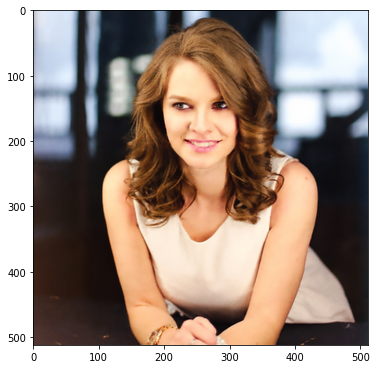

Iteration 04251    Loss 0.000161Iteration 04252    Loss 0.000172Iteration 04253    Loss 0.000175Iteration 04254    Loss 0.000171Iteration 04255    Loss 0.000162Iteration 04256    Loss 0.000150Iteration 04257    Loss 0.000149Iteration 04258    Loss 0.000151Iteration 04259    Loss 0.000156Iteration 04260    Loss 0.000160Iteration 04261    Loss 0.000165Iteration 04262    Loss 0.000155Iteration 04263    Loss 0.000152Iteration 04264    Loss 0.000146Iteration 04265    Loss 0.000150Iteration 04266    Loss 0.000150Iteration 04267    Loss 0.000152Iteration 04268    Loss 0.000160Iteration 04269    Loss 0.000153Iteration 04270    Loss 0.000151Iteration 04271    Loss 0.000155Iteration 04272    Loss 0.000156Iteration 04273    Loss 0.000157Iteration 04274    Loss 0.000159Iteration 04275    Loss 0.000152Iteration 04276    Loss 0.000147Iteration 04277    Loss 0.000156Iteration 04278    Loss 0.000163Iteration 04279    Loss 0.000169Iteration 04280    Loss 0.000172Iteration 04281    Loss 0.000168Iteratio

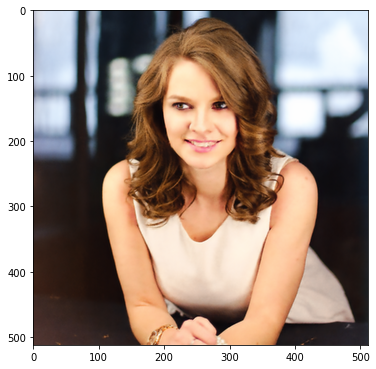

Iteration 04301    Loss 0.000148Iteration 04302    Loss 0.000147Iteration 04303    Loss 0.000144Iteration 04304    Loss 0.000148Iteration 04305    Loss 0.000159Iteration 04306    Loss 0.000174Iteration 04307    Loss 0.000191Iteration 04308    Loss 0.000205Iteration 04309    Loss 0.000193Iteration 04310    Loss 0.000179Iteration 04311    Loss 0.000166Iteration 04312    Loss 0.000178Iteration 04313    Loss 0.000184Iteration 04314    Loss 0.000168Iteration 04315    Loss 0.000151Iteration 04316    Loss 0.000164Iteration 04317    Loss 0.000189Iteration 04318    Loss 0.000209Iteration 04319    Loss 0.000183Iteration 04320    Loss 0.000161Iteration 04321    Loss 0.000159Iteration 04322    Loss 0.000163Iteration 04323    Loss 0.000160Iteration 04324    Loss 0.000162Iteration 04325    Loss 0.000148Iteration 04326    Loss 0.000150Iteration 04327    Loss 0.000155Iteration 04328    Loss 0.000150Iteration 04329    Loss 0.000151Iteration 04330    Loss 0.000147Iteration 04331    Loss 0.000149Iteratio

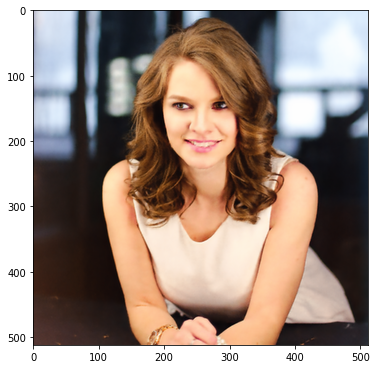

Iteration 04351    Loss 0.000162Iteration 04352    Loss 0.000159Iteration 04353    Loss 0.000155Iteration 04354    Loss 0.000150Iteration 04355    Loss 0.000157Iteration 04356    Loss 0.000154Iteration 04357    Loss 0.000147Iteration 04358    Loss 0.000153Iteration 04359    Loss 0.000158Iteration 04360    Loss 0.000163Iteration 04361    Loss 0.000150Iteration 04362    Loss 0.000145Iteration 04363    Loss 0.000154Iteration 04364    Loss 0.000160Iteration 04365    Loss 0.000157Iteration 04366    Loss 0.000155Iteration 04367    Loss 0.000148Iteration 04368    Loss 0.000149Iteration 04369    Loss 0.000148Iteration 04370    Loss 0.000160Iteration 04371    Loss 0.000158Iteration 04372    Loss 0.000156Iteration 04373    Loss 0.000147Iteration 04374    Loss 0.000145Iteration 04375    Loss 0.000154Iteration 04376    Loss 0.000158Iteration 04377    Loss 0.000167Iteration 04378    Loss 0.000172Iteration 04379    Loss 0.000160Iteration 04380    Loss 0.000153Iteration 04381    Loss 0.000143Iteratio

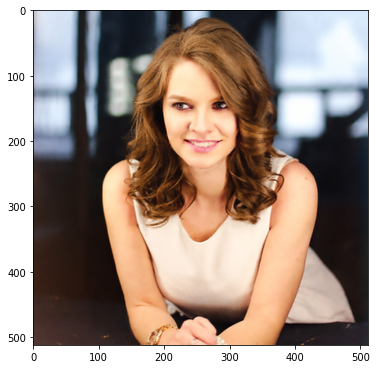

Iteration 04401    Loss 0.000152Iteration 04402    Loss 0.000155Iteration 04403    Loss 0.000150Iteration 04404    Loss 0.000145Iteration 04405    Loss 0.000147Iteration 04406    Loss 0.000153Iteration 04407    Loss 0.000148Iteration 04408    Loss 0.000149Iteration 04409    Loss 0.000143Iteration 04410    Loss 0.000143Iteration 04411    Loss 0.000141Iteration 04412    Loss 0.000142Iteration 04413    Loss 0.000146Iteration 04414    Loss 0.000149Iteration 04415    Loss 0.000146Iteration 04416    Loss 0.000152Iteration 04417    Loss 0.000162Iteration 04418    Loss 0.000178Iteration 04419    Loss 0.000192Iteration 04420    Loss 0.000193Iteration 04421    Loss 0.000205Iteration 04422    Loss 0.000198Iteration 04423    Loss 0.000196Iteration 04424    Loss 0.000191Iteration 04425    Loss 0.000178Iteration 04426    Loss 0.000174Iteration 04427    Loss 0.000172Iteration 04428    Loss 0.000155Iteration 04429    Loss 0.000147Iteration 04430    Loss 0.000147Iteration 04431    Loss 0.000149Iteratio

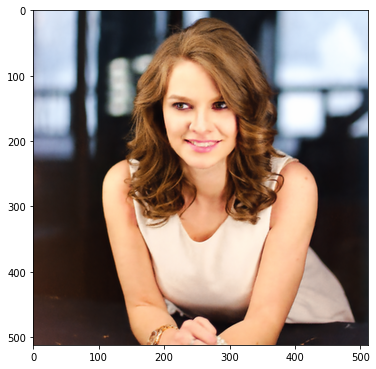

Iteration 04451    Loss 0.000178Iteration 04452    Loss 0.000166Iteration 04453    Loss 0.000157Iteration 04454    Loss 0.000140Iteration 04455    Loss 0.000146Iteration 04456    Loss 0.000164Iteration 04457    Loss 0.000176Iteration 04458    Loss 0.000168Iteration 04459    Loss 0.000155Iteration 04460    Loss 0.000142Iteration 04461    Loss 0.000144Iteration 04462    Loss 0.000163Iteration 04463    Loss 0.000173Iteration 04464    Loss 0.000173Iteration 04465    Loss 0.000161Iteration 04466    Loss 0.000151Iteration 04467    Loss 0.000159Iteration 04468    Loss 0.000156Iteration 04469    Loss 0.000151Iteration 04470    Loss 0.000148Iteration 04471    Loss 0.000144Iteration 04472    Loss 0.000150Iteration 04473    Loss 0.000151Iteration 04474    Loss 0.000145Iteration 04475    Loss 0.000138Iteration 04476    Loss 0.000143Iteration 04477    Loss 0.000147Iteration 04478    Loss 0.000147Iteration 04479    Loss 0.000142Iteration 04480    Loss 0.000138Iteration 04481    Loss 0.000143Iteratio

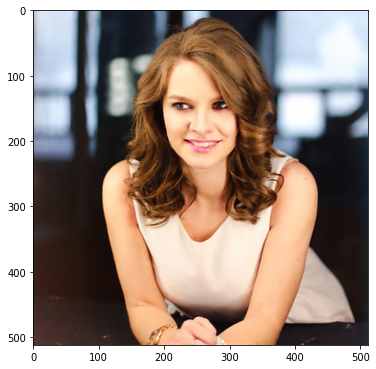

Iteration 04501    Loss 0.000140Iteration 04502    Loss 0.000143Iteration 04503    Loss 0.000144Iteration 04504    Loss 0.000137Iteration 04505    Loss 0.000139Iteration 04506    Loss 0.000143Iteration 04507    Loss 0.000144Iteration 04508    Loss 0.000144Iteration 04509    Loss 0.000140Iteration 04510    Loss 0.000143Iteration 04511    Loss 0.000141Iteration 04512    Loss 0.000144Iteration 04513    Loss 0.000145Iteration 04514    Loss 0.000144Iteration 04515    Loss 0.000148Iteration 04516    Loss 0.000145Iteration 04517    Loss 0.000147Iteration 04518    Loss 0.000140Iteration 04519    Loss 0.000144Iteration 04520    Loss 0.000139Iteration 04521    Loss 0.000147Iteration 04522    Loss 0.000137Iteration 04523    Loss 0.000143Iteration 04524    Loss 0.000142Iteration 04525    Loss 0.000142Iteration 04526    Loss 0.000146Iteration 04527    Loss 0.000149Iteration 04528    Loss 0.000149Iteration 04529    Loss 0.000155Iteration 04530    Loss 0.000157Iteration 04531    Loss 0.000164Iteratio

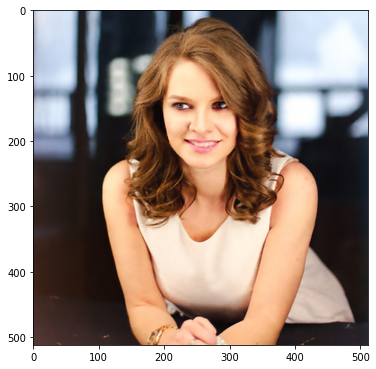

Iteration 04551    Loss 0.000140Iteration 04552    Loss 0.000136Iteration 04553    Loss 0.000139Iteration 04554    Loss 0.000137Iteration 04555    Loss 0.000134Iteration 04556    Loss 0.000139Iteration 04557    Loss 0.000138Iteration 04558    Loss 0.000144Iteration 04559    Loss 0.000147Iteration 04560    Loss 0.000142Iteration 04561    Loss 0.000140Iteration 04562    Loss 0.000139Iteration 04563    Loss 0.000141Iteration 04564    Loss 0.000142Iteration 04565    Loss 0.000140Iteration 04566    Loss 0.000140Iteration 04567    Loss 0.000156Iteration 04568    Loss 0.000166Iteration 04569    Loss 0.000180Iteration 04570    Loss 0.000182Iteration 04571    Loss 0.000174Iteration 04572    Loss 0.000157Iteration 04573    Loss 0.000155Iteration 04574    Loss 0.000178Iteration 04575    Loss 0.000204Iteration 04576    Loss 0.000203Iteration 04577    Loss 0.000167Iteration 04578    Loss 0.000138Iteration 04579    Loss 0.000158Iteration 04580    Loss 0.000184Iteration 04581    Loss 0.000172Iteratio

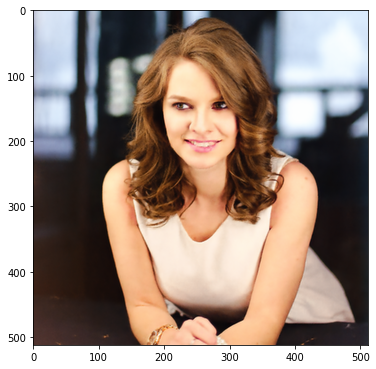

Iteration 04601    Loss 0.000167Iteration 04602    Loss 0.000152Iteration 04603    Loss 0.000150Iteration 04604    Loss 0.000149Iteration 04605    Loss 0.000149Iteration 04606    Loss 0.000146Iteration 04607    Loss 0.000154Iteration 04608    Loss 0.000155Iteration 04609    Loss 0.000141Iteration 04610    Loss 0.000141Iteration 04611    Loss 0.000152Iteration 04612    Loss 0.000156Iteration 04613    Loss 0.000154Iteration 04614    Loss 0.000154Iteration 04615    Loss 0.000149Iteration 04616    Loss 0.000151Iteration 04617    Loss 0.000145Iteration 04618    Loss 0.000148Iteration 04619    Loss 0.000147Iteration 04620    Loss 0.000145Iteration 04621    Loss 0.000137Iteration 04622    Loss 0.000135Iteration 04623    Loss 0.000138Iteration 04624    Loss 0.000141Iteration 04625    Loss 0.000142Iteration 04626    Loss 0.000138Iteration 04627    Loss 0.000137Iteration 04628    Loss 0.000136Iteration 04629    Loss 0.000144Iteration 04630    Loss 0.000147Iteration 04631    Loss 0.000152Iteratio

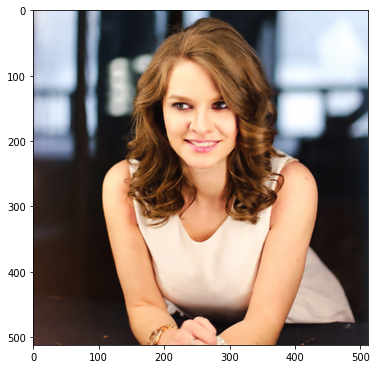

Iteration 04651    Loss 0.000133Iteration 04652    Loss 0.000134Iteration 04653    Loss 0.000133Iteration 04654    Loss 0.000141Iteration 04655    Loss 0.000141Iteration 04656    Loss 0.000139Iteration 04657    Loss 0.000139Iteration 04658    Loss 0.000135Iteration 04659    Loss 0.000133Iteration 04660    Loss 0.000134Iteration 04661    Loss 0.000136Iteration 04662    Loss 0.000141Iteration 04663    Loss 0.000149Iteration 04664    Loss 0.000149Iteration 04665    Loss 0.000145Iteration 04666    Loss 0.000138Iteration 04667    Loss 0.000134Iteration 04668    Loss 0.000138Iteration 04669    Loss 0.000139Iteration 04670    Loss 0.000140Iteration 04671    Loss 0.000145Iteration 04672    Loss 0.000144Iteration 04673    Loss 0.000140Iteration 04674    Loss 0.000139Iteration 04675    Loss 0.000137Iteration 04676    Loss 0.000133Iteration 04677    Loss 0.000139Iteration 04678    Loss 0.000146Iteration 04679    Loss 0.000144Iteration 04680    Loss 0.000134Iteration 04681    Loss 0.000136Iteratio

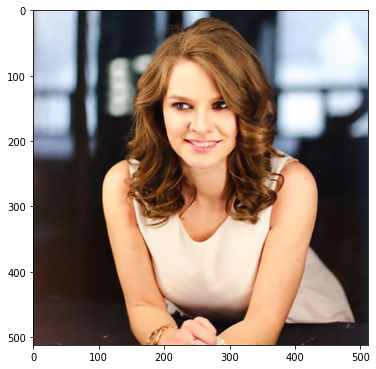

Iteration 04701    Loss 0.000144Iteration 04702    Loss 0.000148Iteration 04703    Loss 0.000146Iteration 04704    Loss 0.000148Iteration 04705    Loss 0.000140Iteration 04706    Loss 0.000134Iteration 04707    Loss 0.000136Iteration 04708    Loss 0.000138Iteration 04709    Loss 0.000144Iteration 04710    Loss 0.000140Iteration 04711    Loss 0.000143Iteration 04712    Loss 0.000141Iteration 04713    Loss 0.000143Iteration 04714    Loss 0.000148Iteration 04715    Loss 0.000145Iteration 04716    Loss 0.000139Iteration 04717    Loss 0.000133Iteration 04718    Loss 0.000133Iteration 04719    Loss 0.000135Iteration 04720    Loss 0.000135Iteration 04721    Loss 0.000129Iteration 04722    Loss 0.000132Iteration 04723    Loss 0.000131Iteration 04724    Loss 0.000130Iteration 04725    Loss 0.000138Iteration 04726    Loss 0.000142Iteration 04727    Loss 0.000143Iteration 04728    Loss 0.000136Iteration 04729    Loss 0.000130Iteration 04730    Loss 0.000136Iteration 04731    Loss 0.000134Iteratio

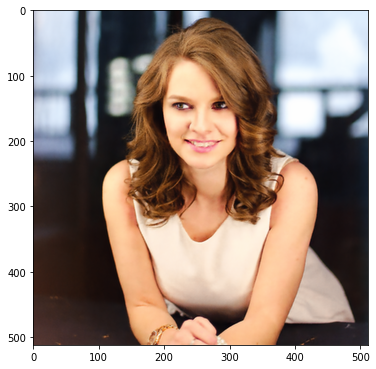

Iteration 04751    Loss 0.000130Iteration 04752    Loss 0.000129Iteration 04753    Loss 0.000130Iteration 04754    Loss 0.000136Iteration 04755    Loss 0.000135Iteration 04756    Loss 0.000140Iteration 04757    Loss 0.000135Iteration 04758    Loss 0.000136Iteration 04759    Loss 0.000138Iteration 04760    Loss 0.000144Iteration 04761    Loss 0.000145Iteration 04762    Loss 0.000138Iteration 04763    Loss 0.000136Iteration 04764    Loss 0.000135Iteration 04765    Loss 0.000141Iteration 04766    Loss 0.000135Iteration 04767    Loss 0.000131Iteration 04768    Loss 0.000133Iteration 04769    Loss 0.000138Iteration 04770    Loss 0.000135Iteration 04771    Loss 0.000138Iteration 04772    Loss 0.000131Iteration 04773    Loss 0.000134Iteration 04774    Loss 0.000139Iteration 04775    Loss 0.000132Iteration 04776    Loss 0.000143Iteration 04777    Loss 0.000147Iteration 04778    Loss 0.000153Iteration 04779    Loss 0.000169Iteration 04780    Loss 0.000174Iteration 04781    Loss 0.000171Iteratio

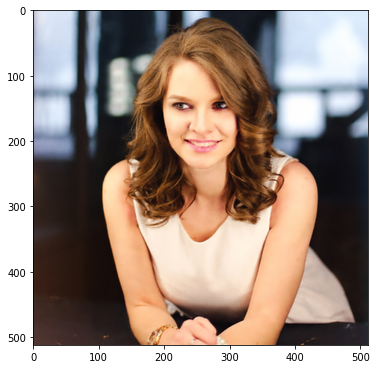

Iteration 04801    Loss 0.000147Iteration 04802    Loss 0.000139Iteration 04803    Loss 0.000132Iteration 04804    Loss 0.000131Iteration 04805    Loss 0.000137Iteration 04806    Loss 0.000143Iteration 04807    Loss 0.000148Iteration 04808    Loss 0.000147Iteration 04809    Loss 0.000145Iteration 04810    Loss 0.000132Iteration 04811    Loss 0.000130Iteration 04812    Loss 0.000130Iteration 04813    Loss 0.000130Iteration 04814    Loss 0.000136Iteration 04815    Loss 0.000129Iteration 04816    Loss 0.000127Iteration 04817    Loss 0.000130Iteration 04818    Loss 0.000133Iteration 04819    Loss 0.000138Iteration 04820    Loss 0.000136Iteration 04821    Loss 0.000133Iteration 04822    Loss 0.000132Iteration 04823    Loss 0.000138Iteration 04824    Loss 0.000144Iteration 04825    Loss 0.000143Iteration 04826    Loss 0.000134Iteration 04827    Loss 0.000132Iteration 04828    Loss 0.000136Iteration 04829    Loss 0.000138Iteration 04830    Loss 0.000138Iteration 04831    Loss 0.000138Iteratio

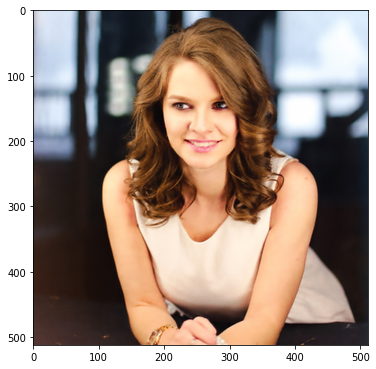

Iteration 04851    Loss 0.000132Iteration 04852    Loss 0.000130Iteration 04853    Loss 0.000125Iteration 04854    Loss 0.000131Iteration 04855    Loss 0.000127Iteration 04856    Loss 0.000134Iteration 04857    Loss 0.000129Iteration 04858    Loss 0.000126Iteration 04859    Loss 0.000128Iteration 04860    Loss 0.000132Iteration 04861    Loss 0.000128Iteration 04862    Loss 0.000134Iteration 04863    Loss 0.000134Iteration 04864    Loss 0.000131Iteration 04865    Loss 0.000134Iteration 04866    Loss 0.000138Iteration 04867    Loss 0.000133Iteration 04868    Loss 0.000137Iteration 04869    Loss 0.000139Iteration 04870    Loss 0.000143Iteration 04871    Loss 0.000145Iteration 04872    Loss 0.000147Iteration 04873    Loss 0.000150Iteration 04874    Loss 0.000140Iteration 04875    Loss 0.000137Iteration 04876    Loss 0.000130Iteration 04877    Loss 0.000136Iteration 04878    Loss 0.000148Iteration 04879    Loss 0.000151Iteration 04880    Loss 0.000150Iteration 04881    Loss 0.000145Iteratio

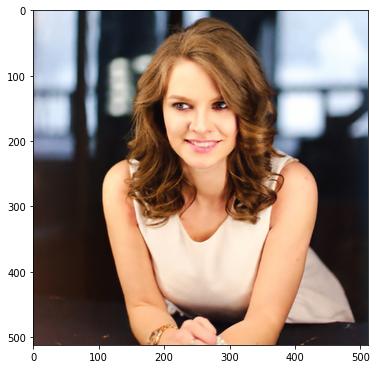

Iteration 04901    Loss 0.000133Iteration 04902    Loss 0.000125Iteration 04903    Loss 0.000127Iteration 04904    Loss 0.000134Iteration 04905    Loss 0.000133Iteration 04906    Loss 0.000129Iteration 04907    Loss 0.000123Iteration 04908    Loss 0.000131Iteration 04909    Loss 0.000144Iteration 04910    Loss 0.000139Iteration 04911    Loss 0.000133Iteration 04912    Loss 0.000128Iteration 04913    Loss 0.000129Iteration 04914    Loss 0.000127Iteration 04915    Loss 0.000131Iteration 04916    Loss 0.000137Iteration 04917    Loss 0.000141Iteration 04918    Loss 0.000147Iteration 04919    Loss 0.000156Iteration 04920    Loss 0.000154Iteration 04921    Loss 0.000170Iteration 04922    Loss 0.000176Iteration 04923    Loss 0.000168Iteration 04924    Loss 0.000145Iteration 04925    Loss 0.000129Iteration 04926    Loss 0.000131Iteration 04927    Loss 0.000136Iteration 04928    Loss 0.000135Iteration 04929    Loss 0.000137Iteration 04930    Loss 0.000138Iteration 04931    Loss 0.000139Iteratio

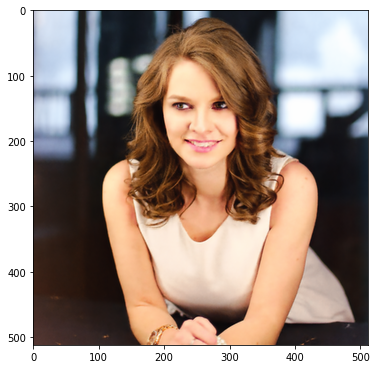

Iteration 04951    Loss 0.000151Iteration 04952    Loss 0.000147Iteration 04953    Loss 0.000144Iteration 04954    Loss 0.000123Iteration 04955    Loss 0.000128Iteration 04956    Loss 0.000129Iteration 04957    Loss 0.000130Iteration 04958    Loss 0.000132Iteration 04959    Loss 0.000130Iteration 04960    Loss 0.000126Iteration 04961    Loss 0.000127Iteration 04962    Loss 0.000125Iteration 04963    Loss 0.000128Iteration 04964    Loss 0.000126Iteration 04965    Loss 0.000129Iteration 04966    Loss 0.000131Iteration 04967    Loss 0.000124Iteration 04968    Loss 0.000121Iteration 04969    Loss 0.000123Iteration 04970    Loss 0.000124Iteration 04971    Loss 0.000124Iteration 04972    Loss 0.000125Iteration 04973    Loss 0.000122Iteration 04974    Loss 0.000124Iteration 04975    Loss 0.000126Iteration 04976    Loss 0.000125Iteration 04977    Loss 0.000126Iteration 04978    Loss 0.000125Iteration 04979    Loss 0.000131Iteration 04980    Loss 0.000134Iteration 04981    Loss 0.000135Iteratio

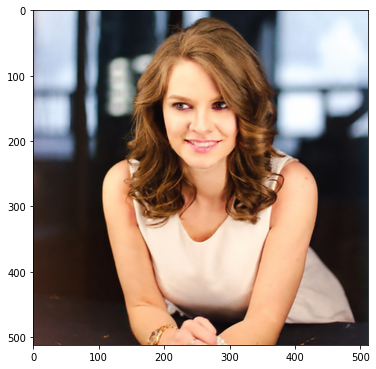

Iteration 05001    Loss 0.000130Iteration 05002    Loss 0.000126Iteration 05003    Loss 0.000126Iteration 05004    Loss 0.000121Iteration 05005    Loss 0.000123Iteration 05006    Loss 0.000124Iteration 05007    Loss 0.000124Iteration 05008    Loss 0.000124Iteration 05009    Loss 0.000123Iteration 05010    Loss 0.000121Iteration 05011    Loss 0.000121Iteration 05012    Loss 0.000121Iteration 05013    Loss 0.000122Iteration 05014    Loss 0.000121Iteration 05015    Loss 0.000125Iteration 05016    Loss 0.000124Iteration 05017    Loss 0.000133Iteration 05018    Loss 0.000133Iteration 05019    Loss 0.000140Iteration 05020    Loss 0.000152Iteration 05021    Loss 0.000165Iteration 05022    Loss 0.000176Iteration 05023    Loss 0.000171Iteration 05024    Loss 0.000162Iteration 05025    Loss 0.000141Iteration 05026    Loss 0.000133Iteration 05027    Loss 0.000135Iteration 05028    Loss 0.000139Iteration 05029    Loss 0.000134Iteration 05030    Loss 0.000125Iteration 05031    Loss 0.000128Iteratio

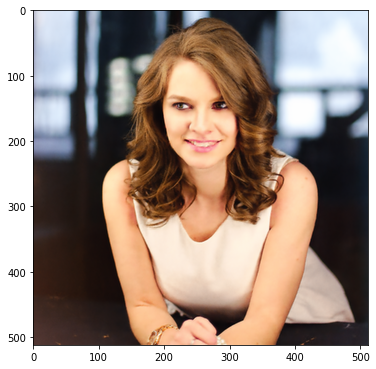

Iteration 05051    Loss 0.000129Iteration 05052    Loss 0.000137Iteration 05053    Loss 0.000135Iteration 05054    Loss 0.000134Iteration 05055    Loss 0.000134Iteration 05056    Loss 0.000134Iteration 05057    Loss 0.000132Iteration 05058    Loss 0.000128Iteration 05059    Loss 0.000128Iteration 05060    Loss 0.000126Iteration 05061    Loss 0.000119Iteration 05062    Loss 0.000120Iteration 05063    Loss 0.000124Iteration 05064    Loss 0.000133Iteration 05065    Loss 0.000141Iteration 05066    Loss 0.000140Iteration 05067    Loss 0.000137Iteration 05068    Loss 0.000142Iteration 05069    Loss 0.000150Iteration 05070    Loss 0.000140Iteration 05071    Loss 0.000138Iteration 05072    Loss 0.000129Iteration 05073    Loss 0.000123Iteration 05074    Loss 0.000132Iteration 05075    Loss 0.000135Iteration 05076    Loss 0.000137Iteration 05077    Loss 0.000135Iteration 05078    Loss 0.000134Iteration 05079    Loss 0.000134Iteration 05080    Loss 0.000130Iteration 05081    Loss 0.000128Iteratio

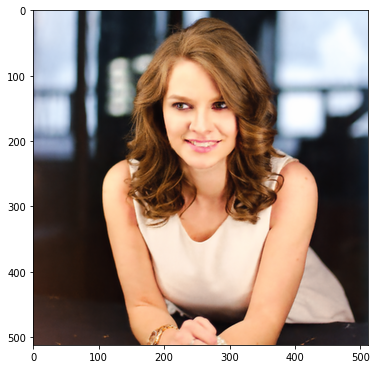

Iteration 05101    Loss 0.000137Iteration 05102    Loss 0.000132Iteration 05103    Loss 0.000126Iteration 05104    Loss 0.000124Iteration 05105    Loss 0.000136Iteration 05106    Loss 0.000142Iteration 05107    Loss 0.000139Iteration 05108    Loss 0.000130Iteration 05109    Loss 0.000118Iteration 05110    Loss 0.000122Iteration 05111    Loss 0.000126Iteration 05112    Loss 0.000126Iteration 05113    Loss 0.000125Iteration 05114    Loss 0.000124Iteration 05115    Loss 0.000122Iteration 05116    Loss 0.000120Iteration 05117    Loss 0.000120Iteration 05118    Loss 0.000119Iteration 05119    Loss 0.000123Iteration 05120    Loss 0.000122Iteration 05121    Loss 0.000128Iteration 05122    Loss 0.000124Iteration 05123    Loss 0.000129Iteration 05124    Loss 0.000127Iteration 05125    Loss 0.000123Iteration 05126    Loss 0.000122Iteration 05127    Loss 0.000117Iteration 05128    Loss 0.000117Iteration 05129    Loss 0.000117Iteration 05130    Loss 0.000122Iteration 05131    Loss 0.000120Iteratio

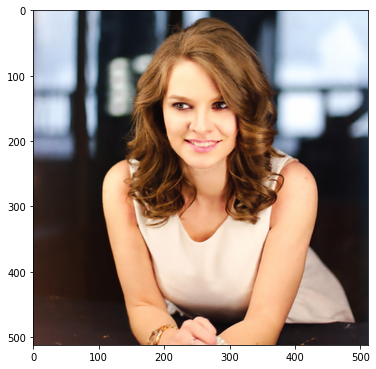

Iteration 05151    Loss 0.000122Iteration 05152    Loss 0.000121Iteration 05153    Loss 0.000119Iteration 05154    Loss 0.000120Iteration 05155    Loss 0.000121Iteration 05156    Loss 0.000122Iteration 05157    Loss 0.000119Iteration 05158    Loss 0.000119Iteration 05159    Loss 0.000117Iteration 05160    Loss 0.000115Iteration 05161    Loss 0.000114Iteration 05162    Loss 0.000118Iteration 05163    Loss 0.000121Iteration 05164    Loss 0.000126Iteration 05165    Loss 0.000126Iteration 05166    Loss 0.000119Iteration 05167    Loss 0.000120Iteration 05168    Loss 0.000113Iteration 05169    Loss 0.000117Iteration 05170    Loss 0.000122Iteration 05171    Loss 0.000117Iteration 05172    Loss 0.000126Iteration 05173    Loss 0.000133Iteration 05174    Loss 0.000136Iteration 05175    Loss 0.000151Iteration 05176    Loss 0.000176Iteration 05177    Loss 0.000192Iteration 05178    Loss 0.000209Iteration 05179    Loss 0.000205Iteration 05180    Loss 0.000208Iteration 05181    Loss 0.000198Iteratio

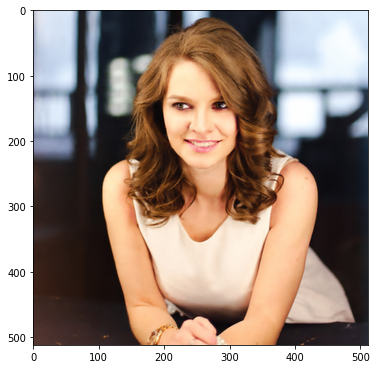

Iteration 05201    Loss 0.000129Iteration 05202    Loss 0.000131Iteration 05203    Loss 0.000125Iteration 05204    Loss 0.000118Iteration 05205    Loss 0.000123Iteration 05206    Loss 0.000120Iteration 05207    Loss 0.000118Iteration 05208    Loss 0.000124Iteration 05209    Loss 0.000123Iteration 05210    Loss 0.000124Iteration 05211    Loss 0.000125Iteration 05212    Loss 0.000125Iteration 05213    Loss 0.000125Iteration 05214    Loss 0.000123Iteration 05215    Loss 0.000121Iteration 05216    Loss 0.000124Iteration 05217    Loss 0.000127Iteration 05218    Loss 0.000129Iteration 05219    Loss 0.000128Iteration 05220    Loss 0.000118Iteration 05221    Loss 0.000118Iteration 05222    Loss 0.000118Iteration 05223    Loss 0.000121Iteration 05224    Loss 0.000122Iteration 05225    Loss 0.000119Iteration 05226    Loss 0.000116Iteration 05227    Loss 0.000122Iteration 05228    Loss 0.000125Iteration 05229    Loss 0.000128Iteration 05230    Loss 0.000122Iteration 05231    Loss 0.000118Iteratio

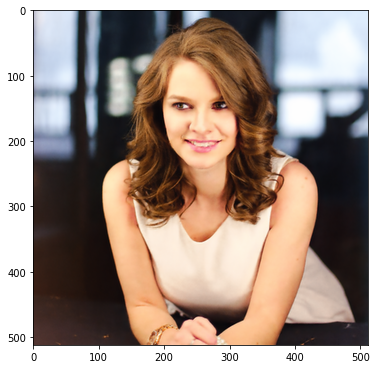

Iteration 05251    Loss 0.000130Iteration 05252    Loss 0.000132Iteration 05253    Loss 0.000133Iteration 05254    Loss 0.000129Iteration 05255    Loss 0.000130Iteration 05256    Loss 0.000138Iteration 05257    Loss 0.000143Iteration 05258    Loss 0.000132Iteration 05259    Loss 0.000118Iteration 05260    Loss 0.000120Iteration 05261    Loss 0.000125Iteration 05262    Loss 0.000136Iteration 05263    Loss 0.000135Iteration 05264    Loss 0.000129Iteration 05265    Loss 0.000120Iteration 05266    Loss 0.000125Iteration 05267    Loss 0.000125Iteration 05268    Loss 0.000127Iteration 05269    Loss 0.000120Iteration 05270    Loss 0.000122Iteration 05271    Loss 0.000126Iteration 05272    Loss 0.000126Iteration 05273    Loss 0.000120Iteration 05274    Loss 0.000114Iteration 05275    Loss 0.000122Iteration 05276    Loss 0.000120Iteration 05277    Loss 0.000115Iteration 05278    Loss 0.000115Iteration 05279    Loss 0.000115Iteration 05280    Loss 0.000118Iteration 05281    Loss 0.000123Iteratio

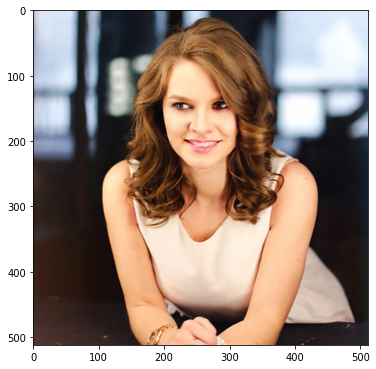

Iteration 05301    Loss 0.000120Iteration 05302    Loss 0.000121Iteration 05303    Loss 0.000129Iteration 05304    Loss 0.000124Iteration 05305    Loss 0.000123Iteration 05306    Loss 0.000122Iteration 05307    Loss 0.000116Iteration 05308    Loss 0.000115Iteration 05309    Loss 0.000118Iteration 05310    Loss 0.000121Iteration 05311    Loss 0.000127Iteration 05312    Loss 0.000135Iteration 05313    Loss 0.000129Iteration 05314    Loss 0.000125Iteration 05315    Loss 0.000124Iteration 05316    Loss 0.000129Iteration 05317    Loss 0.000127Iteration 05318    Loss 0.000124Iteration 05319    Loss 0.000122Iteration 05320    Loss 0.000123Iteration 05321    Loss 0.000125Iteration 05322    Loss 0.000124Iteration 05323    Loss 0.000114Iteration 05324    Loss 0.000115Iteration 05325    Loss 0.000122Iteration 05326    Loss 0.000124Iteration 05327    Loss 0.000130Iteration 05328    Loss 0.000124Iteration 05329    Loss 0.000123Iteration 05330    Loss 0.000126Iteration 05331    Loss 0.000125Iteratio

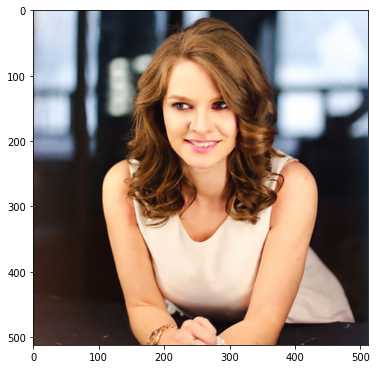

Iteration 05351    Loss 0.000116Iteration 05352    Loss 0.000110Iteration 05353    Loss 0.000110Iteration 05354    Loss 0.000117Iteration 05355    Loss 0.000126Iteration 05356    Loss 0.000142Iteration 05357    Loss 0.000147Iteration 05358    Loss 0.000142Iteration 05359    Loss 0.000122Iteration 05360    Loss 0.000111Iteration 05361    Loss 0.000114Iteration 05362    Loss 0.000122Iteration 05363    Loss 0.000136Iteration 05364    Loss 0.000141Iteration 05365    Loss 0.000129Iteration 05366    Loss 0.000116Iteration 05367    Loss 0.000110Iteration 05368    Loss 0.000117Iteration 05369    Loss 0.000124Iteration 05370    Loss 0.000120Iteration 05371    Loss 0.000118Iteration 05372    Loss 0.000117Iteration 05373    Loss 0.000127Iteration 05374    Loss 0.000142Iteration 05375    Loss 0.000162Iteration 05376    Loss 0.000164Iteration 05377    Loss 0.000163Iteration 05378    Loss 0.000146Iteration 05379    Loss 0.000124Iteration 05380    Loss 0.000115Iteration 05381    Loss 0.000114Iteratio

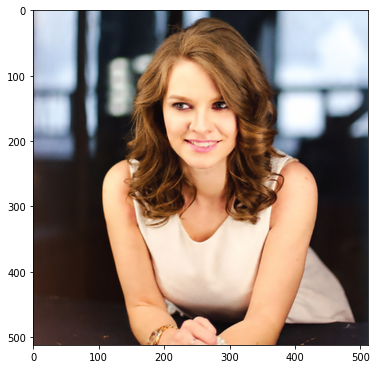

Iteration 05401    Loss 0.000113Iteration 05402    Loss 0.000120Iteration 05403    Loss 0.000122Iteration 05404    Loss 0.000126Iteration 05405    Loss 0.000123Iteration 05406    Loss 0.000120Iteration 05407    Loss 0.000114Iteration 05408    Loss 0.000126Iteration 05409    Loss 0.000134Iteration 05410    Loss 0.000124Iteration 05411    Loss 0.000114Iteration 05412    Loss 0.000116Iteration 05413    Loss 0.000124Iteration 05414    Loss 0.000136Iteration 05415    Loss 0.000142Iteration 05416    Loss 0.000127Iteration 05417    Loss 0.000120Iteration 05418    Loss 0.000118Iteration 05419    Loss 0.000117Iteration 05420    Loss 0.000119Iteration 05421    Loss 0.000117Iteration 05422    Loss 0.000115Iteration 05423    Loss 0.000116Iteration 05424    Loss 0.000115Iteration 05425    Loss 0.000114Iteration 05426    Loss 0.000113Iteration 05427    Loss 0.000119Iteration 05428    Loss 0.000120Iteration 05429    Loss 0.000125Iteration 05430    Loss 0.000121Iteration 05431    Loss 0.000116Iteratio

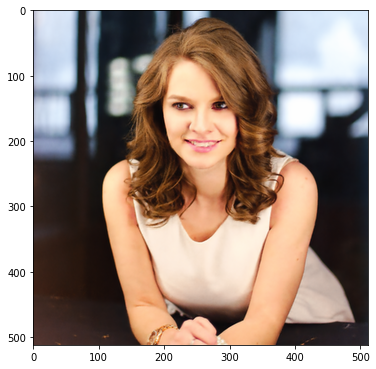

Iteration 05451    Loss 0.000109Iteration 05452    Loss 0.000110Iteration 05453    Loss 0.000115Iteration 05454    Loss 0.000117Iteration 05455    Loss 0.000115Iteration 05456    Loss 0.000111Iteration 05457    Loss 0.000110Iteration 05458    Loss 0.000110Iteration 05459    Loss 0.000111Iteration 05460    Loss 0.000112Iteration 05461    Loss 0.000113Iteration 05462    Loss 0.000110Iteration 05463    Loss 0.000108Iteration 05464    Loss 0.000109Iteration 05465    Loss 0.000114Iteration 05466    Loss 0.000120Iteration 05467    Loss 0.000125Iteration 05468    Loss 0.000128Iteration 05469    Loss 0.000131Iteration 05470    Loss 0.000125Iteration 05471    Loss 0.000113Iteration 05472    Loss 0.000106Iteration 05473    Loss 0.000114Iteration 05474    Loss 0.000117Iteration 05475    Loss 0.000122Iteration 05476    Loss 0.000127Iteration 05477    Loss 0.000134Iteration 05478    Loss 0.000139Iteration 05479    Loss 0.000140Iteration 05480    Loss 0.000130Iteration 05481    Loss 0.000122Iteratio

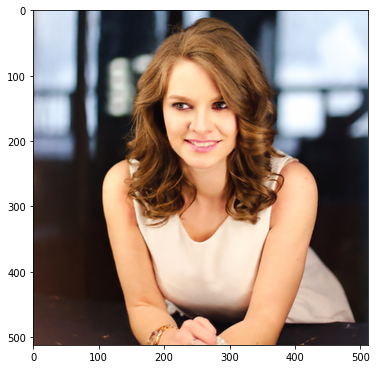

Iteration 05501    Loss 0.000158Iteration 05502    Loss 0.000155Iteration 05503    Loss 0.000142Iteration 05504    Loss 0.000122Iteration 05505    Loss 0.000122Iteration 05506    Loss 0.000128Iteration 05507    Loss 0.000125Iteration 05508    Loss 0.000125Iteration 05509    Loss 0.000114Iteration 05510    Loss 0.000119Iteration 05511    Loss 0.000127Iteration 05512    Loss 0.000118Iteration 05513    Loss 0.000118Iteration 05514    Loss 0.000120Iteration 05515    Loss 0.000118Iteration 05516    Loss 0.000124Iteration 05517    Loss 0.000118Iteration 05518    Loss 0.000115Iteration 05519    Loss 0.000116Iteration 05520    Loss 0.000116Iteration 05521    Loss 0.000112Iteration 05522    Loss 0.000108Iteration 05523    Loss 0.000115Iteration 05524    Loss 0.000115Iteration 05525    Loss 0.000113Iteration 05526    Loss 0.000114Iteration 05527    Loss 0.000110Iteration 05528    Loss 0.000114Iteration 05529    Loss 0.000116Iteration 05530    Loss 0.000111Iteration 05531    Loss 0.000110Iteratio

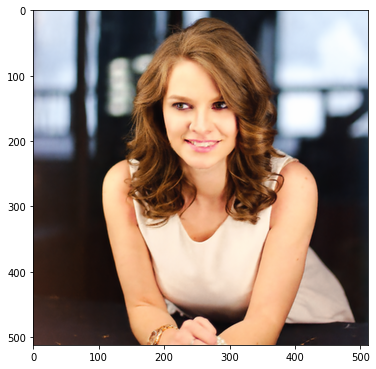

Iteration 05551    Loss 0.000113Iteration 05552    Loss 0.000109Iteration 05553    Loss 0.000113Iteration 05554    Loss 0.000120Iteration 05555    Loss 0.000124Iteration 05556    Loss 0.000113Iteration 05557    Loss 0.000109Iteration 05558    Loss 0.000109Iteration 05559    Loss 0.000113Iteration 05560    Loss 0.000114Iteration 05561    Loss 0.000112Iteration 05562    Loss 0.000108Iteration 05563    Loss 0.000115Iteration 05564    Loss 0.000116Iteration 05565    Loss 0.000118Iteration 05566    Loss 0.000115Iteration 05567    Loss 0.000113Iteration 05568    Loss 0.000108Iteration 05569    Loss 0.000111Iteration 05570    Loss 0.000112Iteration 05571    Loss 0.000109Iteration 05572    Loss 0.000108Iteration 05573    Loss 0.000109Iteration 05574    Loss 0.000107Iteration 05575    Loss 0.000107Iteration 05576    Loss 0.000109Iteration 05577    Loss 0.000107Iteration 05578    Loss 0.000105Iteration 05579    Loss 0.000108Iteration 05580    Loss 0.000106Iteration 05581    Loss 0.000110Iteratio

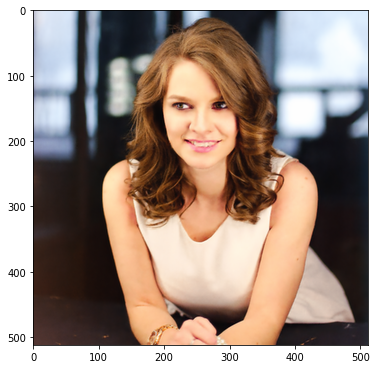

Iteration 05601    Loss 0.000116Iteration 05602    Loss 0.000118Iteration 05603    Loss 0.000117Iteration 05604    Loss 0.000117Iteration 05605    Loss 0.000116Iteration 05606    Loss 0.000122Iteration 05607    Loss 0.000128Iteration 05608    Loss 0.000134Iteration 05609    Loss 0.000125Iteration 05610    Loss 0.000118Iteration 05611    Loss 0.000109Iteration 05612    Loss 0.000108Iteration 05613    Loss 0.000112Iteration 05614    Loss 0.000114Iteration 05615    Loss 0.000114Iteration 05616    Loss 0.000111Iteration 05617    Loss 0.000108Iteration 05618    Loss 0.000110Iteration 05619    Loss 0.000112Iteration 05620    Loss 0.000114Iteration 05621    Loss 0.000119Iteration 05622    Loss 0.000124Iteration 05623    Loss 0.000131Iteration 05624    Loss 0.000138Iteration 05625    Loss 0.000143Iteration 05626    Loss 0.000136Iteration 05627    Loss 0.000122Iteration 05628    Loss 0.000117Iteration 05629    Loss 0.000115Iteration 05630    Loss 0.000120Iteration 05631    Loss 0.000118Iteratio

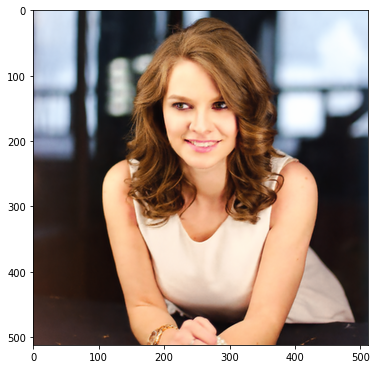

Iteration 05651    Loss 0.000112Iteration 05652    Loss 0.000112Iteration 05653    Loss 0.000115Iteration 05654    Loss 0.000107Iteration 05655    Loss 0.000109Iteration 05656    Loss 0.000110Iteration 05657    Loss 0.000109Iteration 05658    Loss 0.000108Iteration 05659    Loss 0.000106Iteration 05660    Loss 0.000106Iteration 05661    Loss 0.000109Iteration 05662    Loss 0.000112Iteration 05663    Loss 0.000112Iteration 05664    Loss 0.000111Iteration 05665    Loss 0.000108Iteration 05666    Loss 0.000111Iteration 05667    Loss 0.000105Iteration 05668    Loss 0.000104Iteration 05669    Loss 0.000109Iteration 05670    Loss 0.000109Iteration 05671    Loss 0.000113Iteration 05672    Loss 0.000118Iteration 05673    Loss 0.000125Iteration 05674    Loss 0.000123Iteration 05675    Loss 0.000127Iteration 05676    Loss 0.000127Iteration 05677    Loss 0.000121Iteration 05678    Loss 0.000116Iteration 05679    Loss 0.000110Iteration 05680    Loss 0.000107Iteration 05681    Loss 0.000115Iteratio

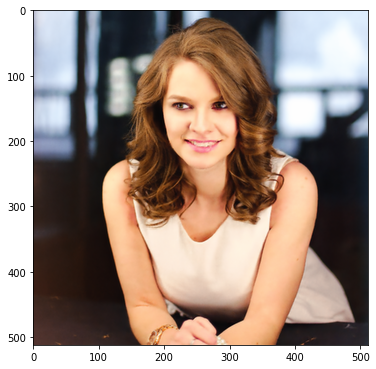

Iteration 05701    Loss 0.000120Iteration 05702    Loss 0.000120Iteration 05703    Loss 0.000118Iteration 05704    Loss 0.000106Iteration 05705    Loss 0.000110Iteration 05706    Loss 0.000108Iteration 05707    Loss 0.000113Iteration 05708    Loss 0.000114Iteration 05709    Loss 0.000110Iteration 05710    Loss 0.000103Iteration 05711    Loss 0.000103Iteration 05712    Loss 0.000103Iteration 05713    Loss 0.000104Iteration 05714    Loss 0.000104Iteration 05715    Loss 0.000108Iteration 05716    Loss 0.000108Iteration 05717    Loss 0.000110Iteration 05718    Loss 0.000112Iteration 05719    Loss 0.000114Iteration 05720    Loss 0.000111Iteration 05721    Loss 0.000108Iteration 05722    Loss 0.000102Iteration 05723    Loss 0.000102Iteration 05724    Loss 0.000109Iteration 05725    Loss 0.000115Iteration 05726    Loss 0.000125Iteration 05727    Loss 0.000129Iteration 05728    Loss 0.000120Iteration 05729    Loss 0.000109Iteration 05730    Loss 0.000103Iteration 05731    Loss 0.000109Iteratio

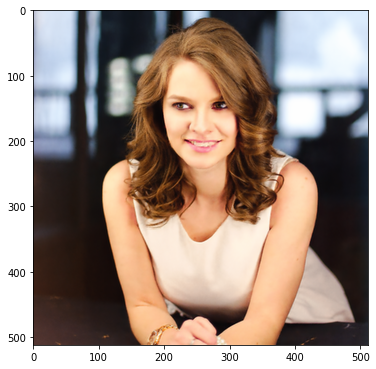

Iteration 05751    Loss 0.000115Iteration 05752    Loss 0.000107Iteration 05753    Loss 0.000099Iteration 05754    Loss 0.000105Iteration 05755    Loss 0.000108Iteration 05756    Loss 0.000110Iteration 05757    Loss 0.000109Iteration 05758    Loss 0.000105Iteration 05759    Loss 0.000099Iteration 05760    Loss 0.000102Iteration 05761    Loss 0.000103Iteration 05762    Loss 0.000109Iteration 05763    Loss 0.000112Iteration 05764    Loss 0.000117Iteration 05765    Loss 0.000125Iteration 05766    Loss 0.000134Iteration 05767    Loss 0.000136Iteration 05768    Loss 0.000132Iteration 05769    Loss 0.000124Iteration 05770    Loss 0.000112Iteration 05771    Loss 0.000107Iteration 05772    Loss 0.000111Iteration 05773    Loss 0.000113Iteration 05774    Loss 0.000116Iteration 05775    Loss 0.000114Iteration 05776    Loss 0.000108Iteration 05777    Loss 0.000111Iteration 05778    Loss 0.000116Iteration 05779    Loss 0.000111Iteration 05780    Loss 0.000107Iteration 05781    Loss 0.000108Iteratio

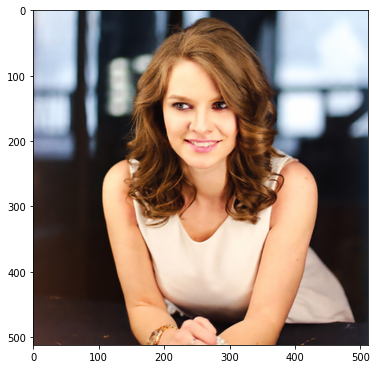

Iteration 05801    Loss 0.000117Iteration 05802    Loss 0.000125Iteration 05803    Loss 0.000125Iteration 05804    Loss 0.000116Iteration 05805    Loss 0.000110Iteration 05806    Loss 0.000109Iteration 05807    Loss 0.000112Iteration 05808    Loss 0.000114Iteration 05809    Loss 0.000118Iteration 05810    Loss 0.000117Iteration 05811    Loss 0.000112Iteration 05812    Loss 0.000107Iteration 05813    Loss 0.000107Iteration 05814    Loss 0.000110Iteration 05815    Loss 0.000112Iteration 05816    Loss 0.000107Iteration 05817    Loss 0.000105Iteration 05818    Loss 0.000101Iteration 05819    Loss 0.000101Iteration 05820    Loss 0.000111Iteration 05821    Loss 0.000116Iteration 05822    Loss 0.000121Iteration 05823    Loss 0.000124Iteration 05824    Loss 0.000114Iteration 05825    Loss 0.000101Iteration 05826    Loss 0.000104Iteration 05827    Loss 0.000113Iteration 05828    Loss 0.000115Iteration 05829    Loss 0.000115Iteration 05830    Loss 0.000114Iteration 05831    Loss 0.000109Iteratio

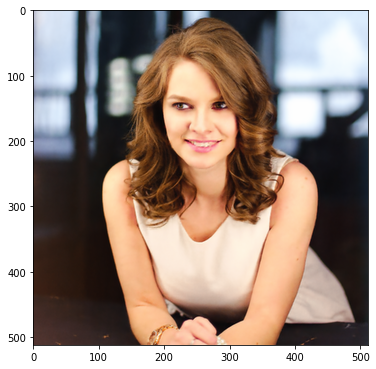

Iteration 05851    Loss 0.000103Iteration 05852    Loss 0.000105Iteration 05853    Loss 0.000103Iteration 05854    Loss 0.000100Iteration 05855    Loss 0.000103Iteration 05856    Loss 0.000106Iteration 05857    Loss 0.000109Iteration 05858    Loss 0.000114Iteration 05859    Loss 0.000117Iteration 05860    Loss 0.000110Iteration 05861    Loss 0.000106Iteration 05862    Loss 0.000105Iteration 05863    Loss 0.000106Iteration 05864    Loss 0.000105Iteration 05865    Loss 0.000101Iteration 05866    Loss 0.000100Iteration 05867    Loss 0.000100Iteration 05868    Loss 0.000101Iteration 05869    Loss 0.000102Iteration 05870    Loss 0.000098Iteration 05871    Loss 0.000105Iteration 05872    Loss 0.000109Iteration 05873    Loss 0.000112Iteration 05874    Loss 0.000108Iteration 05875    Loss 0.000108Iteration 05876    Loss 0.000107Iteration 05877    Loss 0.000102Iteration 05878    Loss 0.000097Iteration 05879    Loss 0.000102Iteration 05880    Loss 0.000099Iteration 05881    Loss 0.000099Iteratio

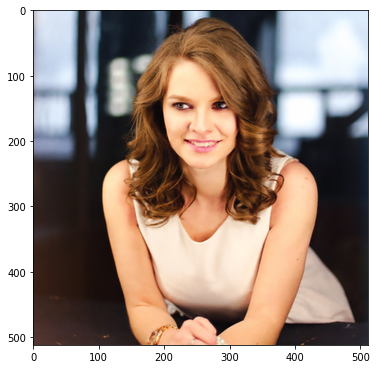

Iteration 05901    Loss 0.000127Iteration 05902    Loss 0.000135Iteration 05903    Loss 0.000145Iteration 05904    Loss 0.000168Iteration 05905    Loss 0.000171Iteration 05906    Loss 0.000169Iteration 05907    Loss 0.000161Iteration 05908    Loss 0.000145Iteration 05909    Loss 0.000118Iteration 05910    Loss 0.000115Iteration 05911    Loss 0.000124Iteration 05912    Loss 0.000125Iteration 05913    Loss 0.000112Iteration 05914    Loss 0.000109Iteration 05915    Loss 0.000102Iteration 05916    Loss 0.000111Iteration 05917    Loss 0.000114Iteration 05918    Loss 0.000110Iteration 05919    Loss 0.000101Iteration 05920    Loss 0.000108Iteration 05921    Loss 0.000114Iteration 05922    Loss 0.000105Iteration 05923    Loss 0.000099Iteration 05924    Loss 0.000102Iteration 05925    Loss 0.000107Iteration 05926    Loss 0.000111Iteration 05927    Loss 0.000113Iteration 05928    Loss 0.000113Iteration 05929    Loss 0.000109Iteration 05930    Loss 0.000108Iteration 05931    Loss 0.000103Iteratio

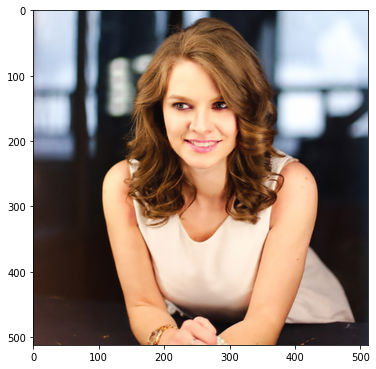

Iteration 05951    Loss 0.000101Iteration 05952    Loss 0.000102Iteration 05953    Loss 0.000108Iteration 05954    Loss 0.000112Iteration 05955    Loss 0.000107Iteration 05956    Loss 0.000105Iteration 05957    Loss 0.000104Iteration 05958    Loss 0.000108Iteration 05959    Loss 0.000114Iteration 05960    Loss 0.000114Iteration 05961    Loss 0.000112Iteration 05962    Loss 0.000110Iteration 05963    Loss 0.000112Iteration 05964    Loss 0.000112Iteration 05965    Loss 0.000112Iteration 05966    Loss 0.000106Iteration 05967    Loss 0.000101Iteration 05968    Loss 0.000100Iteration 05969    Loss 0.000101Iteration 05970    Loss 0.000103Iteration 05971    Loss 0.000104Iteration 05972    Loss 0.000101Iteration 05973    Loss 0.000100Iteration 05974    Loss 0.000102Iteration 05975    Loss 0.000105Iteration 05976    Loss 0.000111Iteration 05977    Loss 0.000122Iteration 05978    Loss 0.000126Iteration 05979    Loss 0.000131Iteration 05980    Loss 0.000135Iteration 05981    Loss 0.000127Iteratio

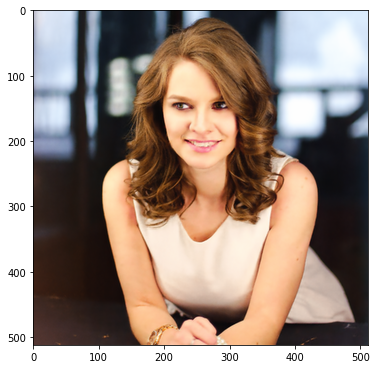

In [10]:
i = 0
def closure():
    
    global i
    
    if param_noise:
        for n in [x for x in net.parameters() if len(x.size()) == 4]:
            n = n + n.detach().clone().normal_() * n.std() / 50
    
    net_input = net_input_saved
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
        
        
    out = net(net_input)
   
    total_loss = mse(out * mask_var, img_var * mask_var)
    total_loss.backward()
        
    print ('Iteration %05d    Loss %f' % (i, total_loss.item()), sep='\r', end='')
    if  PLOT and i % show_every == 0:
        out_np = torch_to_np(out)
        plot_image_grid([np.clip(out_np, 0, 1)], factor=figsize, nrow=1)
        
    i += 1

    return total_loss

net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()

p = get_params(OPT_OVER, net, net_input)
optimize(OPTIMIZER, p, closure, LR, num_iter)

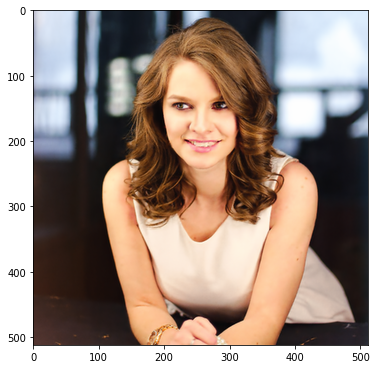

In [11]:
out_np = torch_to_np(net(net_input))
plot_image_grid([out_np], factor=5);